# **Étude de faisabilité - Classification automatique des biens de consommation**
*Sofia Chevrolat (Août 2020)*
___
Cette étude vise à étudier la faisabilité d'un moteur de classification des articles en différentes catégories, basé sur une image et une description, et avec un niveau de précision suffisant,  pour l'automatisation de l'attribution de la catégorie des articles.
___
_**Remerciements**:<br>
Merci à mon compagnon [J. Duplan](https://www.linkedin.com/in/julian-duplan-64844a41/) pour les discussions intéressantes.<br>
Merci également à mon mentor [Samia Drappeau](https://www.linkedin.com/in/samiadrappeau) pour les échanges d'idées, les conseils et les encouragements!_
___


Ce notebook est organisé comme suit:

**1. Mise en place**
- 1.1 Chargement des librairies et fonctions utiles
- 1.2 Chargement et description du jeu de données
    * 1.2.1 Description du jeux de données
    * 1.2.2 Visualisation du taux de remplissage des features
- 1.3 Ciblage des données
- 1.4 Décompactage des spécifications et catégories produit
- 1.5 Concaténation des features produit (hors catégories)
- 1.6 Description du jeu de données final

**2. Pré-traitement**
- 2.1 Données texte
    * 2.1.1 Suppression des caractères spéciaux et des espaces inutiles
    * 2.1.2 Passage en minuscules
    * 2.1.3 Tokenization
    * 2.1.4 Suppression des stopwords
    * 2.1.5 Lemmatization
- 2.2 Données image 
    * 2.2.1 Correction de l'exposition : étirement d'histogramme
        * 2.2.1.1 Visualisations avant correction
        * 2.2.1.2 Étirement d'histogramme
        * 2.2.1.3 Visualisations après correction
    * 2.2.2 Correction du contraste : égalisation d'histogramme
        * 2.2.2.1 Visualisations avant correction
        * 2.2.2.2 Égalisation d'histogramme
        * 2.2.2.3 Visualisations après correction
    * 2.2.3 Correction du bruit : filtrage 
        * 2.2.3.1 Filtrage gaussien
        * 2.2.3.2 Filtrage médian
    * 2.2.4 Comparaison avant-après corrections
        
**3. Analyse exploratoire**
- 3.1 Distribution des catégories et sous-catégories
    * 3.1.1 Distribution des catégories
    * 3.1.2 Distribution des sous-catégories au sein des catégories
- 3.2 Distribution des mots
- 3.3 Fréquence des mots
    * 3.3.1 Par catégorie dans les noms produits (<i>product_name</i>)
    * 3.3.2 Par catégorie dans les descriptions produits (<i>descriptions</i>)
    * 3.3.3 Par catégorie dans les spécifications produits (<i>product_specifications</i>)
    * 3.3.4 Toutes features texte produit confondues (<i>all_words</i>)
    
**4. Étude de faisabilité**
- 4.1 À partir des données image
    * 4.1.1 Obtention des points-clés et descripteurs
    * 4.1.2 Création du dictionnaire de mots visuels
        * 4.1.2.1 Clustering
        * 4.1.2.2 Affichage de quelques mots visuels
    * 4.1.3 Création des BOVW pour toutes les images
        * 4.1.3.1 Calcul des BOVW
        * 4.1.3.2 Affichage de quelques BOVW/catégorie
    * 4.1.4 Tests de prédiction
        * 4.1.4.1 Sur le jeu de données
        * 4.1.4.2 Sur un produit hors du jeu de données
    * 4.1.5 Conclusion
- 4.2 À partir des données texte
    * 4.2.1 Obtention des features 
        * 4.2.1.1 Transformation en matrice BOW
        * 4.2.1.2 Transformation en matrice TF-IDF
    * 4.2.2 Réduction dimensionnelle
        * 4.2.2.1 ACP
        * 4.2.2.2 t-SNE
        * 4.2.2.3 Comparaison
    * 4.2.3 Clustering
        * 4.2.3.1 Création du modèle
        * 4.2.3.2 Exploitation du modèle
    * 4.2.4 Tests de prédiction
        * 4.2.4.1 Sur le jeu de données
        * 4.2.4.2 Sur un produit hors du jeu de données
    * 4.2.5 Conclusion

**5. Conclusion**

**6. Annexes**

___
### 1. MISE EN PLACE

Dans cette première étape, le cadre de travail est mis en place, c'est-à-dire :
- Les librairies et packages Python nécessaires sont chargés
- Les fonctions utiles sont définies
- Le jeu de données est chargé

___
#### 1.1 CHARGEMENT DES LIBRAIRIES ET FONCTIONS UTILES

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import math
import pandas as pd
import numpy as np
import re
from unidecode import unidecode
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import time
import random
import operator
import scipy.cluster.hierarchy as shc
import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer

In [3]:
from sklearn import (preprocessing,
                     manifold,
                     decomposition)
from sklearn.cluster import AgglomerativeClustering, KMeans, DBSCAN
from sklearn.neighbors import KNeighborsClassifier
from sklearn import metrics
from sklearn.metrics import pairwise_distances_argmin_min
from sklearn.metrics import silhouette_score
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import GridSearchCV
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.decomposition import NMF

In [4]:
from PIL import Image, ImageOps, ImageFilter
import cv2 as cv

In [5]:
from sys import path
path.append("./Resources/functions")

import helper_functions as hf
import graphical_functions as gf

In [6]:
# Only to be run the first time

#nltk.download('stopwords')
#nltk.download('wordnet')

___
#### 1.2 CHARGEMENT ET DESCRIPTION DU JEU DE DONNÉES

In [7]:
products = pd.read_csv("./Resources/dataset/flipkart_com-ecommerce_sample_1050.csv", sep=",")

___
##### <u>1.2.1 Description du jeu de données</u>

In [8]:
hf.describe_dataset({'sample e-commerce':[products, "Clients"]})

Les données se décomposent en 1 fichier(s): 



,Nom du fichier,Nb de lignes,Nb de colonnes,Description
1,sample e-commerce,1050,15,Clients


In [9]:
products.head()

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",..."
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52 +0000,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52 +0000,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa..."


Les colonnes suivantes comprennent plusieurs types d'informations : 
- product_category_tree : les différentes catégories et sous-catégories du produit
- product_specifications : des informations variées sur le produit (marque, couleur...)

___
##### <u>1.2.2 Visualisation du taux de remplissage des features</u>

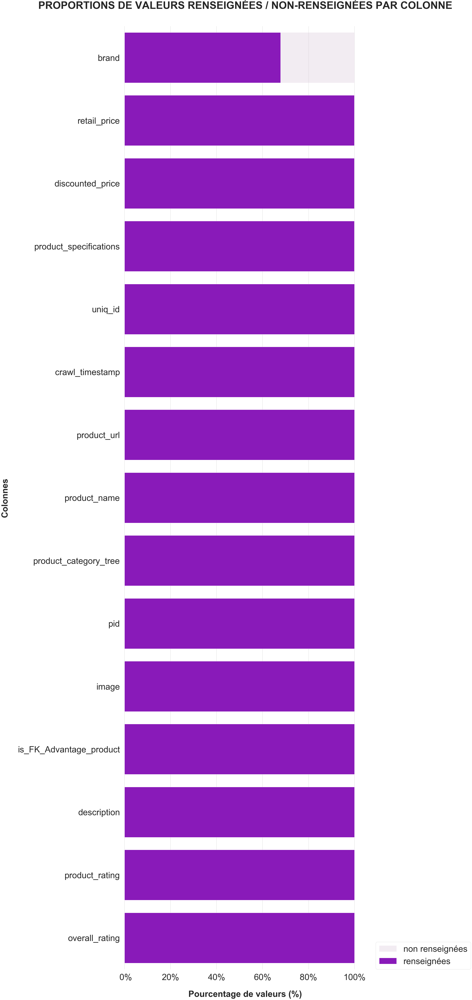

In [10]:
# Visualising filling rates for each column

gf.plot_percentage_missing_values_for(products, 25, 100)

L'écrasante majorité des features sont très bien renseignées (taux de remplissage > 90%), exceptée la colonne "brand". 

___
#### 1.3 CIBLAGE DES DONNÉES

Le but de l'analyse étant de valider la possibilité d'effectuer une classification automatique des produits à partir des descriptions et des images fournies, nous ne nous intéresserons qu'aux features pertinentes en ce sens, à savoir :
- <i>product_name</i>
- <i>uniq_id</i>
- <i>description</i>
- <i>product_specifications</i>
- <i>product_category_tree</i>
- <i>image</i>

Nous supprimons donc les autres features.

In [11]:
products = products.drop(columns=["crawl_timestamp", 
                                  "discounted_price", 
                                  "is_FK_Advantage_product", 
                                  "overall_rating", 
                                  "pid", 
                                  "product_rating", 
                                  "product_url", 
                                  "retail_price"])

Pour les besoins de l'analyse, nous n'allons conserver que les produits dont les caractéristiques et le classement en catégories sont renseignés.

In [12]:
# Keeping only products that have specifications 
# and categories assigned to them

products = products[products["product_specifications"].notna()\
                    &\
                    products["product_category_tree"].notna()]

- La feature <i>image</i> semblent être composée de la feature <i>uniq_id</i> à laquelle on a rajouté ".jpg".
Confirmons cela :

In [13]:
if len(products[products["image"].str.endswith(".jpg")]) == len(products):
    print("All pictures are named according to the 'uniq_id+jpg' convention.")
else:
    print("Some images are not named according to the 'uniq_id+jpg' convention")

All pictures are named according to the 'uniq_id+jpg' convention.


>On peut donc supprimer la colonne "uniq_id" et conserver uniquement la colonne "image".

In [14]:
products = products.drop(columns="uniq_id").reset_index(drop=True)

- Nous avons constaté que l'information de marque se retrouvait dans "product_specification" avec la clé "Brand". 

Voyons s'il est possible de compléter la colonne "brand" de valeurs présentes dans "product_specifications" lorsque "brand" contient NaN.

In [15]:
non_branded_products = products[products["brand"].isna()].copy()

In [16]:
non_branded_products["contains_brand"] = non_branded_products["product_specifications"]\
                                        .apply(lambda x: True if '"key"=>"Brand"' in x else False)

In [17]:
non_branded_products[non_branded_products["contains_brand"]==True]

,product_name,product_category_tree,image,description,brand,product_specifications,contains_brand


Les observations dont la marque n'est pas renseignée dans "brand" n'ont pas non plus cette information dans "product_specifications". 
Voyons si l'inverse est vrai.

In [18]:
branded_products = products[~products["brand"].isna()].copy()

In [19]:
branded_products["contains_brand"] = branded_products["product_specifications"]\
                                     .apply(lambda x: True if '"key"=>"Brand"' in str(x) else False)

In [20]:
branded_products[branded_products["contains_brand"]==False]

,product_name,product_category_tree,image,description,brand,product_specifications,contains_brand
40,Mom and Kid Baby Girl's Printed Green Top & Py...,"[""Baby Care >> Infant Wear >> Baby Girls' Clot...",90e56526f4c5892beac49f262b85150a.jpg,Key Features of Mom and Kid Baby Girl's Printe...,Mom and Kid,"{""product_specification""=>[{""key""=>""Pattern"", ...",False
42,"Mom and Kid Baby Girl's Printed Blue, Grey Top...","[""Baby Care >> Infant Wear >> Baby Girls' Clot...",5325213d84c80ad310b6e4b37a1ac824.jpg,Key Features of Mom and Kid Baby Girl's Printe...,Mom and Kid,"{""product_specification""=>[{""key""=>""Pattern"", ...",False
44,AKUP i-loves-music Ceramic Mug,"[""Kitchen & Dining >> Coffee Mugs >> AKUP Coff...",8050d31bffe6827c804b8222338aafb2.jpg,Key Features of AKUP i-loves-music Ceramic Mug...,AKUP,"{""product_specification""=>[{""key""=>""Type"", ""va...",False
45,AKUP i-love-my-mom Ceramic Mug,"[""Kitchen & Dining >> Coffee Mugs >> AKUP Coff...",493d1eb6ad7a48a926092bf994cd0bb0.jpg,Key Features of AKUP i-love-my-mom Ceramic Mug...,AKUP,"{""product_specification""=>[{""key""=>""Type"", ""va...",False
46,AKUP keep-calm Ceramic Mug,"[""Kitchen & Dining >> Coffee Mugs >> AKUP Coff...",3388d05e88972ff9f3e1321dc0cfdc28.jpg,Key Features of AKUP keep-calm Ceramic Mug Pac...,AKUP,"{""product_specification""=>[{""key""=>""Type"", ""va...",False
...,...,...,...,...,...,...,...
1010,SJ Tulip multi use cotton Balls,"[""Baby Care >> Baby Grooming >> Cotton Buds >>...",11f06dffebf7edf9e15351834a190c2c.jpg,Specifications of SJ Tulip multi use cotton Ba...,SJ,"{""product_specification""=>[{""key""=>""Number of ...",False
1012,"LAWMAN PG3 Striker,, Winger , Contender Deodor...","[""Beauty and Personal Care >> Fragrances >> De...",b48218a94e220c20373ed50dc4254093.jpg,"Key Features of LAWMAN PG3 Striker,, Winger , ...",LAWMAN PG3,"{""product_specification""=>[{""key""=>""Fragrance ...",False
1013,Toons Printed Baby Boy's Round Neck T-Shirt,"[""Baby Care >> Infant Wear >> Baby Boys' Cloth...",721d6fc10f52e76007c3c0405cf967c5.jpg,Key Features of Toons Printed Baby Boy's Round...,Toons,"{""product_specification""=>[{""key""=>""Sleeve"", ""...",False
1015,Good Way Peppermint Lip Balm Pepper,"[""Beauty and Personal Care >> Body and Skin Ca...",747b170919791d6111847d3485b5b77b.jpg,Good Way Peppermint Lip Balm Pepper (8 g) Pric...,Good Way,"{""product_specification""=>[{""key""=>""Flavor"", ""...",False


La marque est renseignée uniquement dans "Brand" pour 145 produits. Nous allons donc, pour ces 146 lignes, ajouter les données de marque aux données spécifications.

In [21]:
specs_contain_brand = (products["product_specifications"].str.contains('"key"=>"Brand"'))

products.loc[specs_contain_brand, 'brand']=','
products.loc[~specs_contain_brand, 'brand']=', {"key"=>"Brand", "value"=>"'\
                                            + \
                                            products.loc[~specs_contain_brand, 'brand']+'"}'

In [22]:
products["product_specifications"] = products["product_specifications"] + products["brand"]

In [23]:
products["product_specifications"] = products["product_specifications"].apply(lambda x: str(x))

In [24]:
products = products.drop(columns="brand")

On obtient ainsi le jeu de données suivant :

In [25]:
hf.describe_dataset({'sample e-commerce':[products, "Produits"]})

Les données se décomposent en 1 fichier(s): 



,Nom du fichier,Nb de lignes,Nb de colonnes,Description
1,sample e-commerce,1049,5,Produits


In [26]:
products.head()

,product_name,product_category_tree,image,description,product_specifications
0,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,"{""product_specification""=>[{""key""=>""Machine Wa..."
2,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",64d5d4a258243731dc7bbb1eef49ad74.jpg,Key Features of Eurospa Cotton Terry Face Towe...,"{""product_specification""=>[{""key""=>""Material"",..."
3,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",d4684dcdc759dd9cdf41504698d737d8.jpg,Key Features of SANTOSH ROYAL FASHION Cotton P...,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
4,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",6325b6870c54cd47be6ebfbffa620ec7.jpg,Key Features of Jaipur Print Cotton Floral Kin...,"{""product_specification""=>[{""key""=>""Machine Wa..."


___
#### 1.4 DÉCOMPACTAGE DES SPÉCIFICATIONS ET CATÉGORIES PRODUIT

Les features _product_specifications_ et _product_category_tree_ contiennent des données texte dans des formats concaténés. 

Nous allons les transformer en features séparées pour faciliter leur exploitation par le modèle. 

Nous testons d'abord que les fonctions de décompactage fonctionnent correctement.

In [27]:
hf.unit_tests()

'All ok'

In [28]:
# Modifying the specification columns to contain a list of values

products["product_specifications"] = hf.get_value_list(products["product_specifications"])

La feature "product_category_tree" est bien renseignée jusqu'aux 2 premiers chevrons, soit la catégorie principale et la 1ère sous-catégorie.
La 2ème sous-catégorie contient parfois des informations inappropriées comme des mesures, ou bien est simplement la concaténation de la marque et de la 1ère sous-catégorie.
Nous allons donc récupérer uniquement la catégorie principale et la 1ère sous-catégorie.

In [29]:
products = pd.concat([products, 
                      hf.get_categories(products["product_category_tree"])], 
                     axis=1).drop(columns=["product_category_tree"])

___
#### 1.5 CONCATÉNATION DES FEATURES PRODUIT (HORS CATÉGORIE)

Pour plus de facilité pour les traitements suivants, nous allons créer une feature qui va constituer le "document" associé au produit, en rassemblant l'ensemble des features texte d'un produit (hors categorie).

In [30]:
products["all_words"] = products["product_name"] \
                        + products["description"] \
                        + products["product_specifications"]

___
#### 1.6 DESCRIPTION DU JEU DE DONNÉES FINAL

Le jeu de données final obtenu est le suivant :

In [31]:
hf.describe_dataset({'Full dataset':[products, "Full dataset"]})

Les données se décomposent en 1 fichier(s): 



,Nom du fichier,Nb de lignes,Nb de colonnes,Description
1,Full dataset,1049,7,Full dataset


In [32]:
products.head()

,product_name,image,description,product_specifications,category,subcategory,all_words
0,Elegance Polyester Multicolor Abstract Eyelet ...,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,"['Elegance', 'Door', 'Eyelet', 'Abstract Polye...","[""Home Furnishing",Curtains & Accessories,Elegance Polyester Multicolor Abstract Eyelet ...
1,Sathiyas Cotton Bath Towel,7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,"['Yes', 'Cotton', 'Self Design', 'Sathiyas', '...","[""Baby Care",Baby Bath & Skin,Sathiyas Cotton Bath TowelSpecifications of Sa...
2,Eurospa Cotton Terry Face Towel Set,64d5d4a258243731dc7bbb1eef49ad74.jpg,Key Features of Eurospa Cotton Terry Face Towe...,"['Cotton Terry', 'SHUVAM', 'Eurospa', '360', '...","[""Baby Care",Baby Bath & Skin,Eurospa Cotton Terry Face Towel SetKey Feature...
3,SANTOSH ROYAL FASHION Cotton Printed King size...,d4684dcdc759dd9cdf41504698d737d8.jpg,Key Features of SANTOSH ROYAL FASHION Cotton P...,"['SANTOSH ROYAL FASHION', 'Yes', 'Flat', 'Cott...","[""Home Furnishing",Bed Linen,SANTOSH ROYAL FASHION Cotton Printed King size...
4,Jaipur Print Cotton Floral King sized Double B...,6325b6870c54cd47be6ebfbffa620ec7.jpg,Key Features of Jaipur Print Cotton Floral Kin...,"['Yes', 'Jaipur Print', 'Flat', 'jaipur117', '...","[""Home Furnishing",Bed Linen,Jaipur Print Cotton Floral King sized Double B...


___
### 2. PRÉ-TRAITEMENT

Nous allons maintenant préparer les données pour les rendre exploitable pour une analyse.

In [33]:
PRODUCT_COLS = ["description", 
                "product_name", 
                "product_specifications"]

CAT_COLS = ["category", 
            "subcategory"]

___
#### 2.1 DONNÉES TEXTE

On prend 2 valeurs témoins afin de contrôler l'efficacité des traitements, une de chaque type de données :
- les features produits
- les features catégorie

In [34]:
old_description = products.head(1)["description"][0]
old_category = products.head(1)["category"][0]

In [35]:
old_description

'Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant curtain that softly filters light in your room so that you

In [36]:
old_category

'["Home Furnishing '

##### _<u>2.1.1 Suppression des caractères spéciaux et des espaces inutiles</u>_

In [37]:
# Replacing fully blank values with NaN

products = products.replace(r'^\s+$', np.nan, regex=True)

In [38]:
# Deleting linebreaks and special characters

products = products.replace(r'\n','', regex=True)
products = products.replace(r'\r','', regex=True)
products = products.replace(r'\t','', regex=True)
products = products.replace(r'\[', '', regex=True)
products = products.replace(r'\]', '', regex=True)
products = products.replace(r'\{','', regex=True)
products = products.replace(r'\}','', regex=True)
products = products.replace(r'"','', regex=True)
products = products.replace(r'\/',' ', regex=True)
products = products.replace(r'\\','', regex=True)

In [39]:
# Removing leading and trailing whitespaces

for col in CAT_COLS:
    products[col] = products[col].str.rstrip()
    products[col] = products[col].str.lstrip()

**Vérification des modifications sur les textes témoins :**

In [40]:
old_category

'["Home Furnishing '

In [41]:
new_category = products.head(1)["category"][0]

In [42]:
new_category

'Home Furnishing'

✅ Les caractères spéciaux ont bien été retirés des catégories.

In [43]:
old_category = new_category

##### _<u>2.1.2 Passage en minuscules</u>_

In [44]:
# Setting all words to lowercase

for col in PRODUCT_COLS:
    products[col] = products[col].str.lower()
    products[col] = products[col].str.rstrip()
    products[col] = products[col].str.lstrip()

**Vérification des modifications sur les textes témoins :**

In [45]:
old_description

'Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant curtain that softly filters light in your room so that you

In [46]:
new_description = products.head(1)["description"][0]

In [47]:
new_description

'key features of elegance polyester multicolor abstract eyelet door curtain floral curtain,elegance polyester multicolor abstract eyelet door curtain (213 cm in height, pack of 2) price: rs. 899 this curtain enhances the look of the interiors.this curtain is made from 100% high quality polyester fabric.it features an eyelet style stitch with metal ring.it makes the room environment romantic and loving.this curtain is ant- wrinkle and anti shrinkage and have elegant apparance.give your home a bright and modernistic appeal with these designs. the surreal attention is sure to steal hearts. these contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. bring home the elegant curtain that softly filters light in your room so that you

✅ Tout le texte est bien en minuscules.

In [48]:
old_description = new_description

##### _<u>2.1.3 Tokenization</u>_

In [49]:
tokenizer = nltk.RegexpTokenizer(r'[a-zA-Z]+')

for col in PRODUCT_COLS:
    products[col] = products[col].apply(lambda x: tokenizer.tokenize(x))

**Vérification des modifications sur les textes témoins :**

In [50]:
old_description

'key features of elegance polyester multicolor abstract eyelet door curtain floral curtain,elegance polyester multicolor abstract eyelet door curtain (213 cm in height, pack of 2) price: rs. 899 this curtain enhances the look of the interiors.this curtain is made from 100% high quality polyester fabric.it features an eyelet style stitch with metal ring.it makes the room environment romantic and loving.this curtain is ant- wrinkle and anti shrinkage and have elegant apparance.give your home a bright and modernistic appeal with these designs. the surreal attention is sure to steal hearts. these contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. bring home the elegant curtain that softly filters light in your room so that you

In [51]:
new_description = products.head(1)["description"][0]

In [52]:
new_description

['key',
 'features',
 'of',
 'elegance',
 'polyester',
 'multicolor',
 'abstract',
 'eyelet',
 'door',
 'curtain',
 'floral',
 'curtain',
 'elegance',
 'polyester',
 'multicolor',
 'abstract',
 'eyelet',
 'door',
 'curtain',
 'cm',
 'in',
 'height',
 'pack',
 'of',
 'price',
 'rs',
 'this',
 'curtain',
 'enhances',
 'the',
 'look',
 'of',
 'the',
 'interiors',
 'this',
 'curtain',
 'is',
 'made',
 'from',
 'high',
 'quality',
 'polyester',
 'fabric',
 'it',
 'features',
 'an',
 'eyelet',
 'style',
 'stitch',
 'with',
 'metal',
 'ring',
 'it',
 'makes',
 'the',
 'room',
 'environment',
 'romantic',
 'and',
 'loving',
 'this',
 'curtain',
 'is',
 'ant',
 'wrinkle',
 'and',
 'anti',
 'shrinkage',
 'and',
 'have',
 'elegant',
 'apparance',
 'give',
 'your',
 'home',
 'a',
 'bright',
 'and',
 'modernistic',
 'appeal',
 'with',
 'these',
 'designs',
 'the',
 'surreal',
 'attention',
 'is',
 'sure',
 'to',
 'steal',
 'hearts',
 'these',
 'contemporary',
 'eyelet',
 'and',
 'valance',
 'curtai

✅ Le texte a bien été converti en une liste des mots qu'il contenait.

In [53]:
old_description = new_description

##### _<u>2.1.4 Suppression des stop words</u>_

In [54]:
for col in PRODUCT_COLS:
    products[col] = products[col].apply(lambda x: [word \
                                                   for word \
                                                   in x \
                                                   if word \
                                                   not in stopwords.words('english')])

**Vérification des modifications sur les textes témoins :**

In [55]:
old_description

['key',
 'features',
 'of',
 'elegance',
 'polyester',
 'multicolor',
 'abstract',
 'eyelet',
 'door',
 'curtain',
 'floral',
 'curtain',
 'elegance',
 'polyester',
 'multicolor',
 'abstract',
 'eyelet',
 'door',
 'curtain',
 'cm',
 'in',
 'height',
 'pack',
 'of',
 'price',
 'rs',
 'this',
 'curtain',
 'enhances',
 'the',
 'look',
 'of',
 'the',
 'interiors',
 'this',
 'curtain',
 'is',
 'made',
 'from',
 'high',
 'quality',
 'polyester',
 'fabric',
 'it',
 'features',
 'an',
 'eyelet',
 'style',
 'stitch',
 'with',
 'metal',
 'ring',
 'it',
 'makes',
 'the',
 'room',
 'environment',
 'romantic',
 'and',
 'loving',
 'this',
 'curtain',
 'is',
 'ant',
 'wrinkle',
 'and',
 'anti',
 'shrinkage',
 'and',
 'have',
 'elegant',
 'apparance',
 'give',
 'your',
 'home',
 'a',
 'bright',
 'and',
 'modernistic',
 'appeal',
 'with',
 'these',
 'designs',
 'the',
 'surreal',
 'attention',
 'is',
 'sure',
 'to',
 'steal',
 'hearts',
 'these',
 'contemporary',
 'eyelet',
 'and',
 'valance',
 'curtai

In [56]:
new_description = products.head(1)["description"][0]

In [57]:
new_description

['key',
 'features',
 'elegance',
 'polyester',
 'multicolor',
 'abstract',
 'eyelet',
 'door',
 'curtain',
 'floral',
 'curtain',
 'elegance',
 'polyester',
 'multicolor',
 'abstract',
 'eyelet',
 'door',
 'curtain',
 'cm',
 'height',
 'pack',
 'price',
 'rs',
 'curtain',
 'enhances',
 'look',
 'interiors',
 'curtain',
 'made',
 'high',
 'quality',
 'polyester',
 'fabric',
 'features',
 'eyelet',
 'style',
 'stitch',
 'metal',
 'ring',
 'makes',
 'room',
 'environment',
 'romantic',
 'loving',
 'curtain',
 'ant',
 'wrinkle',
 'anti',
 'shrinkage',
 'elegant',
 'apparance',
 'give',
 'home',
 'bright',
 'modernistic',
 'appeal',
 'designs',
 'surreal',
 'attention',
 'sure',
 'steal',
 'hearts',
 'contemporary',
 'eyelet',
 'valance',
 'curtains',
 'slide',
 'smoothly',
 'draw',
 'apart',
 'first',
 'thing',
 'morning',
 'welcome',
 'bright',
 'sun',
 'rays',
 'want',
 'wish',
 'good',
 'morning',
 'whole',
 'world',
 'draw',
 'close',
 'evening',
 'create',
 'special',
 'moments',
 'j

✅ Les stopwords ont bien été retirés de la liste des tokens.

In [58]:
old_description = new_description

##### _<u>2.1.5 Lemmatization</u>_

Le processus de « lemmatisation » consiste à représenter les mots (ou « lemmes ») sous leur forme canonique, afin de ne conserver que le sens des mots utilisés dans le corpus.

In [59]:
for col in PRODUCT_COLS:
    products[col] = products[col].apply(lambda x: hf.lemmatized_list(x))

**Vérification des modifications sur les textes témoins :**

In [60]:
old_description

['key',
 'features',
 'elegance',
 'polyester',
 'multicolor',
 'abstract',
 'eyelet',
 'door',
 'curtain',
 'floral',
 'curtain',
 'elegance',
 'polyester',
 'multicolor',
 'abstract',
 'eyelet',
 'door',
 'curtain',
 'cm',
 'height',
 'pack',
 'price',
 'rs',
 'curtain',
 'enhances',
 'look',
 'interiors',
 'curtain',
 'made',
 'high',
 'quality',
 'polyester',
 'fabric',
 'features',
 'eyelet',
 'style',
 'stitch',
 'metal',
 'ring',
 'makes',
 'room',
 'environment',
 'romantic',
 'loving',
 'curtain',
 'ant',
 'wrinkle',
 'anti',
 'shrinkage',
 'elegant',
 'apparance',
 'give',
 'home',
 'bright',
 'modernistic',
 'appeal',
 'designs',
 'surreal',
 'attention',
 'sure',
 'steal',
 'hearts',
 'contemporary',
 'eyelet',
 'valance',
 'curtains',
 'slide',
 'smoothly',
 'draw',
 'apart',
 'first',
 'thing',
 'morning',
 'welcome',
 'bright',
 'sun',
 'rays',
 'want',
 'wish',
 'good',
 'morning',
 'whole',
 'world',
 'draw',
 'close',
 'evening',
 'create',
 'special',
 'moments',
 'j

In [61]:
new_description = products.head(1)["description"][0]

In [62]:
new_description

['key',
 'feature',
 'elegance',
 'polyester',
 'multicolor',
 'abstract',
 'eyelet',
 'door',
 'curtain',
 'floral',
 'curtain',
 'elegance',
 'polyester',
 'multicolor',
 'abstract',
 'eyelet',
 'door',
 'curtain',
 'cm',
 'height',
 'pack',
 'price',
 'r',
 'curtain',
 'enhances',
 'look',
 'interior',
 'curtain',
 'made',
 'high',
 'quality',
 'polyester',
 'fabric',
 'feature',
 'eyelet',
 'style',
 'stitch',
 'metal',
 'ring',
 'make',
 'room',
 'environment',
 'romantic',
 'loving',
 'curtain',
 'ant',
 'wrinkle',
 'anti',
 'shrinkage',
 'elegant',
 'apparance',
 'give',
 'home',
 'bright',
 'modernistic',
 'appeal',
 'design',
 'surreal',
 'attention',
 'sure',
 'steal',
 'heart',
 'contemporary',
 'eyelet',
 'valance',
 'curtain',
 'slide',
 'smoothly',
 'draw',
 'apart',
 'first',
 'thing',
 'morning',
 'welcome',
 'bright',
 'sun',
 'ray',
 'want',
 'wish',
 'good',
 'morning',
 'whole',
 'world',
 'draw',
 'close',
 'evening',
 'create',
 'special',
 'moment',
 'joyous',
 '

✅ Tous les tokens ont été lemmatisés.

___
#### 2.2 DONNÉES IMAGE

In [63]:
PATH = "./Resources/pictures/"

Afin de qualifier les photos, une fonction a été écrite qui retourne : 
- un coefficient d'exposition : compris entre -100 et 100, une valeur de 0 dénote un équilibre parfait entre les pixels sombres et les pixels clairs. Une valeur négative indique un déséquilibre en faveur des pixels sombres, une valeur positive en faveur des pixels clairs.
- un coefficient de contraste : il s'agit du coefficient de variation de la distribution des pixels de l'histogramme de l'image. Plus il est faible, plus le contraste est bon.

Nous allons calculer ces coefficients pour l'ensemble des images du jeu de données

In [64]:
img_quality = hf.get_img_quality_coeffs(products["image"], PATH)

/Users/sofia/opt/anaconda3/lib/python3.7/site-packages/PIL/Image.py:2766: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning,


In [65]:
products = pd.concat([products, img_quality], axis=1)

In [66]:
len(img_quality[(img_quality["exposition_coeff"]>25) \
                | \
                (img_quality["exposition_coeff"]<-25)])/len(img_quality)*100

76.3584366062917

On constate que plus de 3/4 des images présentent une déséquilibre en termes d'exposition supérieur à 25%.

##### _<u>2.2.1 Correction de l'exposition : étirement d'histogramme</u>_

###### 2.2.1.1 Visualisations avant correction

_<u>Histogramme de l'image la plus sous-exposée</u>_

In [67]:
min_exposition_balance = products.loc[products[['exposition_coeff']]\
                                      .idxmin()]\
                                 .iloc[0]["image"]

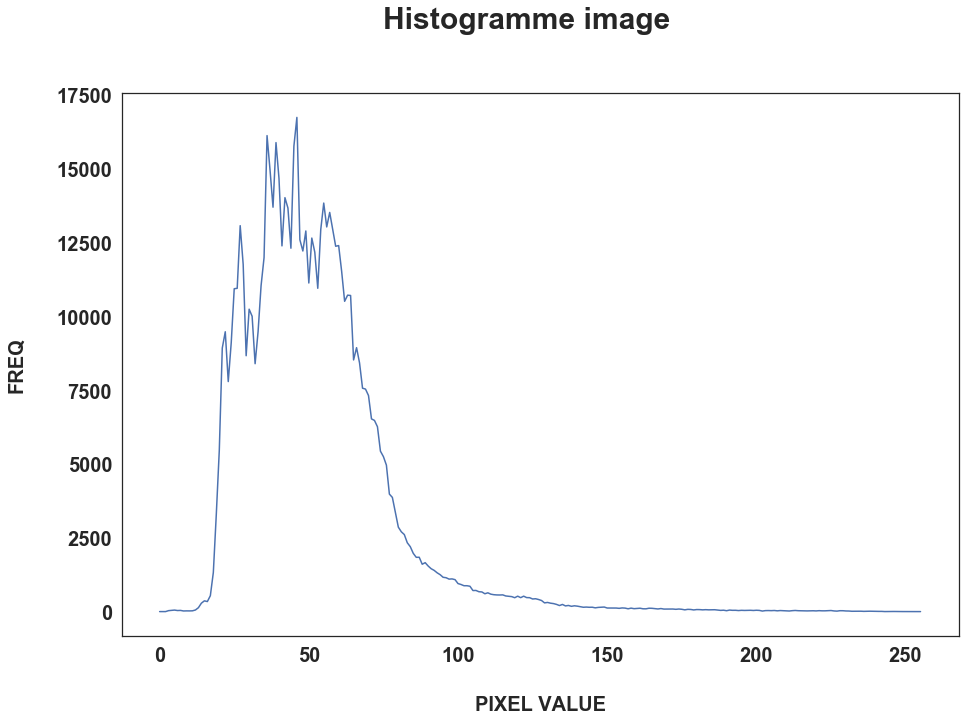

In [68]:
gf.plot_pix_histogram(PATH+min_exposition_balance, is_img_name=True)

In [69]:
print("The exposition coefficient for this picture is", 
      products.loc[products[['exposition_coeff']].idxmin()]\
                            .iloc[0]["exposition_coeff"])

The exposition coefficient for this picture is -97.28624450146629


Les pixels de cette image sont presqu'à 100% concentrés du côté des pixels sombres.

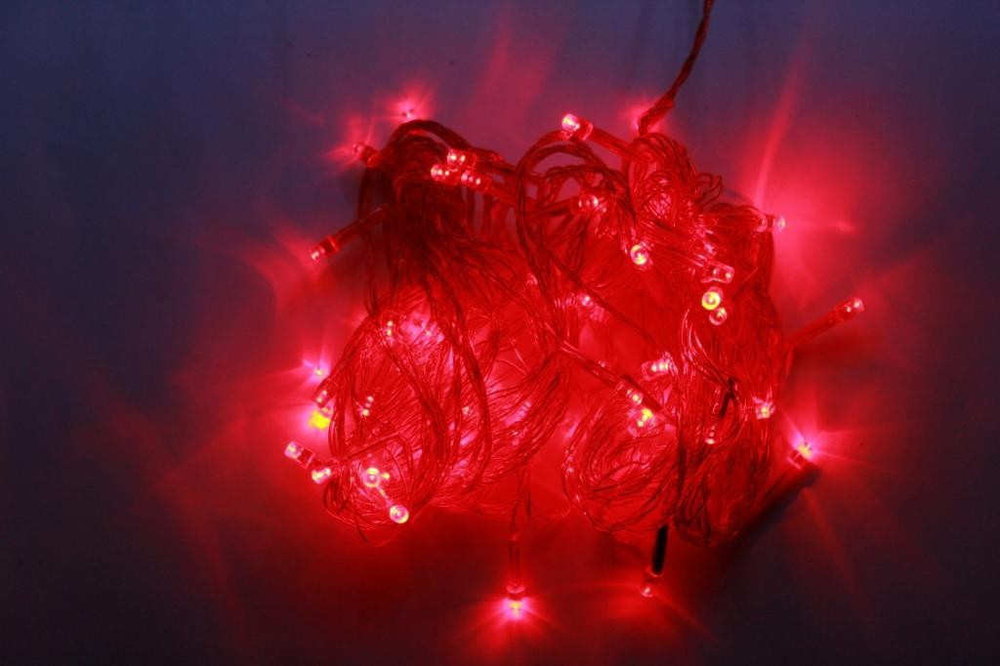

In [70]:
Image.open(PATH+min_exposition_balance)

_<u>Histogramme de l'image la plus surexposée</u>_

In [71]:
max_exposition_balance = products.loc[products[['exposition_coeff']]\
                                      .idxmax()]\
                                 .iloc[0]["image"]

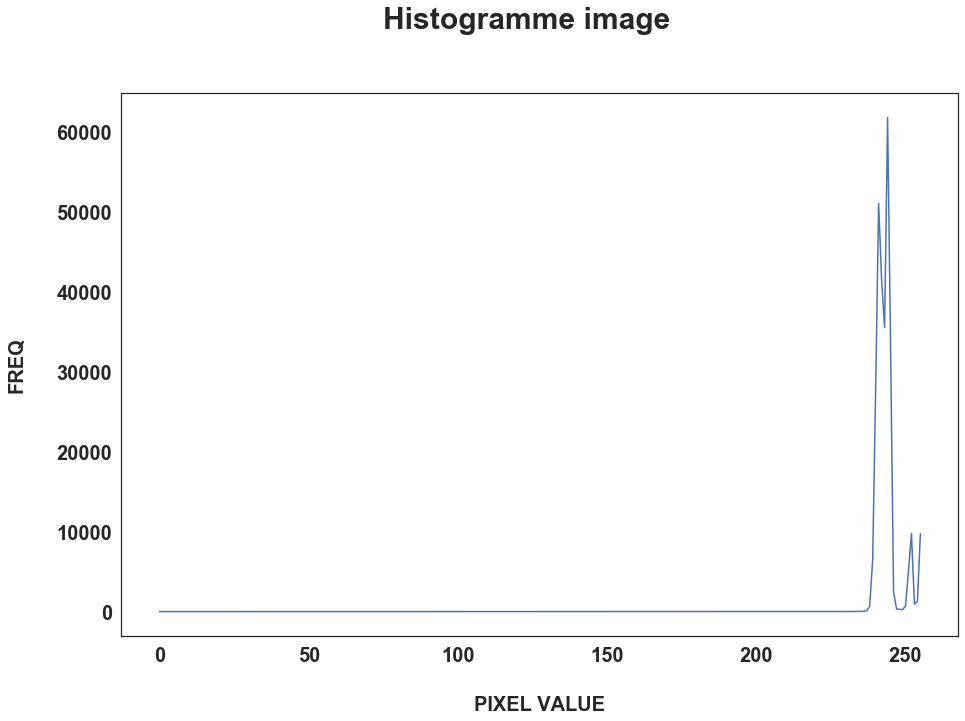

In [72]:
gf.plot_pix_histogram(PATH+max_exposition_balance, is_img_name=True)

In [73]:
print("The exposition coefficient for this picture is", 
      products.loc[products[['exposition_coeff']].idxmax()]\
                   .iloc[0]["exposition_coeff"])

The exposition coefficient for this picture is 100.0


Les pixels de cette image sont presqu'à 100% concentrés du côté des pixels clairs.

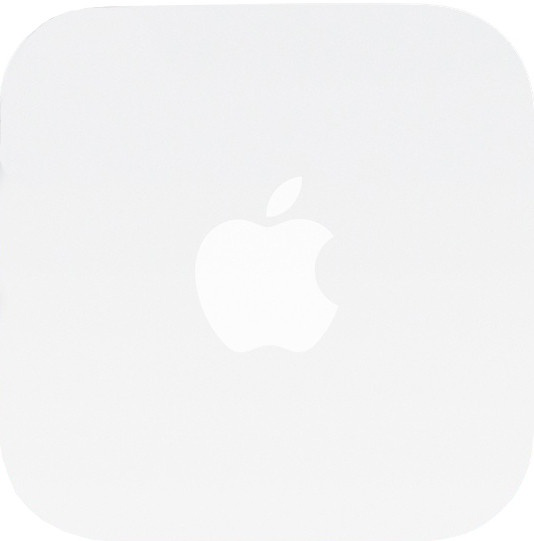

In [74]:
Image.open(PATH+max_exposition_balance)

###### 2.2.1.2 Étirement d'histogramme

In [75]:
optimized_imgs = pd.DataFrame(columns=["exp_corr_img"])

for img in products["image"]:
    optimized_imgs.loc[len(optimized_imgs)] = [ImageOps\
                                               .autocontrast(Image.open(PATH+img), 
                                                             1)]

/Users/sofia/opt/anaconda3/lib/python3.7/site-packages/PIL/Image.py:2766: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning,


In [76]:
products = pd.concat([products, optimized_imgs], axis=1)

Les coefficients de qualité d'image sont recalculés pour comparaison une fois le traitement appliqué :

In [77]:
img_quality = hf.get_img_quality_coeffs(products["exp_corr_img"])\
                .rename(columns={"exposition_coeff":"exp_corr_exposition_coeff",
                                 "variation_coeff":"exp_corr_variation_coeff"})

In [78]:
products = pd.concat([products, img_quality], axis=1)

- Pourcentage de photos présentant une exposition plus équilibrée après le traitement :

In [79]:
len(products[products["exp_corr_exposition_coeff"]<products["exposition_coeff"]])\
/\
len(products)*100

92.56434699714013

- Pourcentage de photos présentant toujours en déséquilibre supérieur à 25% :

In [80]:
len(img_quality[(img_quality["exp_corr_exposition_coeff"]>25) \
                | \
                (img_quality["exp_corr_exposition_coeff"]<-25)])/len(img_quality)*100

71.02001906577694

Plus de 92% des photos ont une exposition plus équilibrée après traitement, avec 71% de photos présentant toujours un déséquilibre > 25%, soit une amélioration de 5% du nombre de photos.

###### 2.2.1.3 Visualisations après corrections

_<u>Histogramme de l'image la plus sous-exposée après correction</u>_

In [81]:
min_exp_corr_img = products[products["image"] == min_exposition_balance]\
                           ["exp_corr_img"].iloc[0]

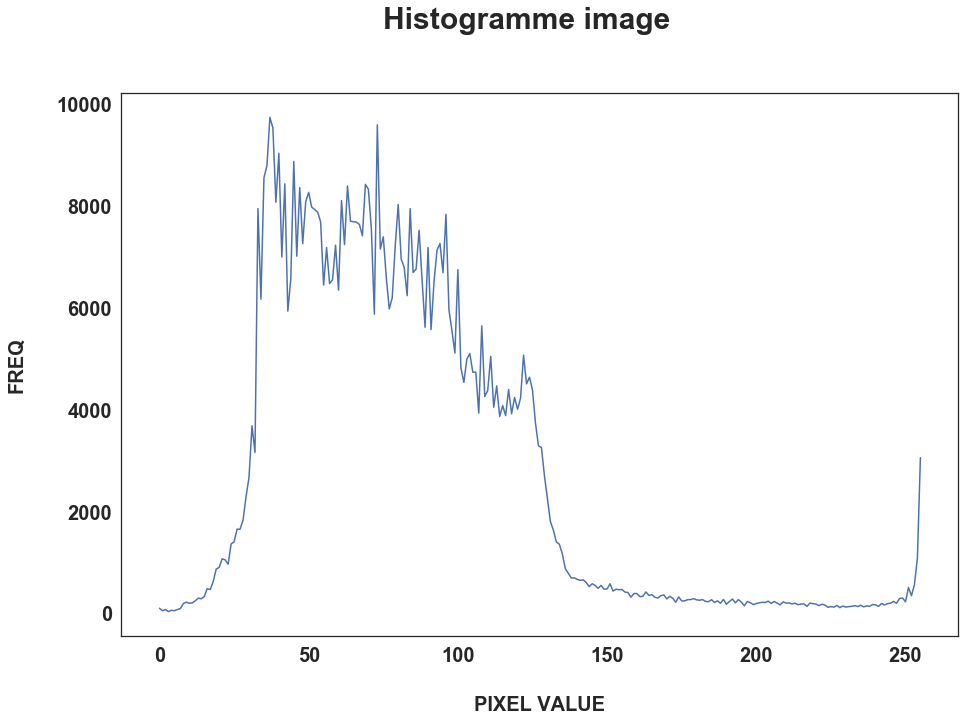

In [82]:
gf.plot_pix_histogram(min_exp_corr_img)

In [83]:
print("The exposition coefficient for this picture is", 
      products.loc[products[['exp_corr_exposition_coeff']].idxmin()]\
                   .iloc[0]["exp_corr_exposition_coeff"])

The exposition coefficient for this picture is -88.52630876068376


L'exposition de l'image est passée de -97.3% à -88.5%, soit une exposition 8.8% plus équilibrée après correction.

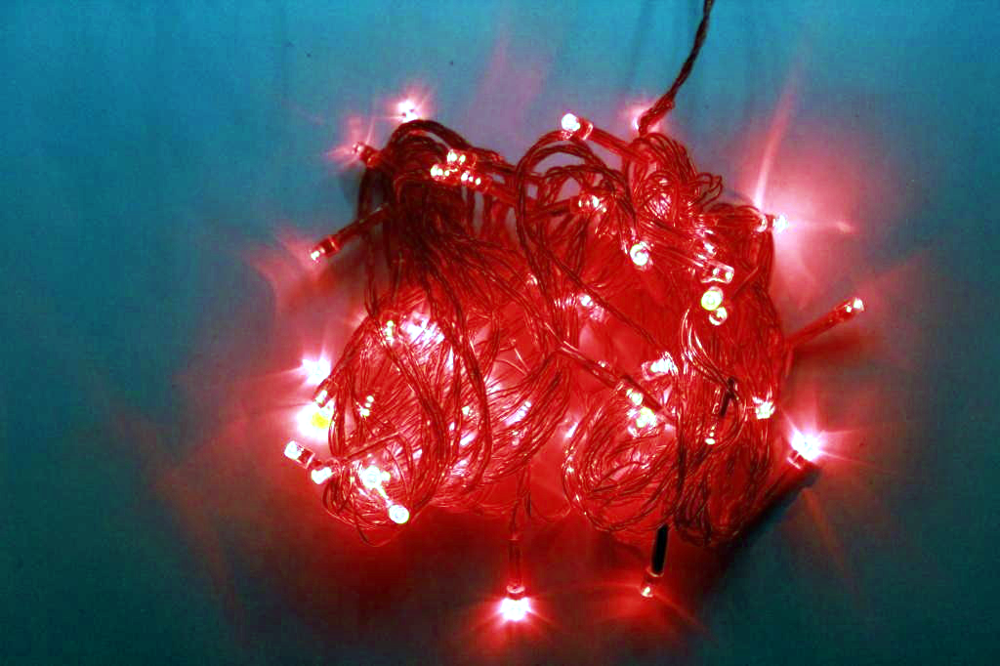

In [84]:
min_exp_corr_img

_<u>Histogramme de l'image la plus sur-exposée après correction</u>_

In [85]:
max_exp_corr_img = products[products["image"] == max_exposition_balance]\
                           ["exp_corr_img"].iloc[0]

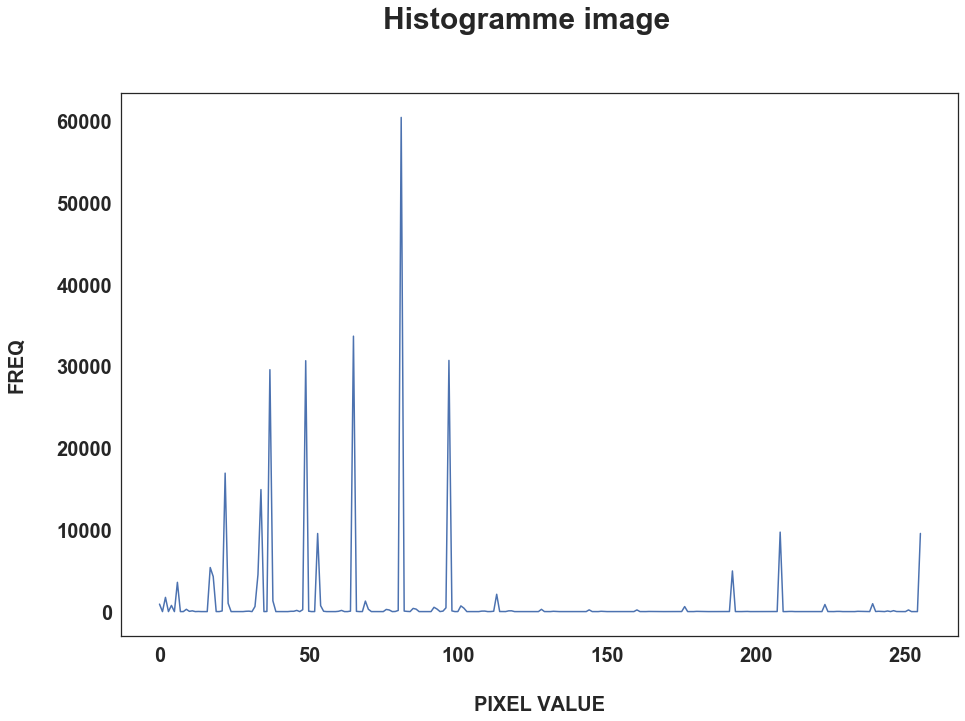

In [86]:
gf.plot_pix_histogram(max_exp_corr_img)

In [87]:
print("The exposition coefficient for this picture is", 
      products.loc[products[['exp_corr_exposition_coeff']].idxmax()]\
                            .iloc[0]["exp_corr_exposition_coeff"])

The exposition coefficient for this picture is 95.8741911813755


L'exposition de l'image est passée de 100% à 95.9%, soit une exposition 4.1 % plus équilibrée après correction.

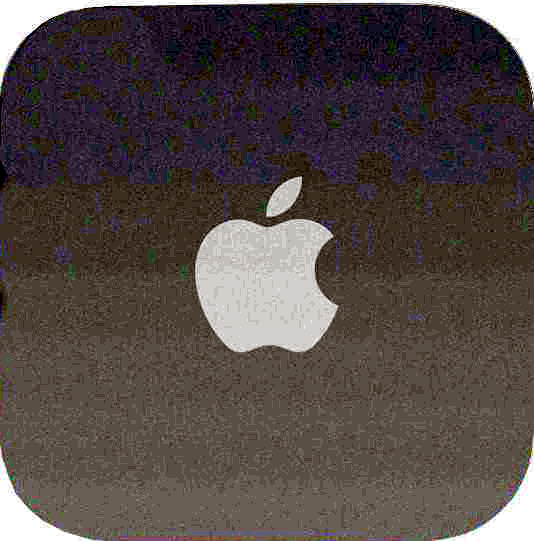

In [88]:
max_exp_corr_img

##### _<u>2.2.2 Correction du contraste : égalisation d'histogramme</u>_

###### 2.2.2.1 Visualisations avant correction

_<u>Histogramme de l'image la plus contrastée</u>_

In [89]:
min_variation = products.loc[products[['exp_corr_variation_coeff']]\
                                      .idxmin()]\
                                 .iloc[0]["image"]

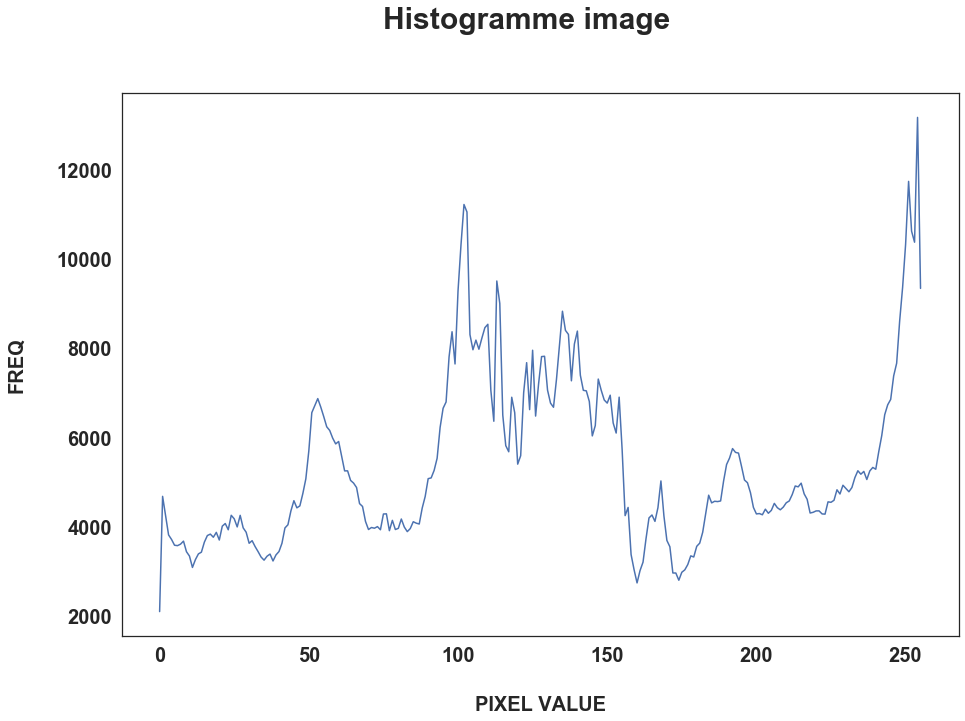

In [90]:
gf.plot_pix_histogram(PATH+min_variation, is_img_name=True)

In [91]:
print("The variation coeffficient for this picture is ", 
      products.loc[products[['exp_corr_variation_coeff']].idxmin()]\
                            .iloc[0]["exp_corr_variation_coeff"])

The variation coeffficient for this picture is  0.3465649946843369


Cette image présente un coefficient de variation très proche de 0.

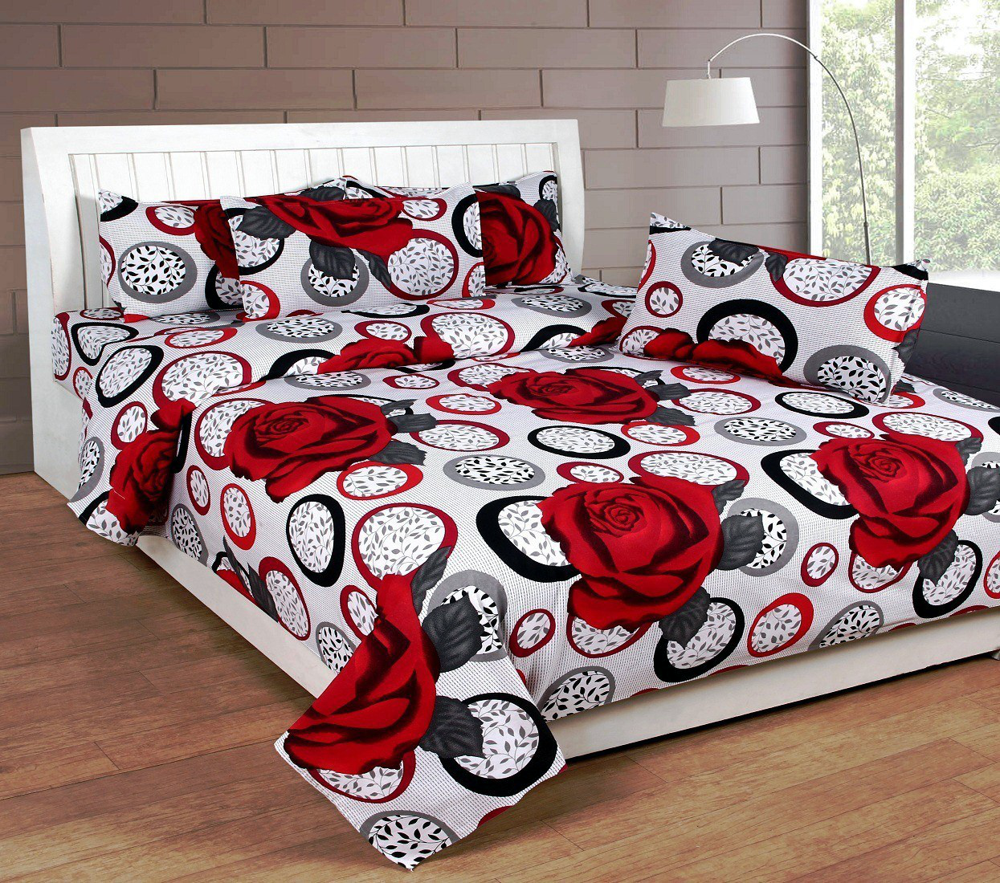

In [92]:
products[products["image"]==min_variation]["exp_corr_img"].iloc[0]

_<u>Histogramme de l'image la moins contrastée</u>_

In [93]:
max_variation = products.loc[products[['exp_corr_variation_coeff']]\
                                      .idxmax()]\
                                 .iloc[0]["image"]

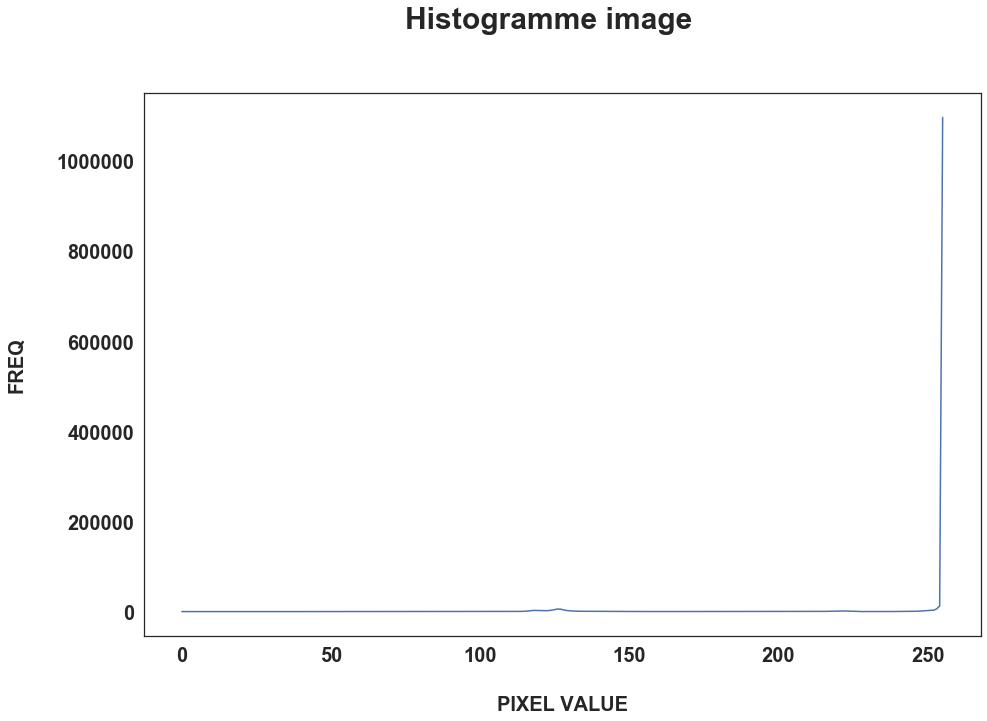

In [94]:
gf.plot_pix_histogram(PATH+max_variation, is_img_name=True)

In [95]:
print("The variation coeffficient for this picture is ", 
      products.loc[products[['exp_corr_variation_coeff']].idxmax()]\
                            .iloc[0]["exp_corr_variation_coeff"])

The variation coeffficient for this picture is  14.43944808566477


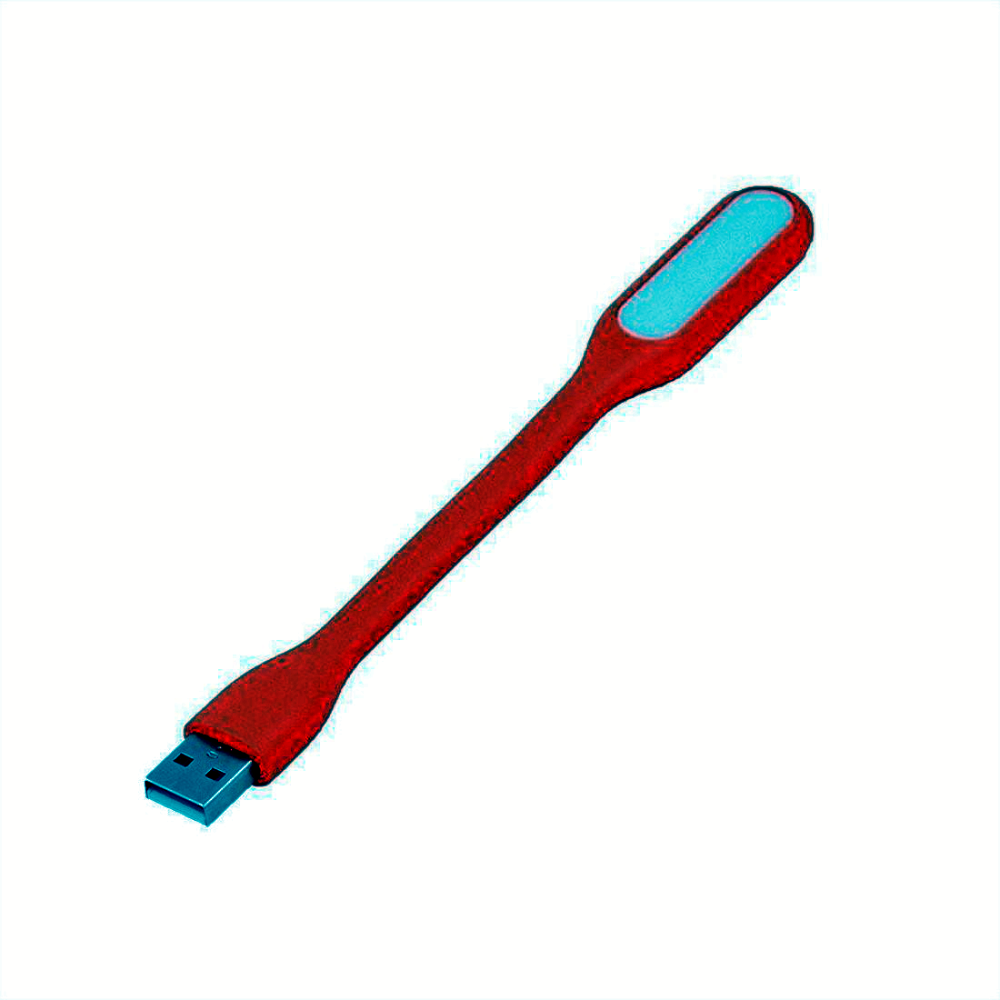

In [96]:
products[products["image"]==max_variation]["exp_corr_img"].iloc[0]

###### 2.2.2.2 Équalisation d'histogramme

In [97]:
optimized_imgs = pd.DataFrame(columns=["cont_corr_img"])

for img in products["exp_corr_img"]:
    cont_corr_img = ImageOps.equalize(img)
    optimized_imgs.loc[len(optimized_imgs)] = [cont_corr_img]

In [98]:
products = pd.concat([products, optimized_imgs], axis=1)\
             .rename(columns={"cont_corr_img":"corrected_img"})\
             .drop(columns=["exp_corr_img"])

Les coefficients de qualité d'image sont recalculés pour comparaison une fois le traitement appliqué :

In [99]:
img_quality = hf.get_img_quality_coeffs(products["corrected_img"])\
                .rename(columns={"exposition_coeff":"corr_exposition_coeff",
                                 "variation_coeff":"corr_variation_coeff"})

In [100]:
products = pd.concat([products, img_quality], axis=1)

- Pourcentage de photos présentant une exposition plus équilibrée après le traitement :

In [101]:
len(products[products["corr_exposition_coeff"]<products["exposition_coeff"]])\
/\
len(products)*100

60.53384175405148

60% des images après traitement (étirement et équalisation d'histogramme) ont une meilleure exposition que l'image originale.

- Pourcentage de photos présentant un contraste plus équilibré après le traitement :

In [102]:
len(products[products["corr_variation_coeff"]<products["variation_coeff"]])\
/\
len(products)*100

98.28408007626311

98% des images après traitement (étirement et équalisation d'histogramme) ont un meilleur contraste que l'image originale.

###### 2.2.2.3 Visualisations après corrections

_<u>Histogramme de l'image la plus contrastée après correction</u>_

In [103]:
min_variation_img = products[products["image"] == min_variation]\
                           ["corrected_img"].iloc[0]

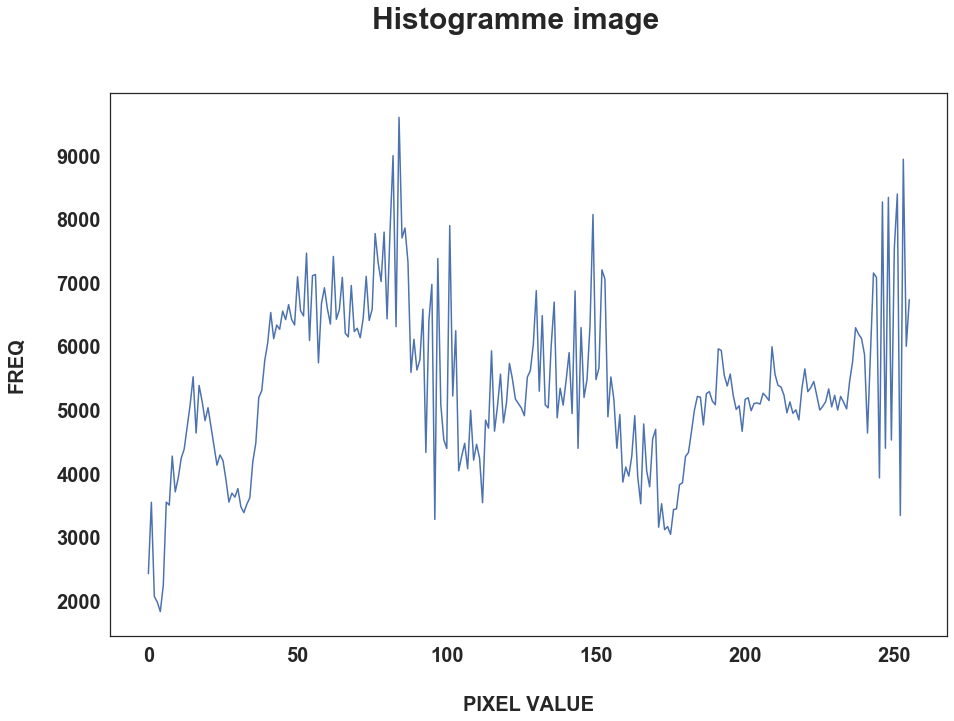

In [104]:
gf.plot_pix_histogram(min_variation_img)

In [105]:
print("The variation coefficient for this picture is", 
      products.loc[products[['corr_variation_coeff']].idxmin()]\
                            .iloc[0]["corr_variation_coeff"])

The variation coefficient for this picture is 0.14248248495924404


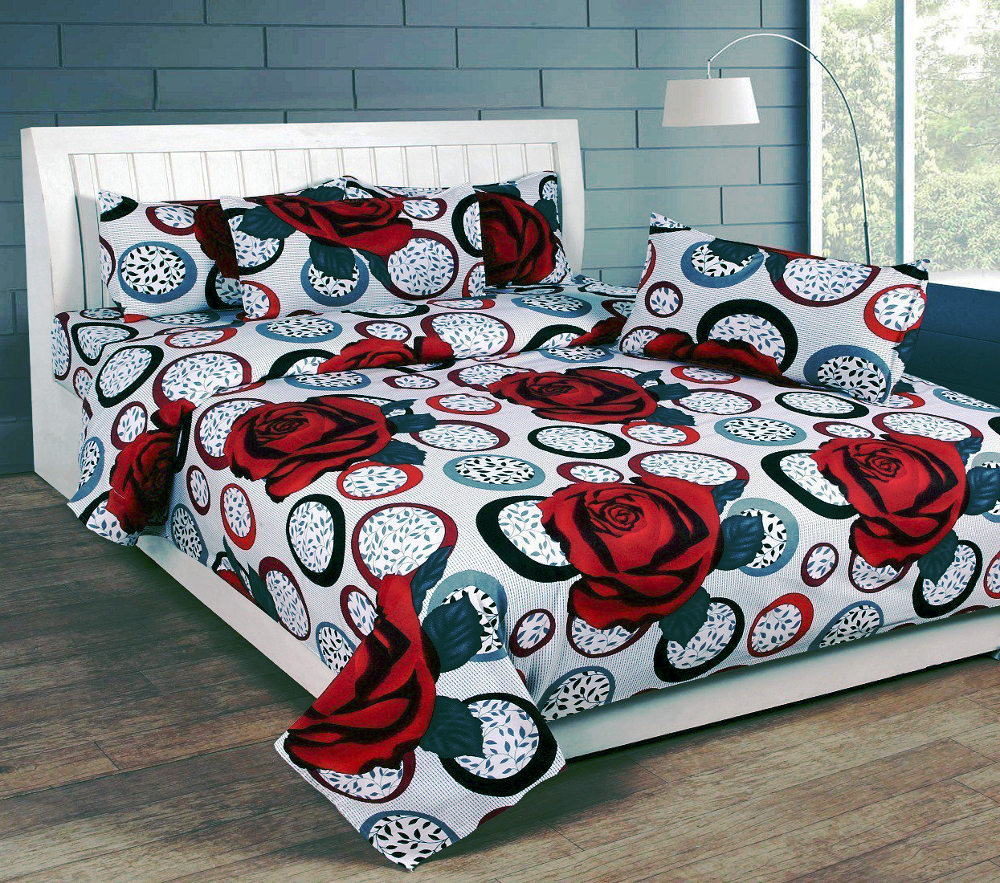

In [106]:
min_variation_img

_<u>Histogramme de l'image la moins contrastée après correction</u>_

In [107]:
max_variation_img = products[products["image"] == max_variation]\
                           ["corrected_img"].iloc[0]

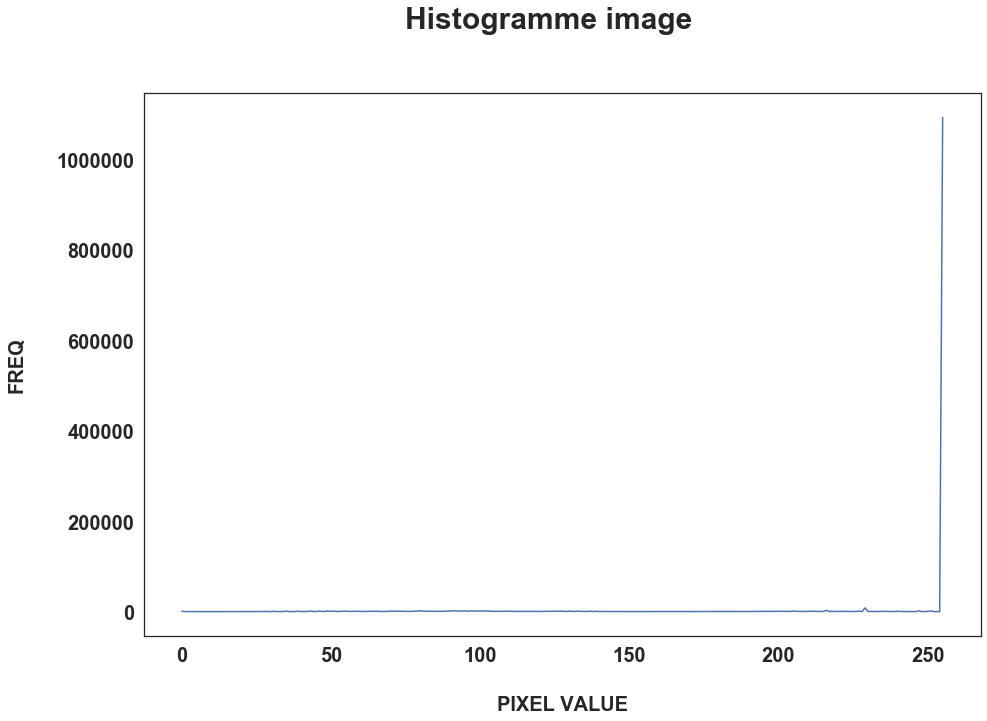

In [108]:
gf.plot_pix_histogram(max_variation_img)

In [109]:
print("The variation coefficient for this picture is", 
      products.loc[products[['corr_variation_coeff']].idxmax()]\
                            .iloc[0]["corr_variation_coeff"])

The variation coefficient for this picture is 14.41761140624591


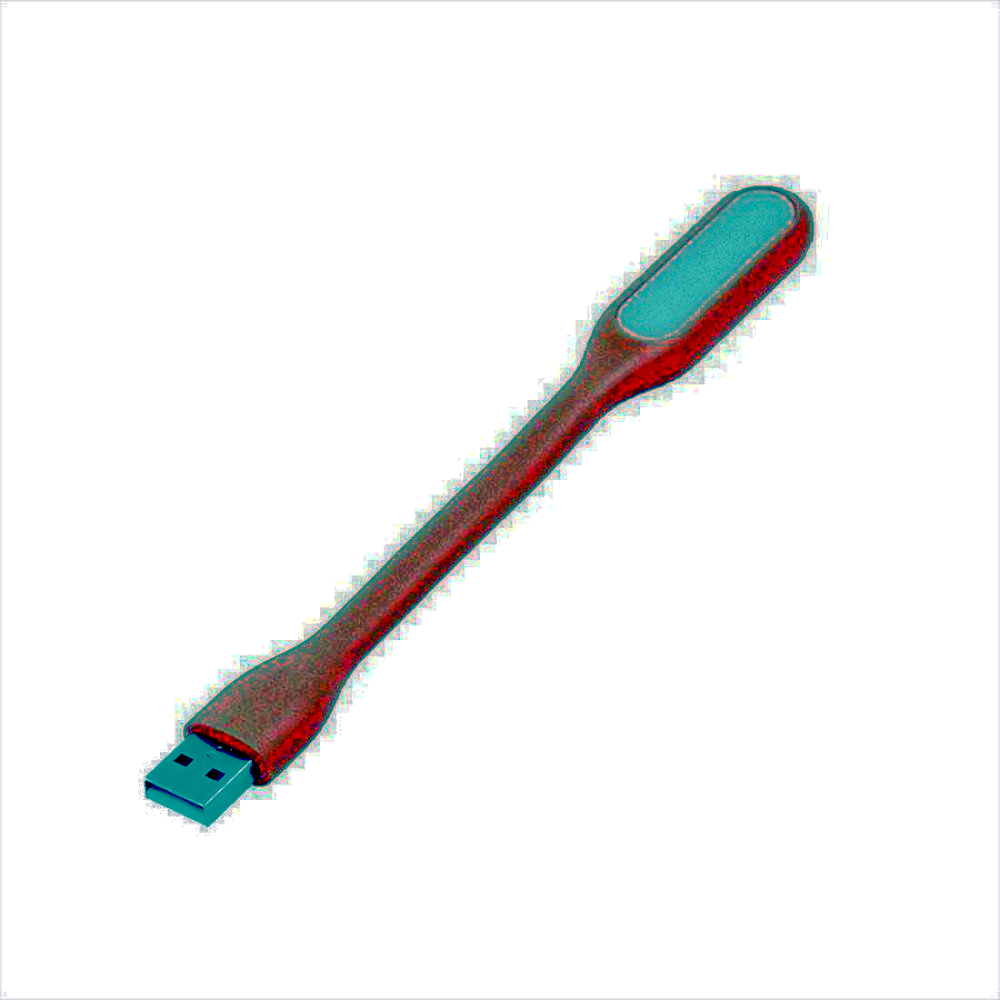

In [110]:
max_variation_img

##### _<u>2.2.3 Correction du bruit : filtrage</u>_

Les traitements précédents ont causé l'apparition d'un bruit qui se rapproche parfois du gaussien, parfois du "poivre et sel". 

Pour tenter d'améliorer la qualité de l'image, nous allons donc tenter 2 filtres différents :
- un filtre gaussien
- un filtre médian

###### 2.2.3.1 Filtrage gaussien

In [111]:
products["corr_gauss_img"] = products["corrected_img"]\
                             .apply(lambda x:x.filter(ImageFilter.GaussianBlur(radius=3)))

###### 2.2.3.2 Filtrage médian

In [112]:
products["corr_med_img"] = products["corrected_img"]\
                              .apply(lambda x:x.filter(ImageFilter.MedianFilter(size=7)))

##### _<u>2.2.4 Comparaison avant-après corrections</u>_

In [113]:
ind = random.randint(0, len(products))

In [114]:
original_img = products.iloc[ind]["image"]
corrected_img = products.iloc[ind]["corrected_img"]
corr_gauss_img = products.iloc[ind]["corr_gauss_img"]
corr_med_img = products.iloc[ind]["corr_med_img"]

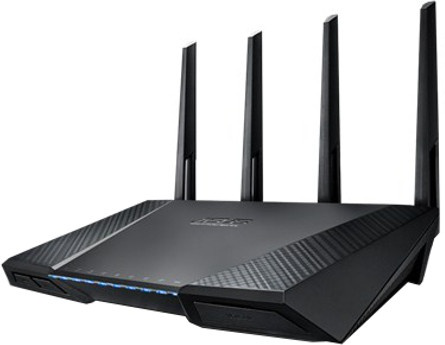

In [115]:
Image.open(PATH+original_img)

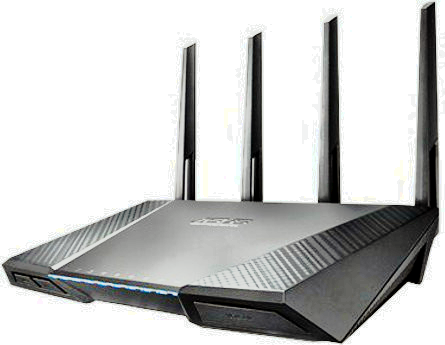

In [116]:
corrected_img

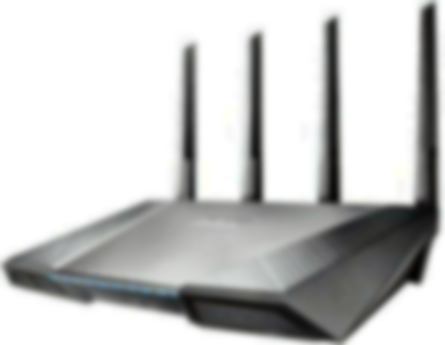

In [117]:
corr_gauss_img

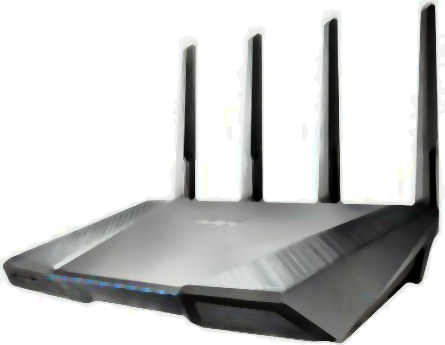

In [118]:
corr_med_img

L'égalisation et l'étirement d'histogramme ont permis d'équilibrer davantage l'exposition et le contraste des images. Toutefois, pour certaines images, ces traitements ont également causé l'apparition de bruit. L'application d'un filtre pour résoudre ce problème semble avoir amélioré certaines images mais causé un bruit supplémentaire pour d'autres.

___
### 3. ANALYSE EXPLORATOIRE

___
#### 3.1 DISTRIBUTION DES CATÉGORIES ET SOUS-CATÉGORIES

##### _<u>3.1.1 Distribution des catégories</u>_

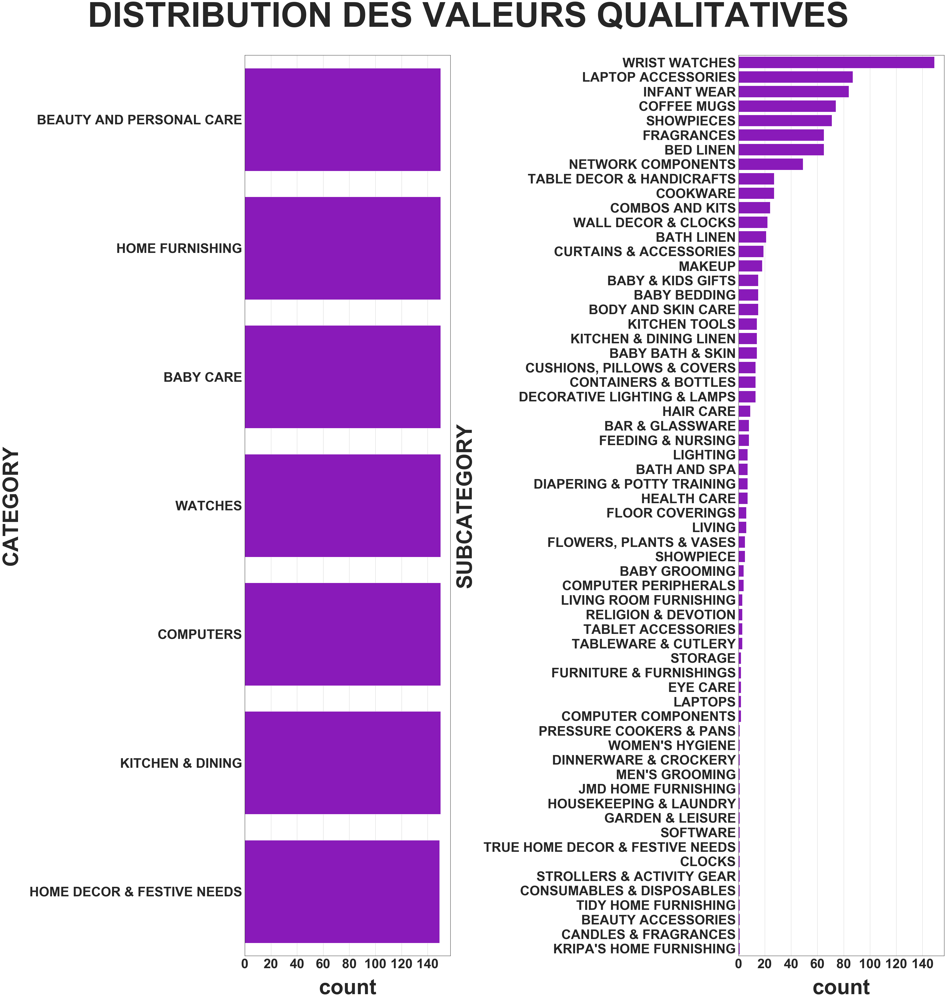

In [119]:
gf.plot_qualitative_dist(products[["category",
                                   "subcategory"]], 1, 2, 50, 50, "")

Les produits sont répartis de façon uniforme entre les différentes catégories principales, bien moins dans les sous-catégories.

##### _<u>3.1.2 Distribution des sous-catégories au sein des catégories</u>_

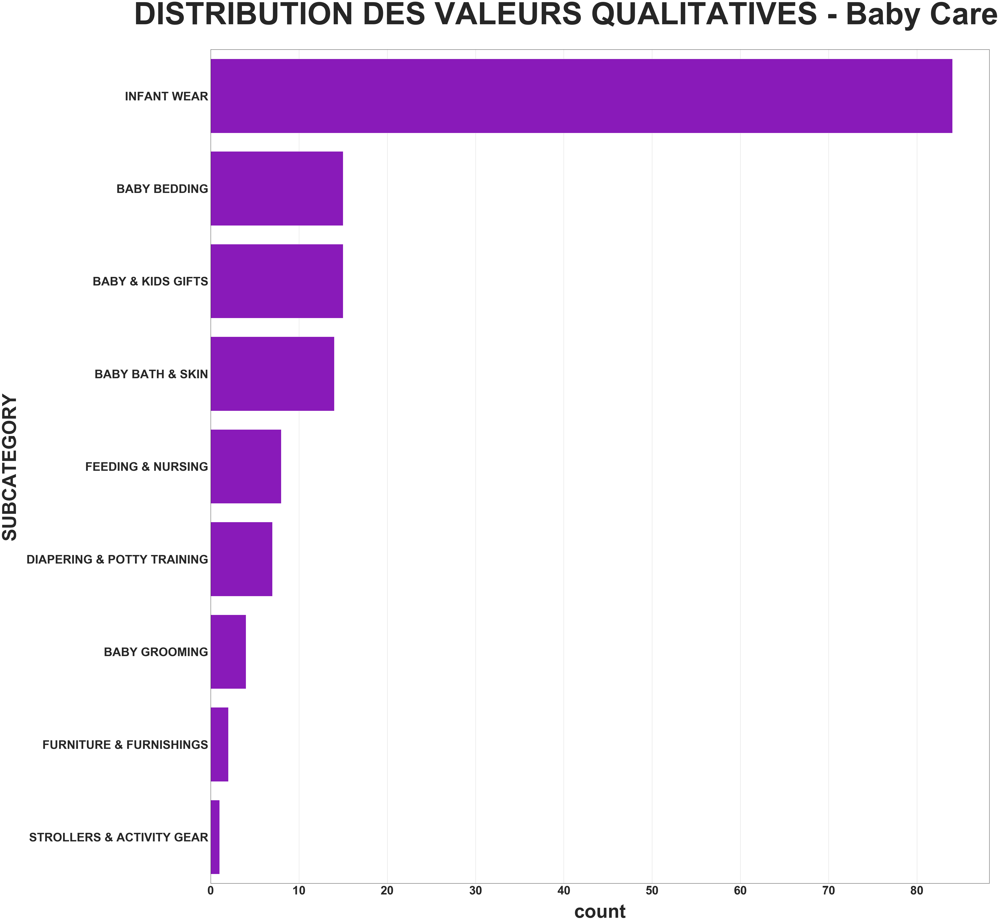

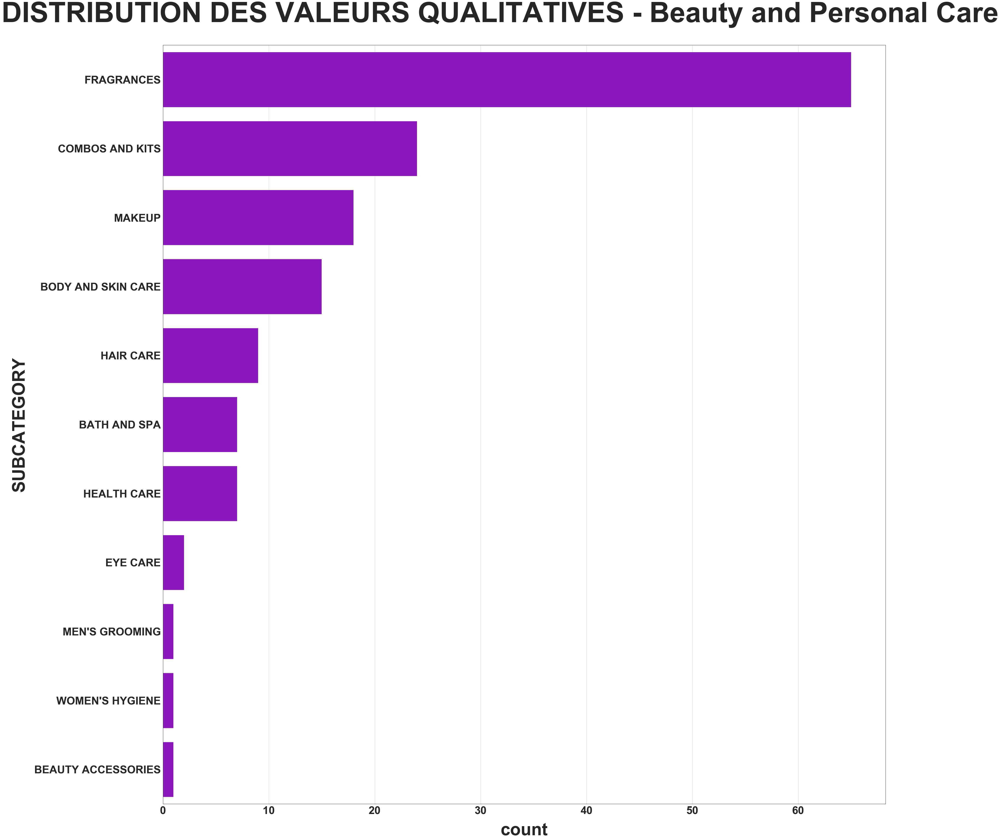

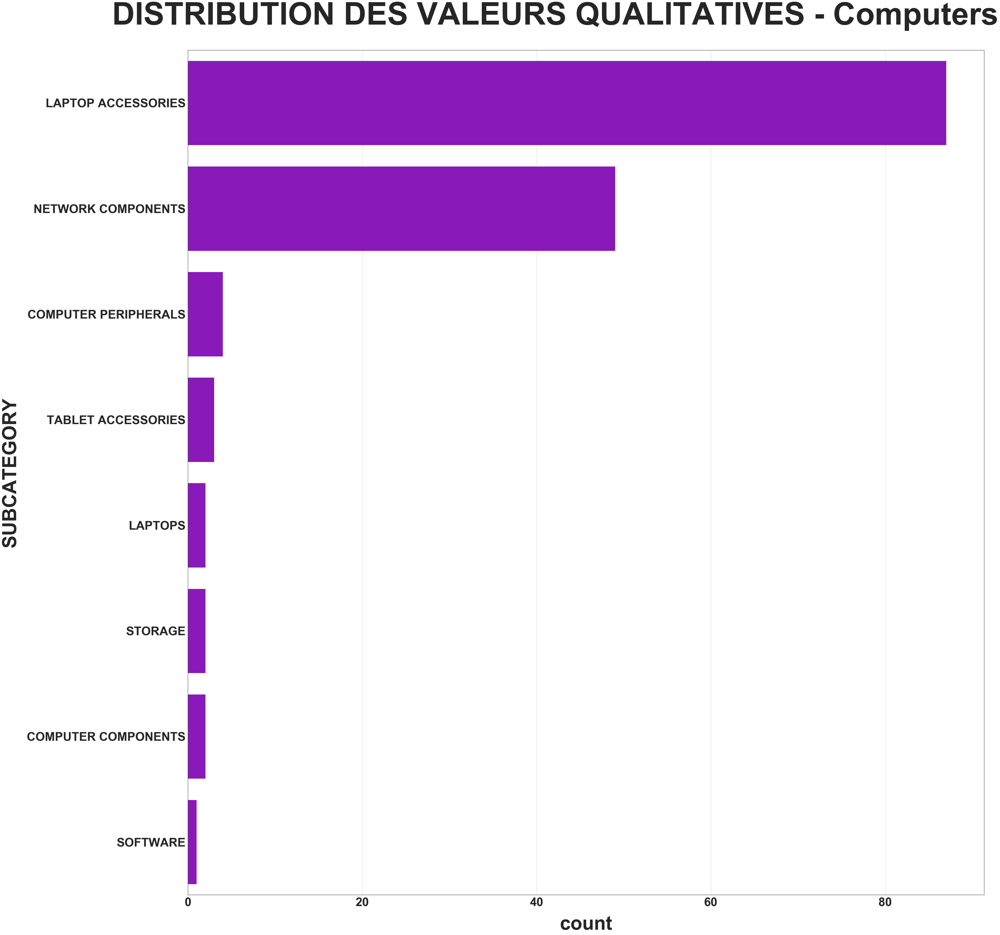

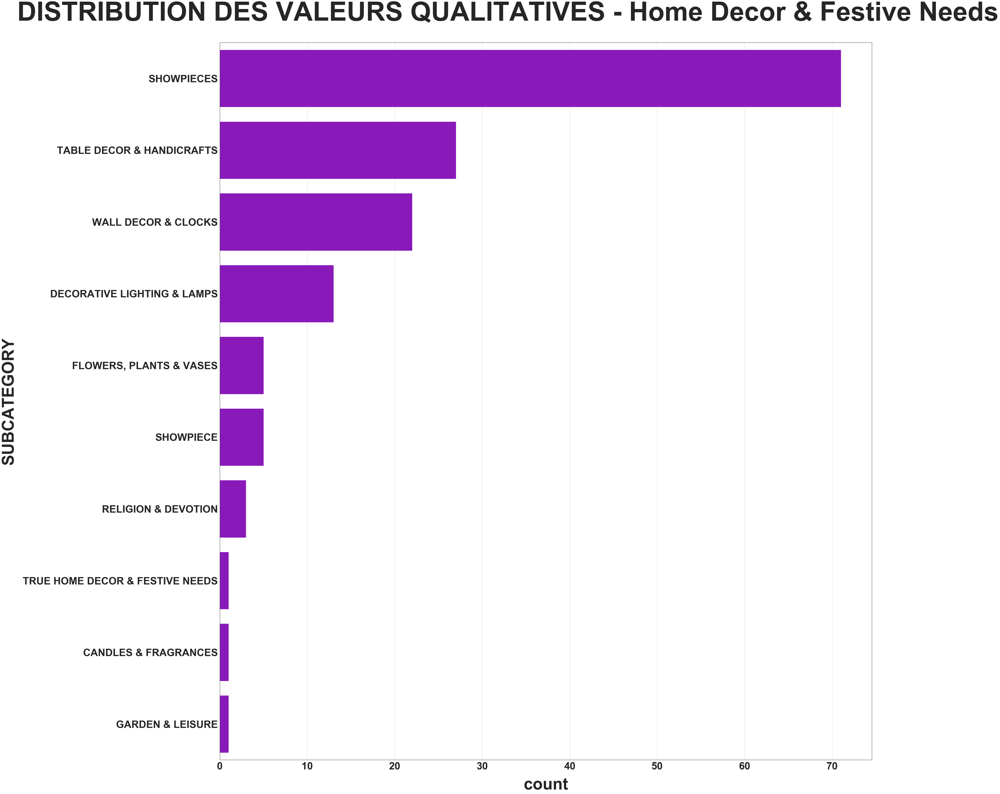

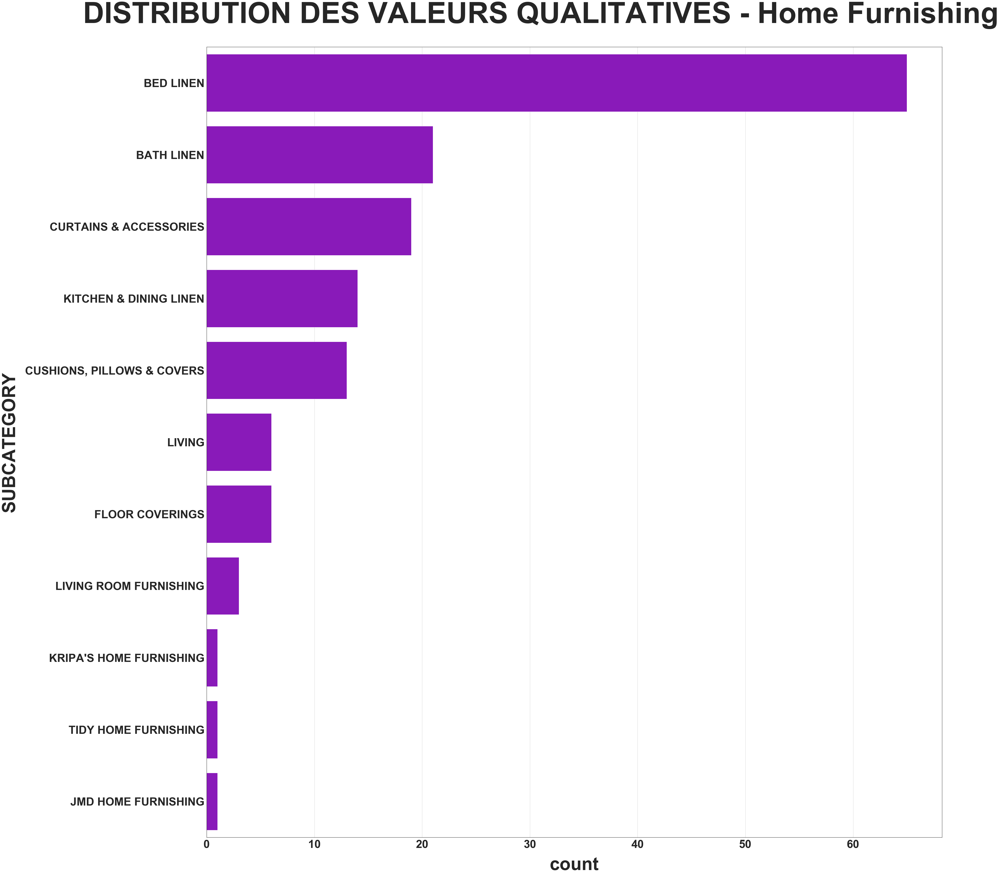

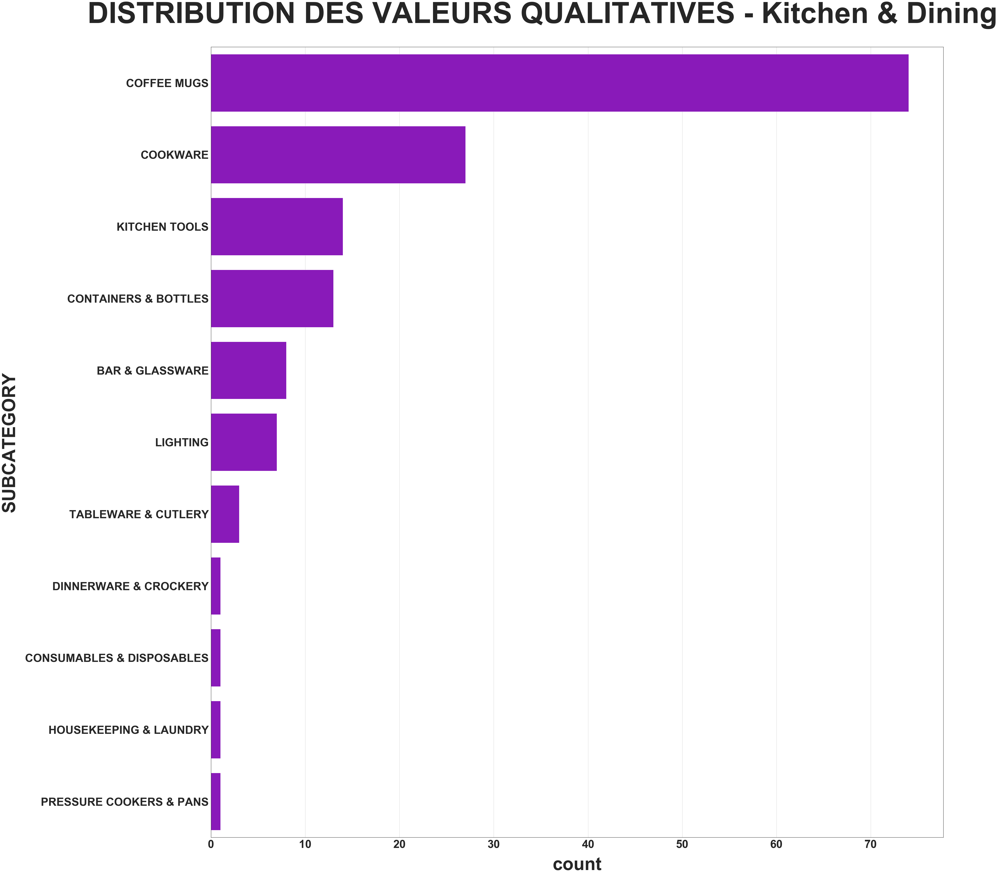

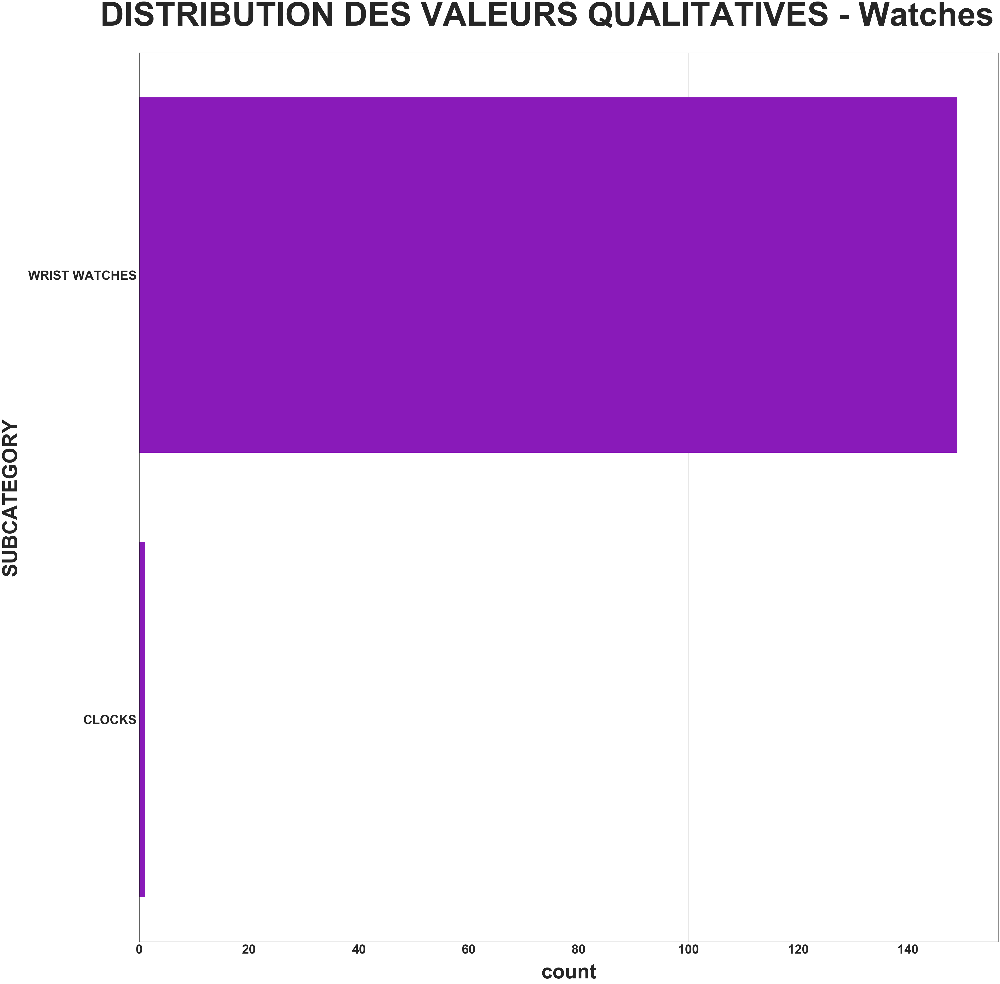

In [120]:
for cat1, cat1_df in products.groupby(["category"]):
    gf.plot_qualitative_dist(cat1_df[["subcategory"]], 1, 1, 50, 50, "- "+cat1)

Les produits sont répartis de façon peu équilibrée entre les différentes sous-catégories au sein des catégories.

Un modèle entraîné sur ces données devrait donc être plus performant sur la prédiction de la catégorie principale que sur celle de la sous-catégorie. 

L'utilisation possible d'un modèle à étage (un modèle prédit la catégorie 1, le 2ème prédit la catégorie 2 une fois la 1ère prédite) aurait pu fonctionner si les catégories de niveau 2 étaient bien équilibrées au sein des catégories de niveau 1. De même pour un modèle qui tenterait de prédire un couple cat1-cat2.

____
#### 3.2 DISTRIBUTION DES MOTS

In [121]:
total_txt_cat = hf.get_nb_words_df(products, "category", "all_words")\
                  .rename(columns={"Nb_Words":"all_words"})\
                  .drop(columns=["Difference"])\
                  .set_index("category")

In [122]:
product_name_cat = hf.get_nb_words_df(products, "category", "product_name")\
                     .rename(columns={"Nb_Words":"product_name"})\
                     .drop(columns=["Difference", "Total_Words"])\
                     .set_index("category")

In [123]:
desc_cat = hf.get_nb_words_df(products, "category", "description")\
             .rename(columns={"Nb_Words":"description"})\
             .drop(columns=["Difference", "Total_Words"])\
             .set_index("category")

In [124]:
product_specs_cat = hf.get_nb_words_df(products, "category", "product_specifications")\
                      .rename(columns={"Nb_Words":"product_specifications"})\
                      .drop(columns=["Difference", "Total_Words"])\
                      .set_index("category")

In [125]:
total_txt_cat = pd.concat([total_txt_cat,
                           product_name_cat,
                           desc_cat, 
                           product_specs_cat], axis=1)

In [126]:
total_txt_cat = total_txt_cat[["product_name", 
                               "description",
                               "product_specifications",
                               "all_words", 
                               "Total_Words"]]

In [127]:
data_to_plot_df = total_txt_cat\
                  .drop(columns="Total_Words")\
                  .div(total_txt_cat["all_words"], axis=0)*100

In [128]:
data_to_plot_df = data_to_plot_df.cumsum(axis=1).drop(columns="all_words")

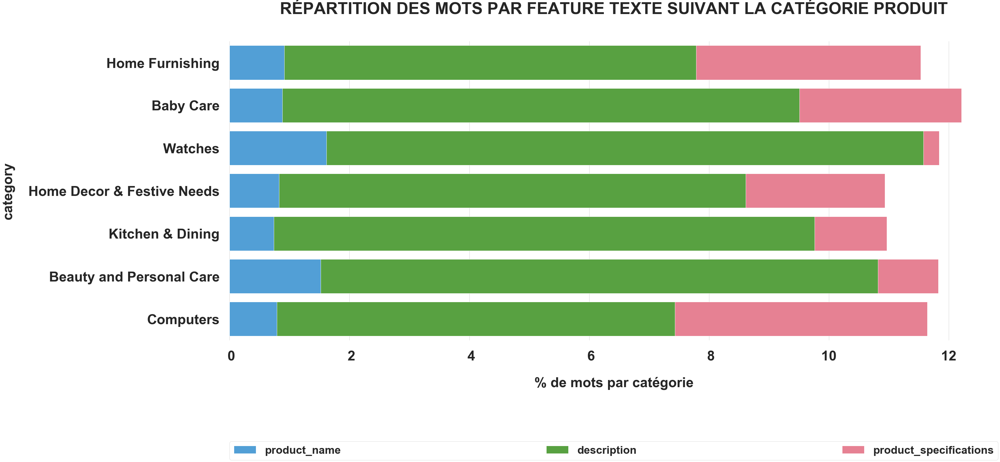

In [129]:
gf.plot_word_number_proportions(data_to_plot_df, 50, 20)

Comme attendu, sur l'ensemble des catégories :
- le nom produit représente la plus faible proportion des mots du corpus
- la description représente la plus importante proportion des mots du corpus

____
#### 3.3 FRÉQUENCE DES MOTS

Les figures ci-après montrent
uniquement les 50 premiers mots les plus utilisés.

##### _<u>3.3.1 Par catégorie dans les noms produit (<i>product_name</i>)</u>_

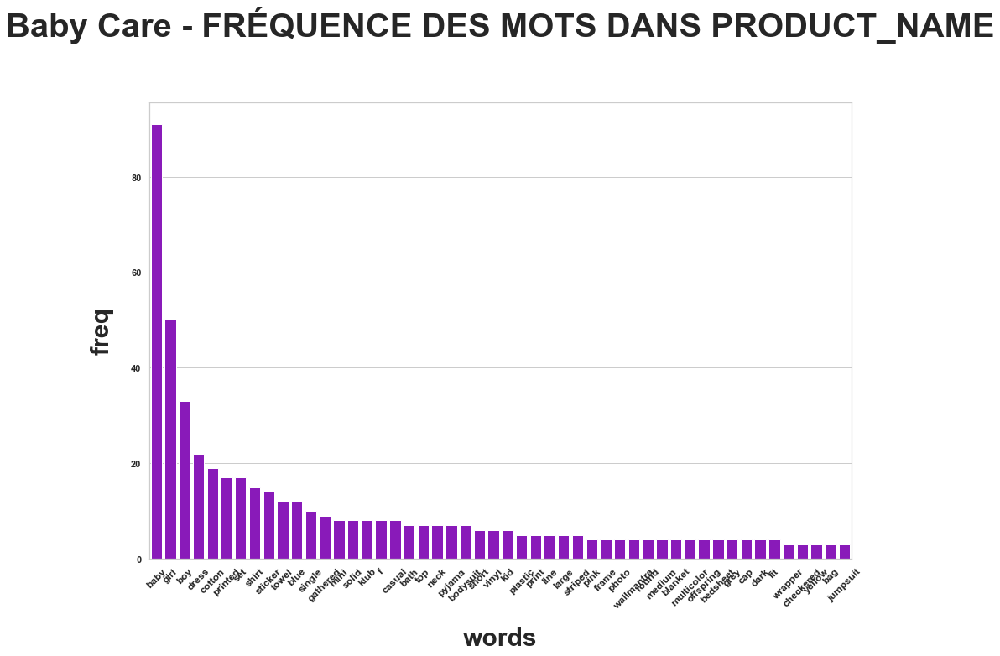

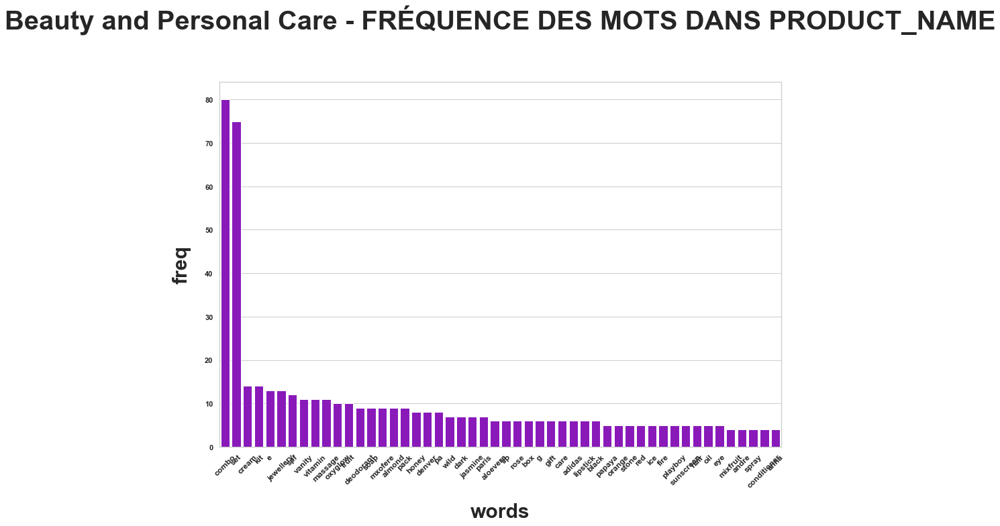

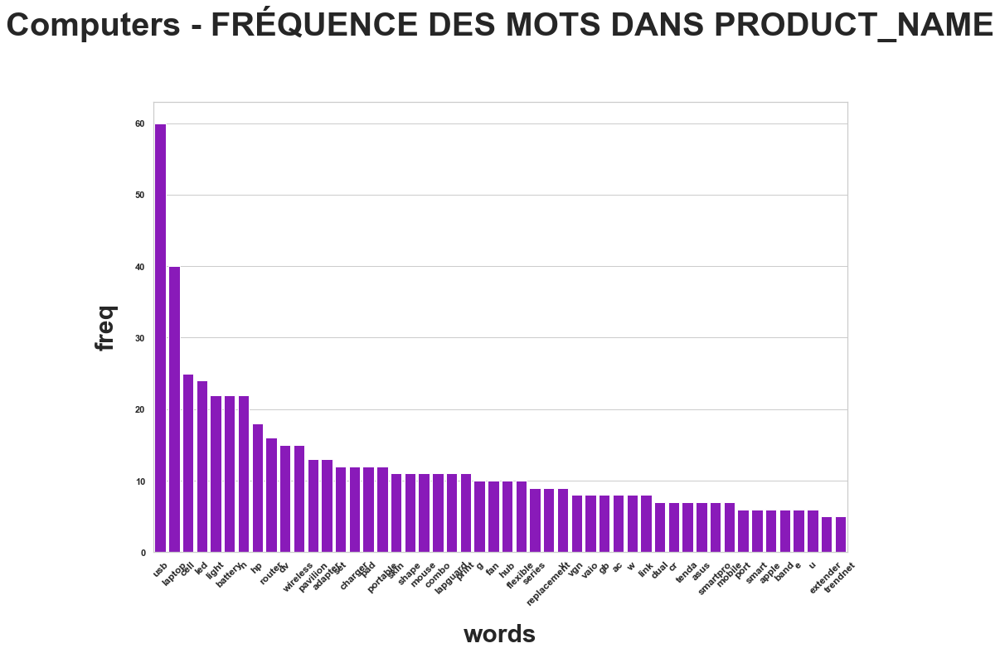

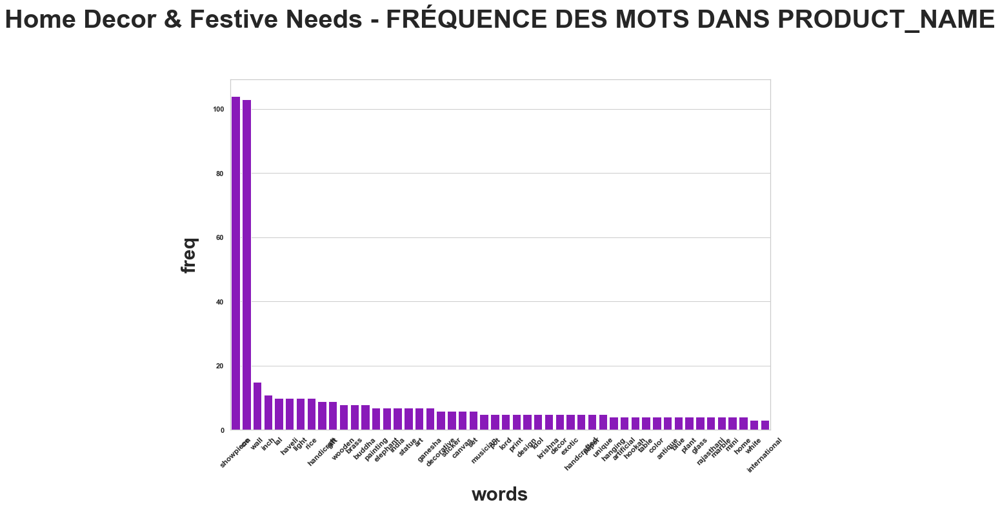

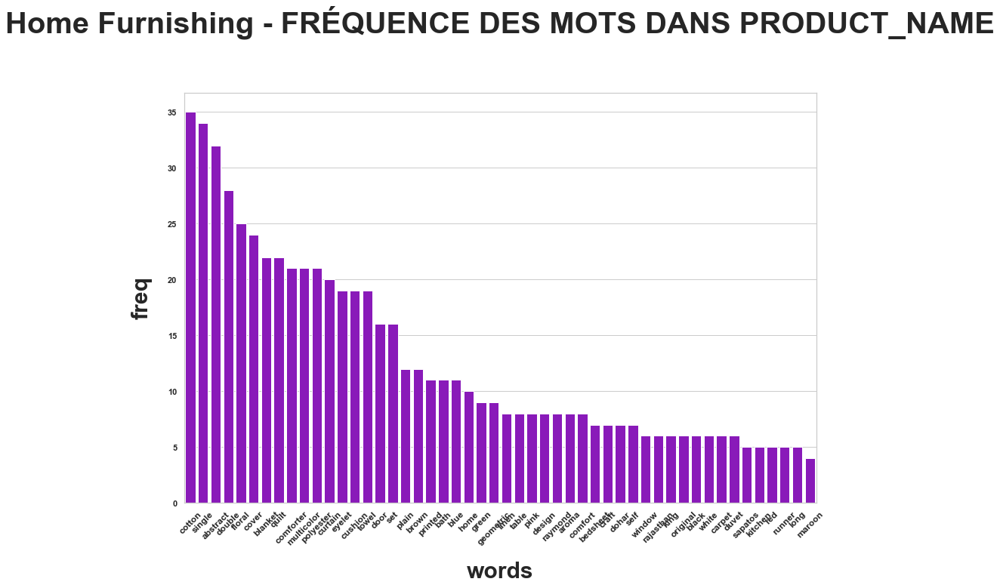

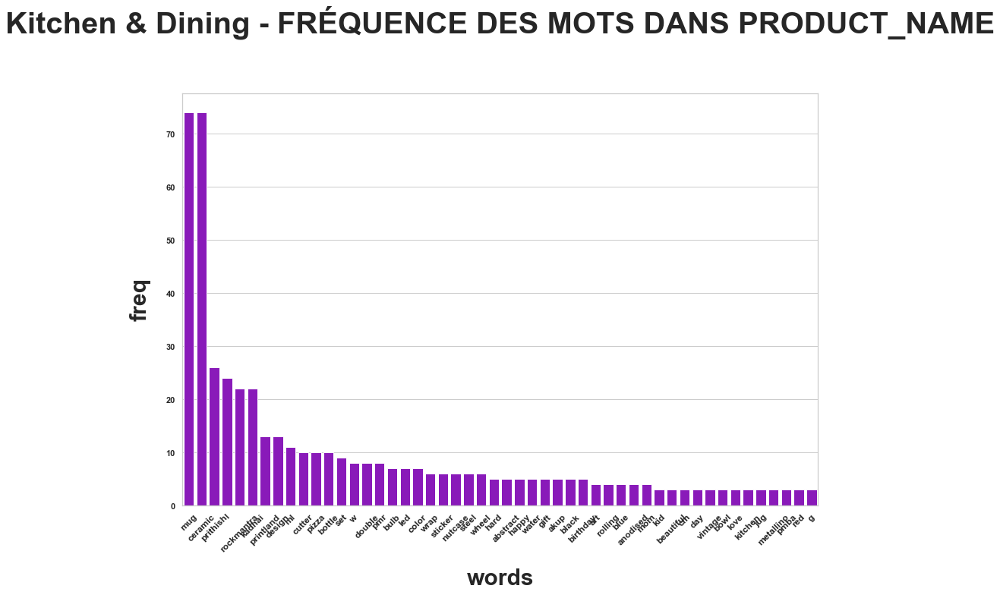

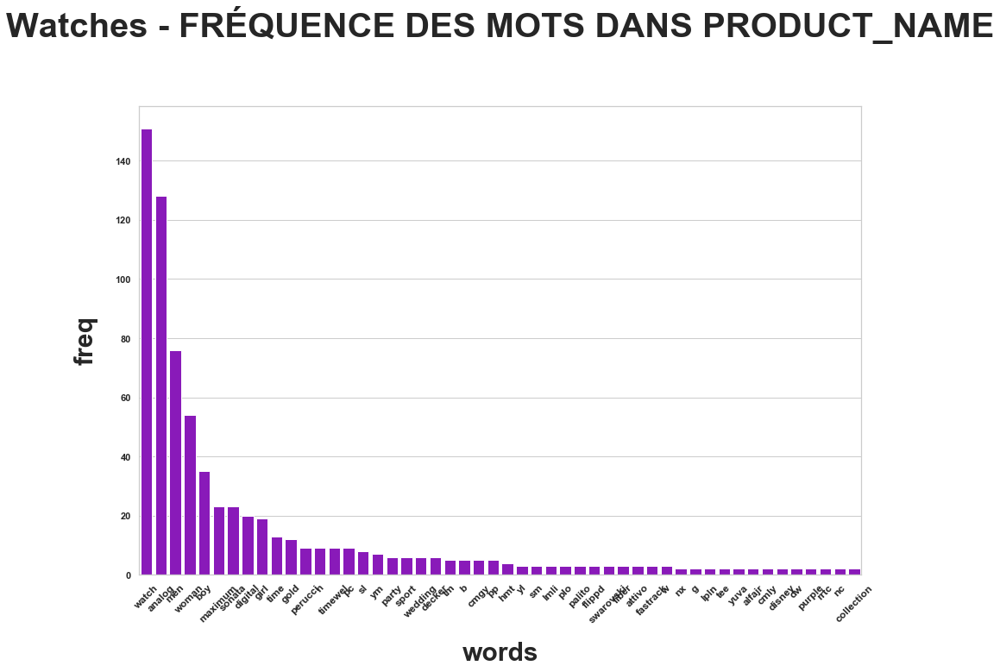

In [130]:
for cat1, data_df in products.groupby("category"):
    most_freq_df = hf.get_most_freq(data_df["product_name"], 50)
    gf.plot_freq_dist(most_freq_df, cat1 + " - FRÉQUENCE DES MOTS DANS PRODUCT_NAME", 15, 10)

##### _<u>3.3.2 Par catégorie dans les descriptions produit (<i>description</i>)</u>_

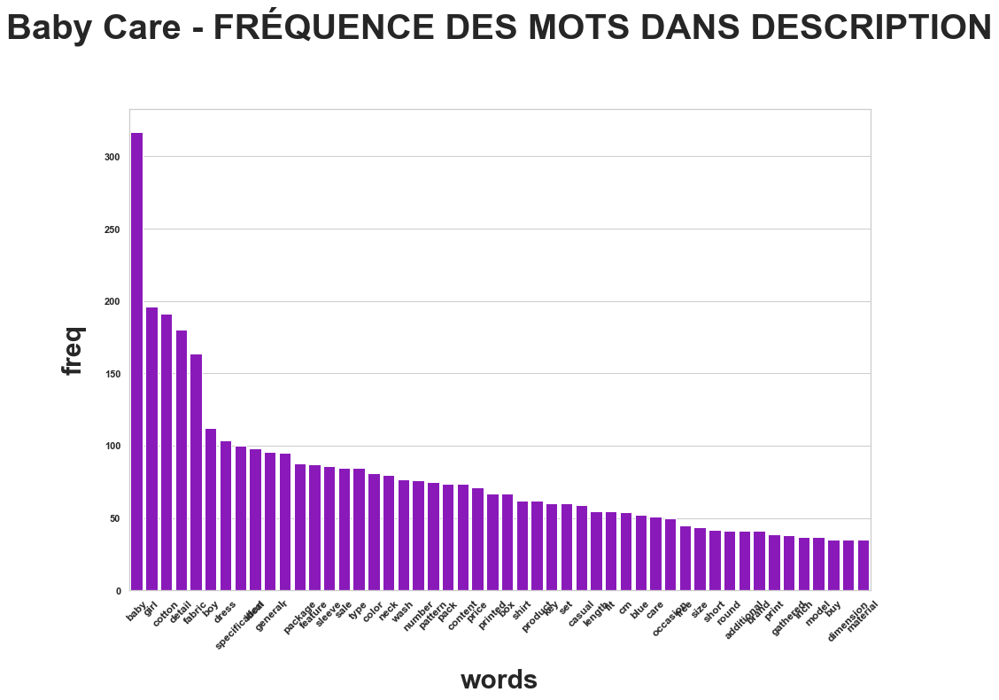

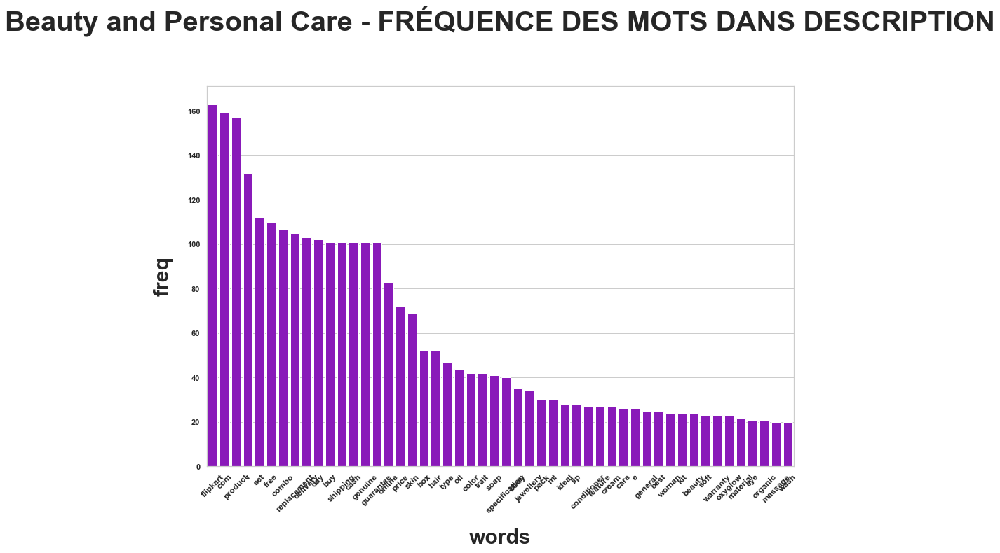

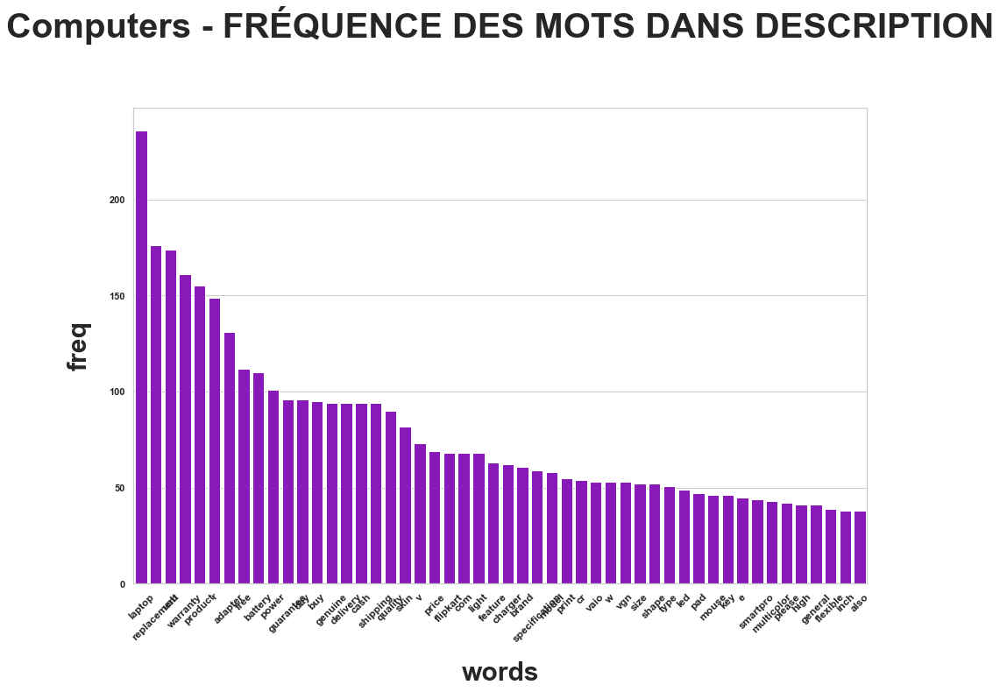

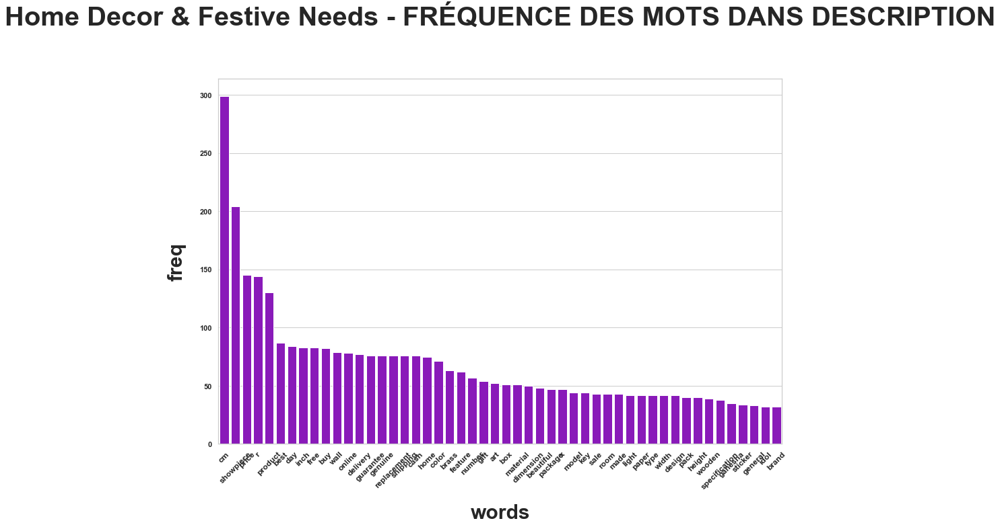

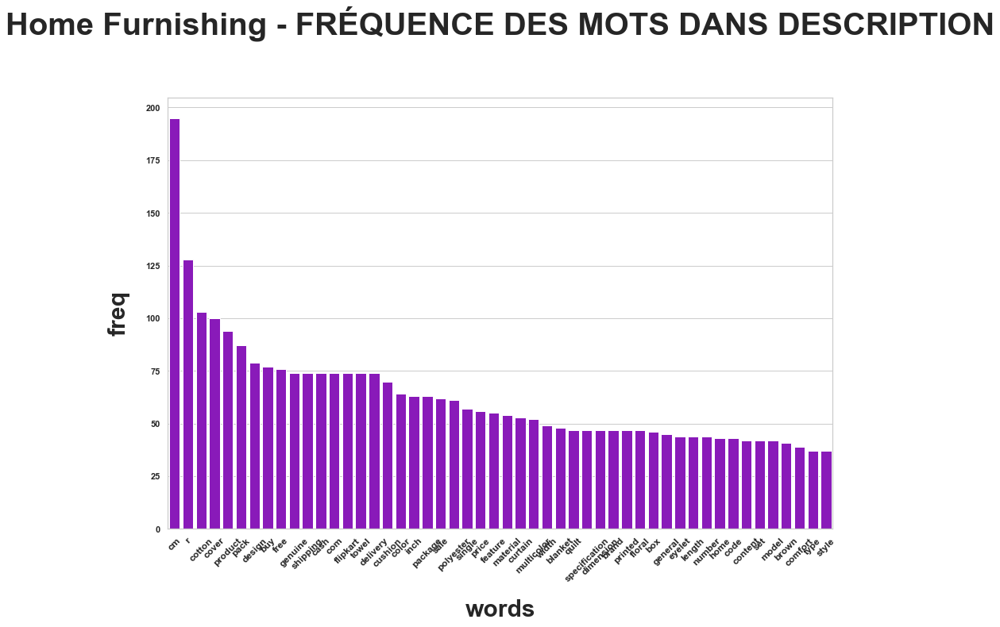

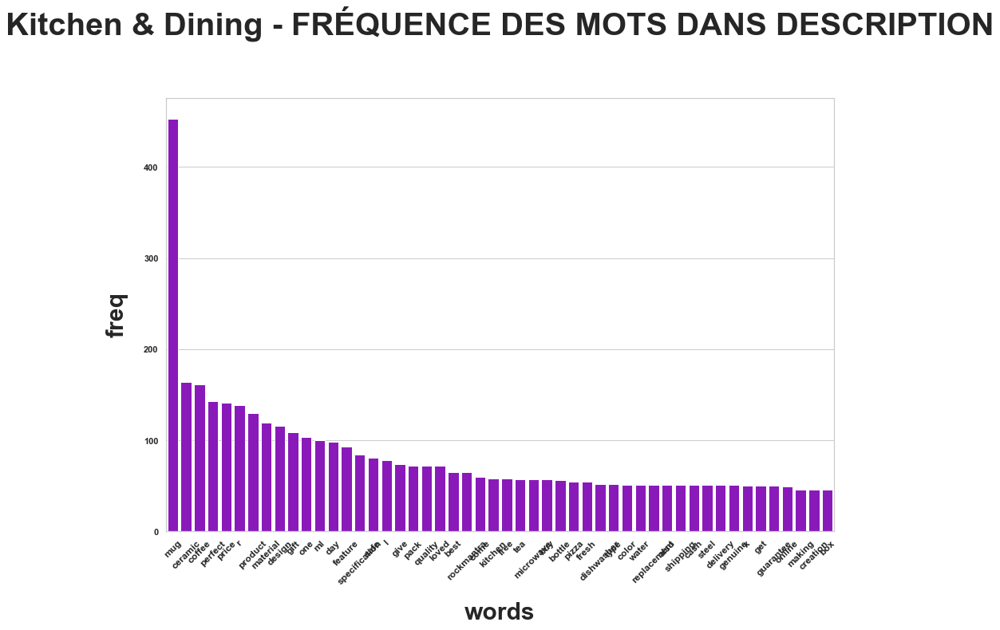

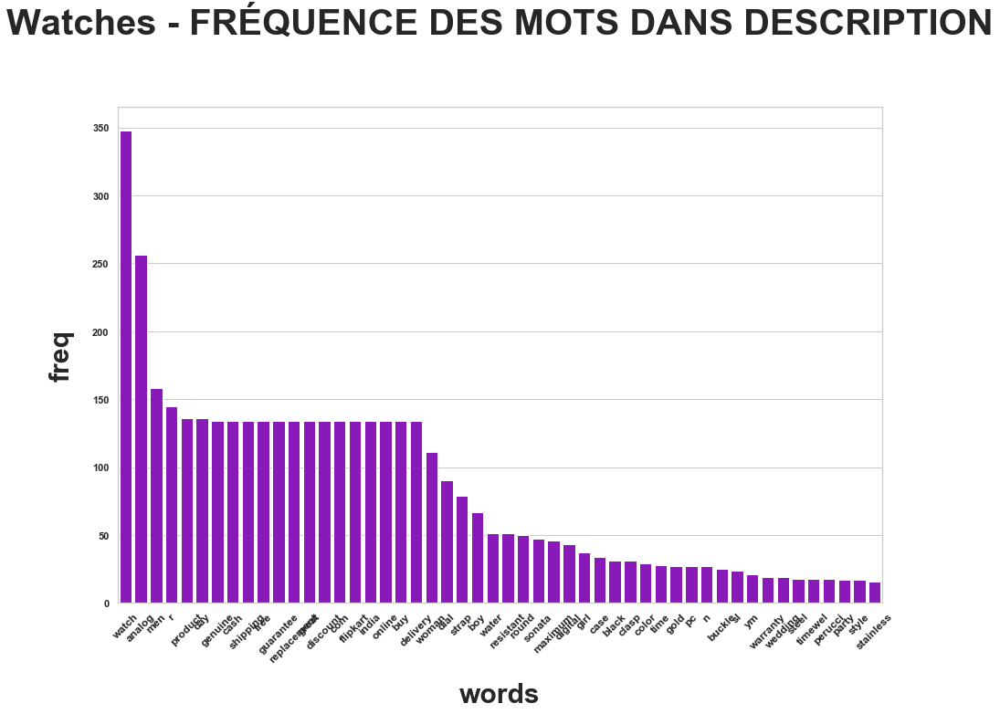

In [131]:
for cat1, data_df in products.groupby("category"):
    most_freq_df = hf.get_most_freq(data_df["description"], 50)
    gf.plot_freq_dist(most_freq_df, cat1 + " - FRÉQUENCE DES MOTS DANS DESCRIPTION", 15, 10)

##### _<u>3.3.3 Par catégorie dans les spécifications produit (<i>product_specifications</i>)</u>_

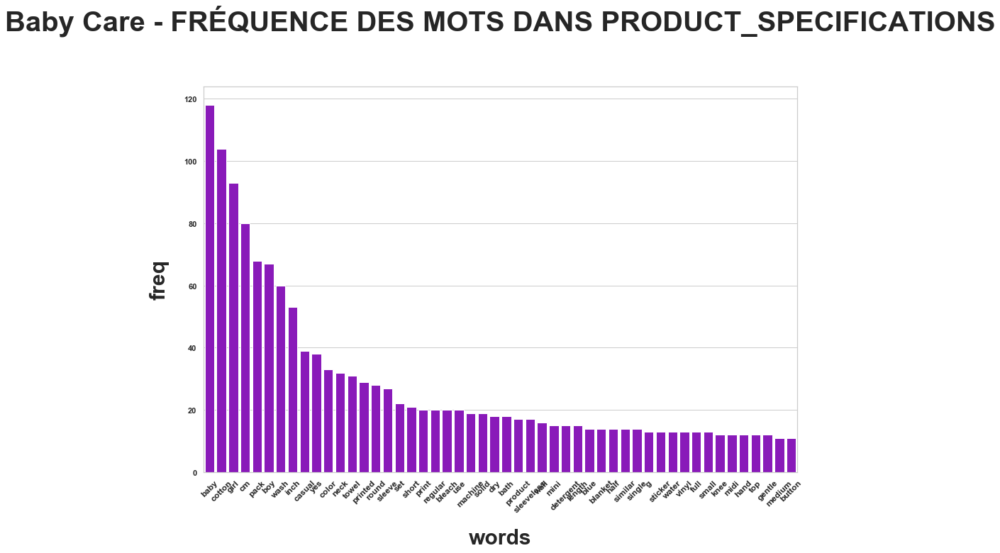

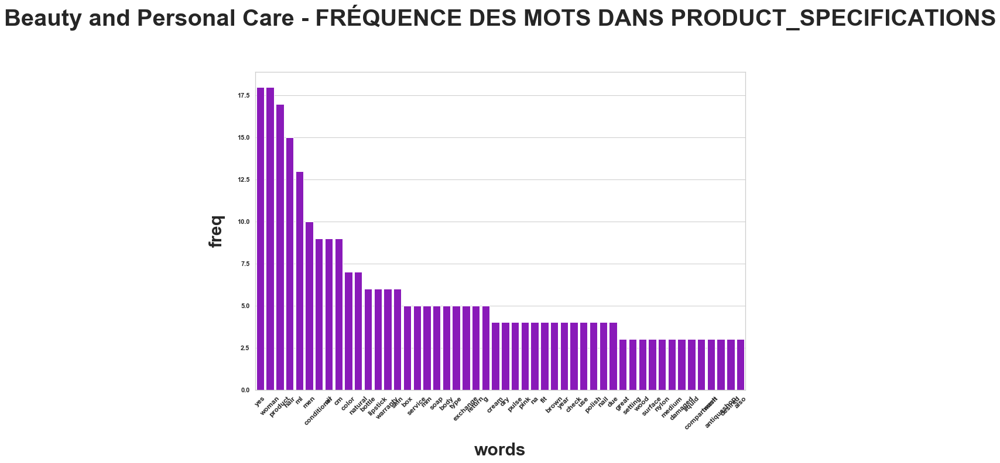

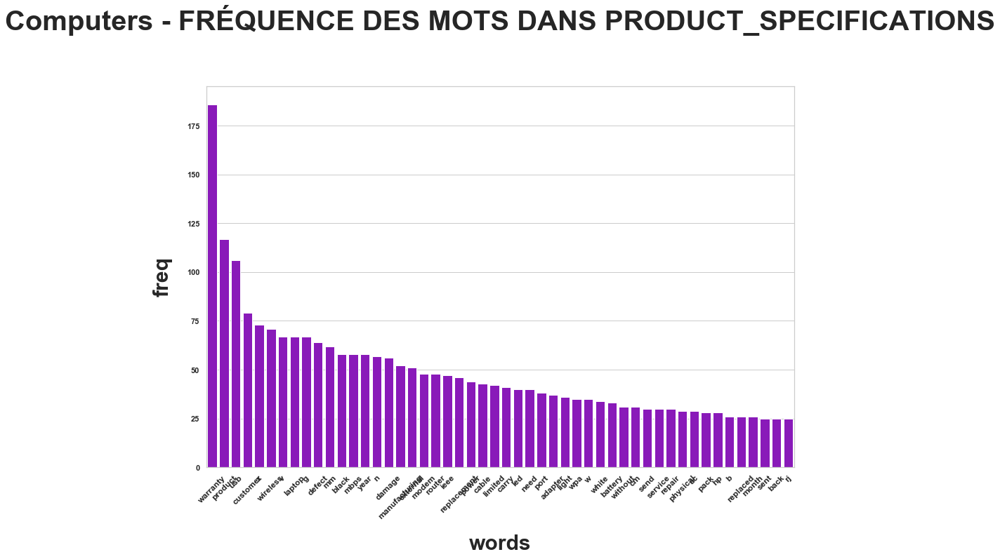

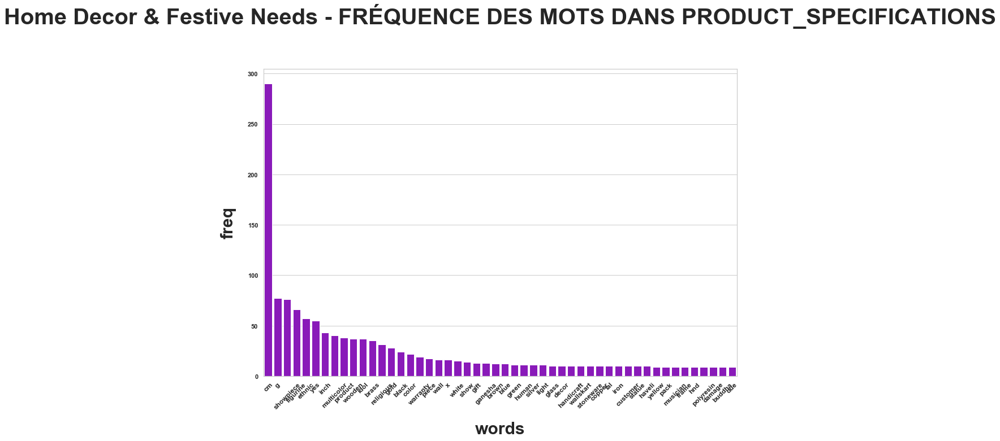

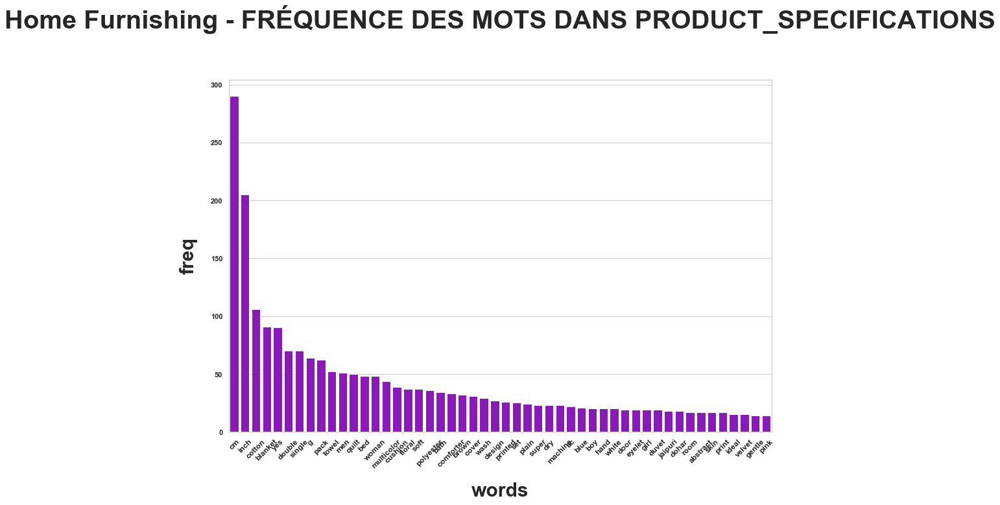

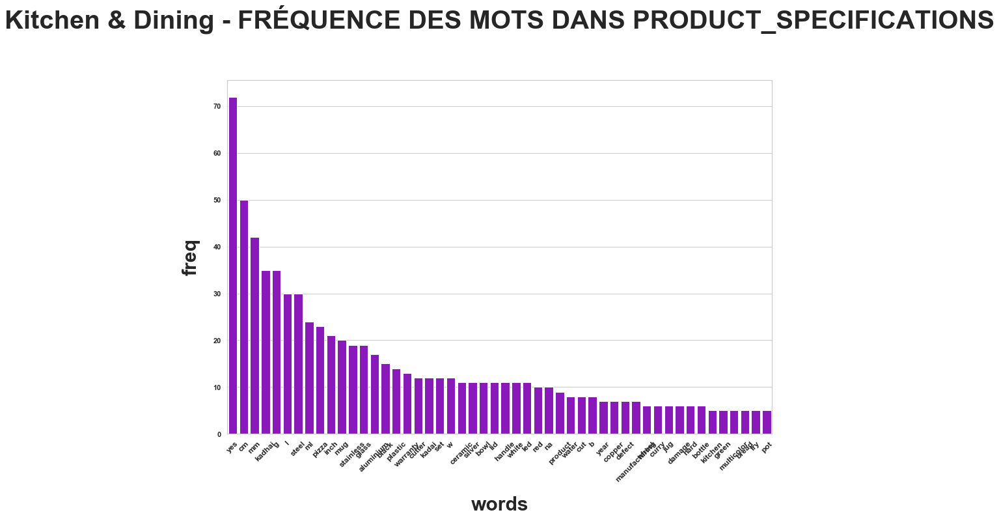

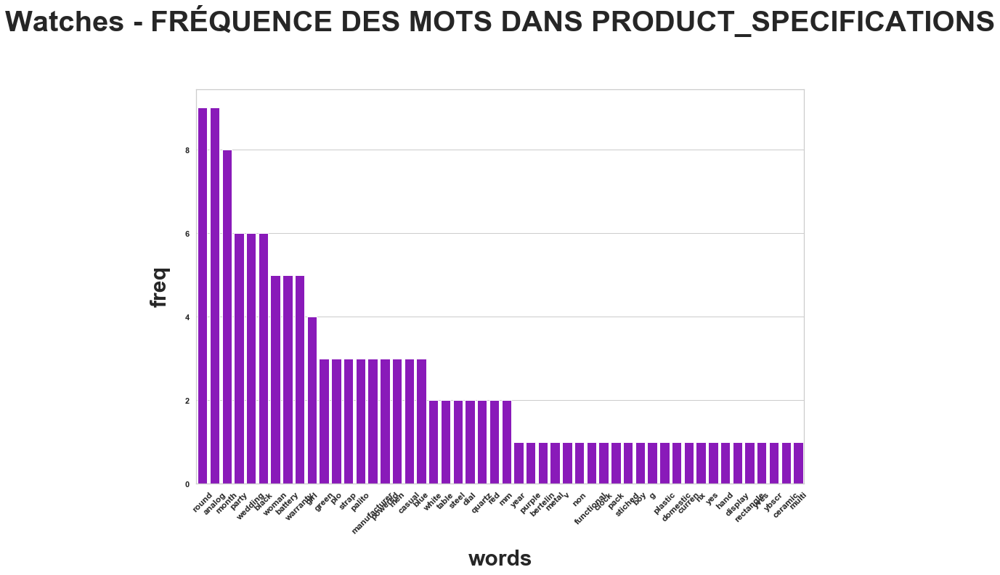

In [132]:
for cat1, data_df in products.groupby("category"):
    most_freq_df = hf.get_most_freq(data_df["product_specifications"], 50)
    gf.plot_freq_dist(most_freq_df, cat1 + " - FRÉQUENCE DES MOTS DANS PRODUCT_SPECIFICATIONS", 15, 10)

##### _<u>3.3.4 Toutes features texte produit confondues (<i>all_words</i>)</u>_

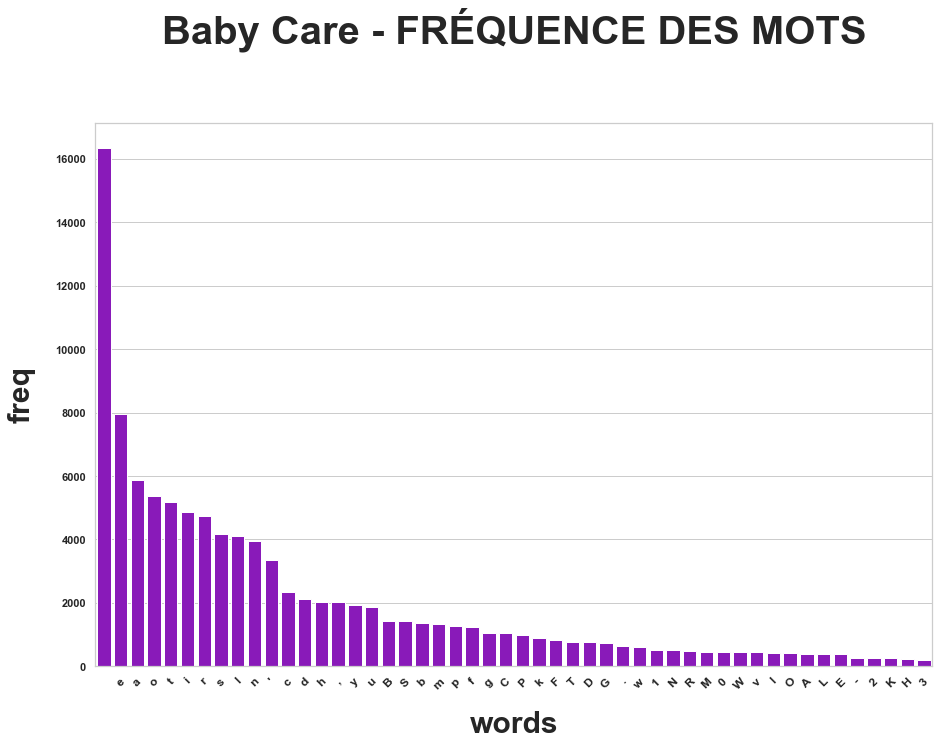

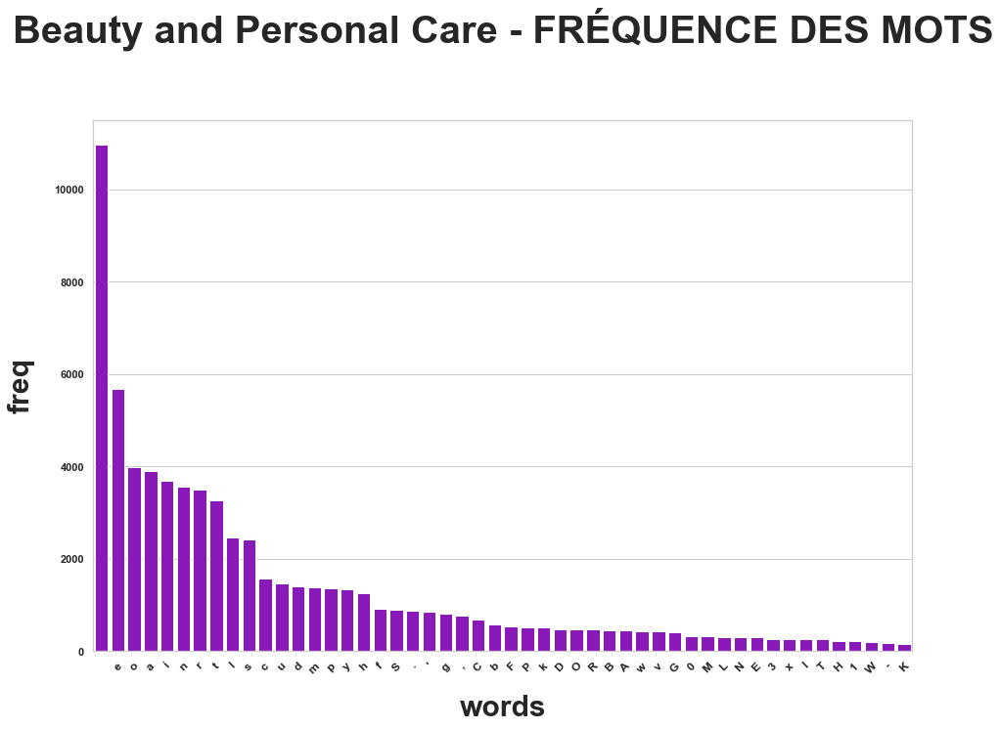

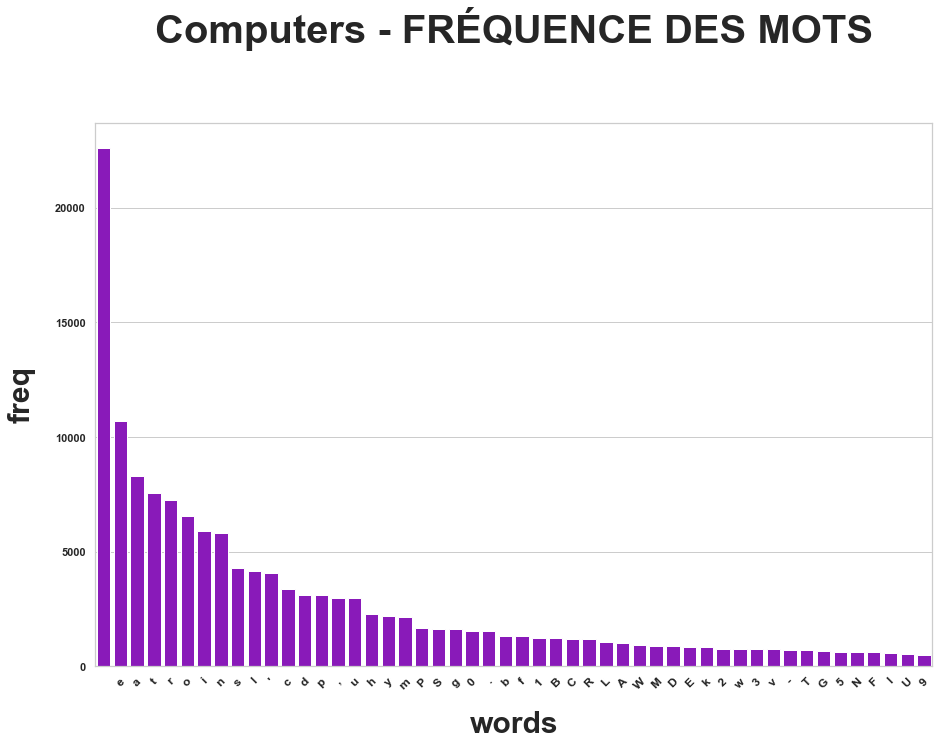

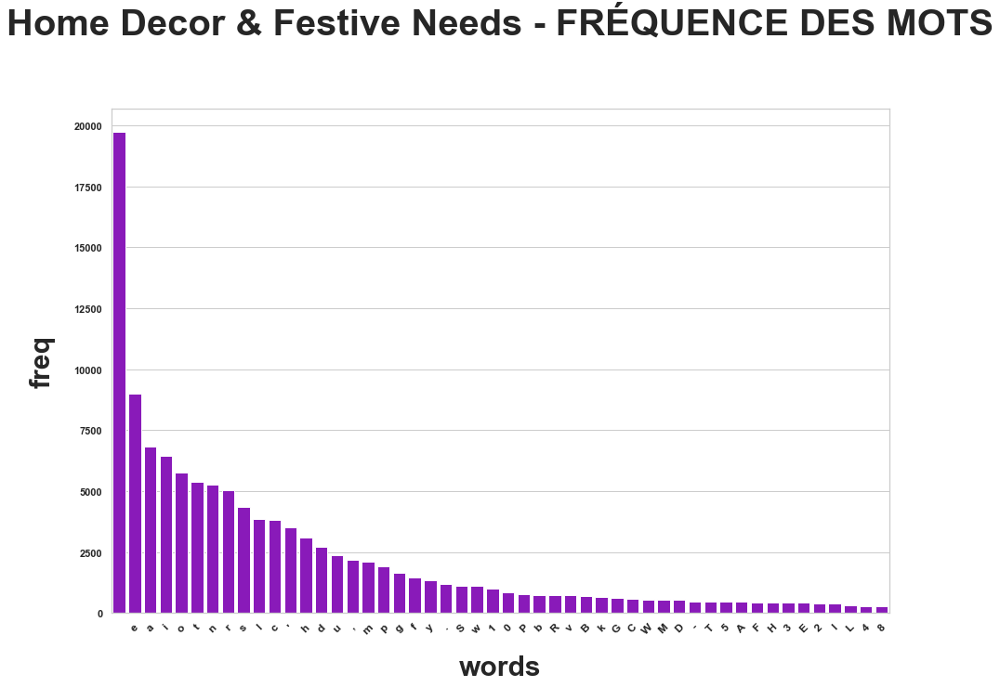

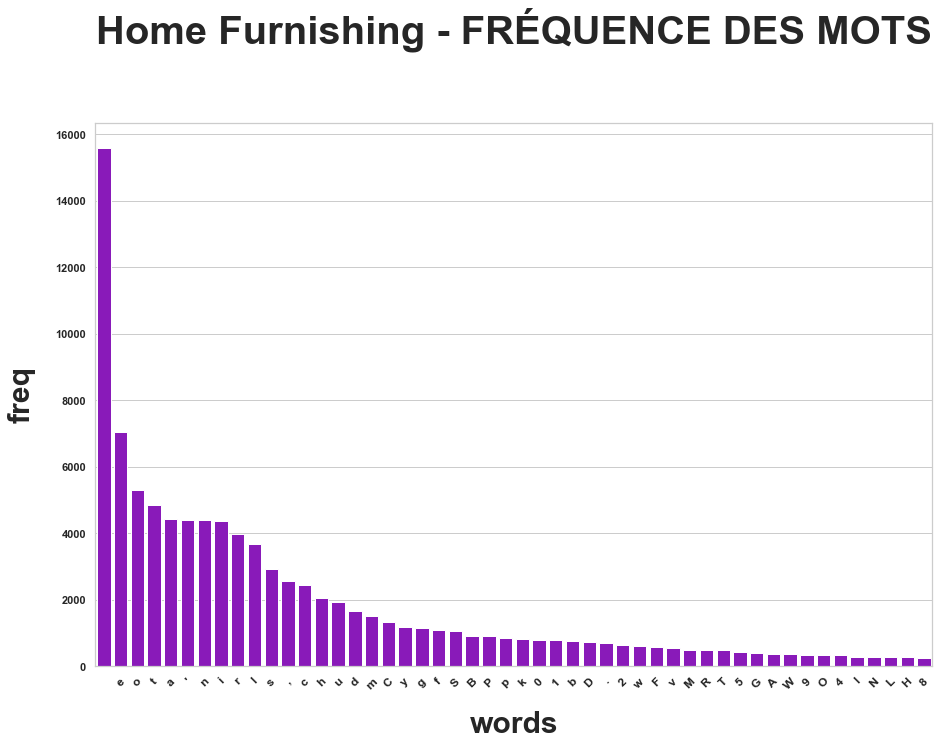

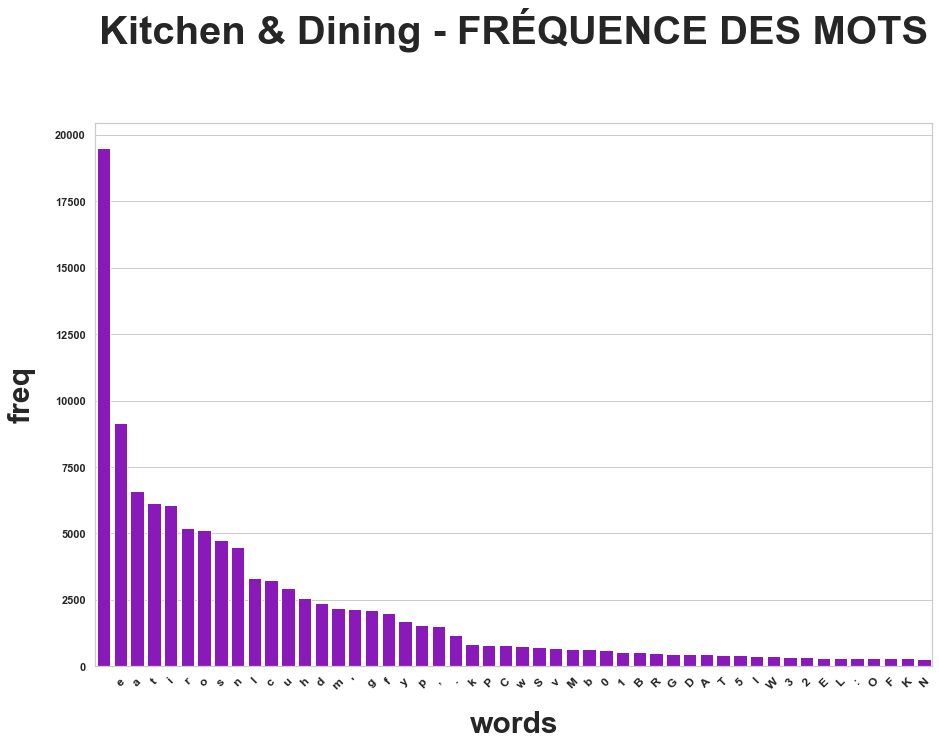

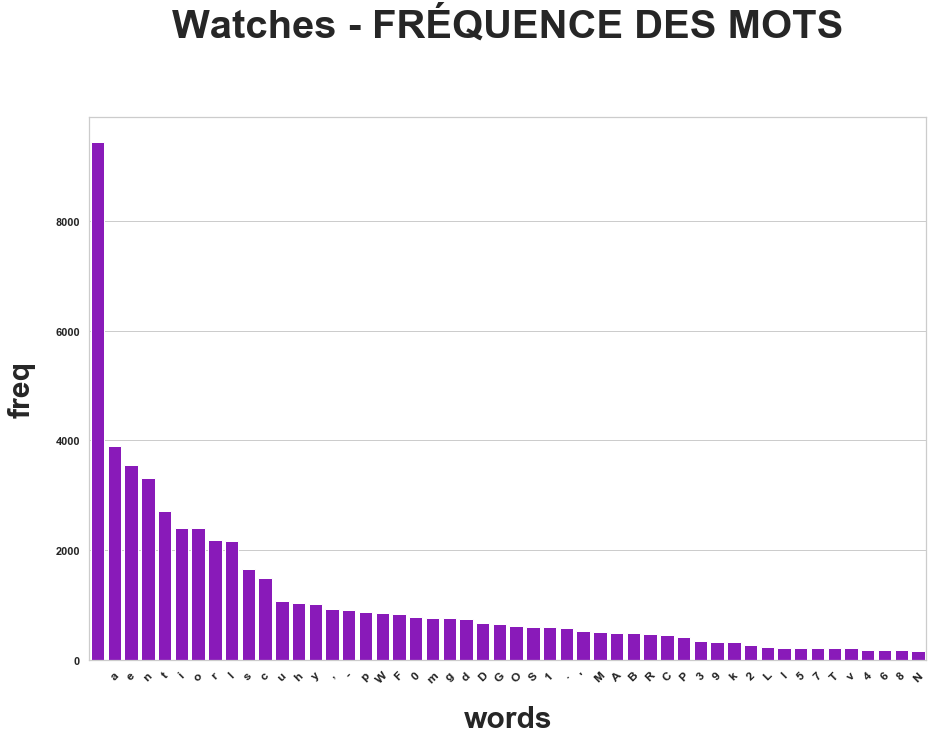

In [133]:
most_freq_dfs = pd.DataFrame()

for cat1, data_df in products.groupby("category"):
    most_freq_df = hf.get_most_freq(data_df["all_words"], 50).reset_index()
    most_freq_df["Category"] = cat1
    most_freq_dfs = pd.concat([most_freq_dfs, most_freq_df])
    gf.plot_freq_dist(most_freq_df, cat1 + " - FRÉQUENCE DES MOTS", 15, 10)

Ci-dessous, les 10 mots les plus utilisés par catégorie, toutes features texte confondues :

**Baby Care**

<table style="width:50%">
  <tr>
    <th>No</th>
    <th>Mot</th>
    <th>Fréquence</th>
  </tr>
  <tr>
    <td>1</td>
    <td>baby</td>
    <td>518</td>
  </tr>
  
  <tr>
    <td>2</td>
    <td>cotton</td>
    <td>317</td>
  </tr>
    
  <tr>
    <td>3</td>
    <td>girl</td>
    <td>312</td>
  </tr>
 
  <tr>
    <td>4</td>
    <td>boy</td>
    <td>212</td>
  </tr>

  <tr>
    <td>5</td>
    <td>detail</td>
    <td>180</td>
  </tr>

  <tr>
    <td>6</td>
    <td>fabric</td>
    <td>164</td>
  </tr>

  <tr>
    <td>7</td>
    <td>pack</td>
    <td>148</td>
  </tr>

  <tr>
    <td>8</td>
    <td>cm</td>
    <td>143</td>
  </tr>
  
  <tr>
    <td>9</td>
    <td>dress</td>
    <td>127</td>
  </tr>
  <tr>
    <td>10</td>
    <td>printed</td>
    <td>118</td>
  </tr>
</table>

**Beauty and Personal Care**

<table style="width:50%">
  <tr>
    <th>No</th>
    <th>Mot</th>
    <th>Fréquence</th>
  </tr>
  <tr>
    <td>1</td>
    <td>set</td>
    <td>191</td>
  </tr>
  
  <tr>
    <td>2</td>
    <td>combo</td>
    <td>188</td>
  </tr>
    
  <tr>
    <td>3</td>
    <td>flipkart</td>
    <td>163</td>
  </tr>
 
  <tr>
    <td>4</td>
    <td>com</td>
    <td>159</td>
  </tr>

  <tr>
    <td>5</td>
    <td>product</td>
    <td>159</td>
  </tr>

  <tr>
    <td>6</td>
    <td>r</td>
    <td>136</td>
  </tr>

  <tr>
    <td>7</td>
    <td>men</td>
    <td>132</td>
  </tr>

  <tr>
    <td>8</td>
    <td>ml</td>
    <td>117</td>
  </tr>
  
  <tr>
    <td>9</td>
    <td>free</td>
    <td>114</td>
  </tr>
  <tr>
    <td>10</td>
    <td>replacement</td>
    <td>105</td>
  </tr>
</table>

**Computers**

<table style="width:50%">
  <tr>
    <th>No</th>
    <th>Mot</th>
    <th>Fréquence</th>
  </tr>
  <tr>
    <td>1</td>
    <td>laptop</td>
    <td>330</td>
  </tr>
  
  <tr>
    <td>2</td>
    <td>warranty</td>
    <td>335</td>
  </tr>
    
  <tr>
    <td>3</td>
    <td>usb</td>
    <td>331</td>
  </tr>
 
  <tr>
    <td>4</td>
    <td>product</td>
    <td>255</td>
  </tr>

  <tr>
    <td>5</td>
    <td>replacement</td>
    <td>221</td>
  </tr>

  <tr>
    <td>6</td>
    <td>battery</td>
    <td>168</td>
  </tr>

  <tr>
    <td>7</td>
    <td>r</td>
    <td>162</td>
  </tr>

  <tr>
    <td>8</td>
    <td>adapter</td>
    <td>161</td>
  </tr>
  
  <tr>
    <td>9</td>
    <td>v</td>
    <td>140</td>
  </tr>
  <tr>
    <td>10</td>
    <td>light</td>
    <td>126</td>
  </tr>
</table>

**Home Decor**

<table style="width:50%">
  <tr>
    <th>No</th>
    <th>Mot</th>
    <th>Fréquence</th>
  </tr>
  <tr>
    <td>1</td>
    <td>cm</td>
    <td>693</td>
  </tr>
  
  <tr>
    <td>2</td>
    <td>showpiece</td>
    <td>384</td>
  </tr>
    
  <tr>
    <td>3</td>
    <td>r</td>
    <td>148</td>
  </tr>
 
  <tr>
    <td>4</td>
    <td>price</td>
    <td>145</td>
  </tr>

  <tr>
    <td>5</td>
    <td>product</td>
    <td>145</td>
  </tr>

  <tr>
    <td>6</td>
    <td>inch</td>
    <td>137</td>
  </tr>

  <tr>
    <td>7</td>
    <td>wall</td>
    <td>126</td>
  </tr>

  <tr>
    <td>8</td>
    <td>g</td>
    <td>105</td>
  </tr>
  
  <tr>
    <td>9</td>
    <td>brass</td>
    <td>105</td>
  </tr>
  <tr>
    <td>10</td>
    <td>color</td>
    <td>94</td>
  </tr>
</table>

**Home Furnishing**

<table style="width:50%">
  <tr>
    <th>No</th>
    <th>Mot</th>
    <th>Fréquence</th>
  </tr>
  <tr>
    <td>1</td>
    <td>cm</td>
    <td>482</td>
  </tr>
  
  <tr>
    <td>2</td>
    <td>inch</td>
    <td>268</td>
  </tr>
    
  <tr>
    <td>3</td>
    <td>cotton</td>
    <td>238</td>
  </tr>
 
  <tr>
    <td>4</td>
    <td>single</td>
    <td>161</td>
  </tr>

  <tr>
    <td>5</td>
    <td>blanket</td>
    <td>155</td>
  </tr>

  <tr>
    <td>6</td>
    <td>pack</td>
    <td>150</td>
  </tr>

  <tr>
    <td>7</td>
    <td>cover</td>
    <td>147</td>
  </tr>

  <tr>
    <td>8</td>
    <td>towel</td>
    <td>139</td>
  </tr>
  
  <tr>
    <td>9</td>
    <td>washable</td>
    <td>130</td>
  </tr>
  <tr>
    <td>10</td>
    <td>r</td>
    <td>128</td>
  </tr>
</table>

**Kitchen & Dining**

<table style="width:50%">
  <tr>
    <th>No</th>
    <th>Mot</th>
    <th>Fréquence</th>
  </tr>
  <tr>
    <td>1</td>
    <td>mug</td>
    <td>671</td>
  </tr>
  
  <tr>
    <td>2</td>
    <td>ceramic</td>
    <td>312</td>
  </tr>
    
  <tr>
    <td>3</td>
    <td>safe</td>
    <td>228</td>
  </tr>
 
  <tr>
    <td>4</td>
    <td>mm</td>
    <td>204</td>
  </tr>

  <tr>
    <td>5</td>
    <td>ml</td>
    <td>174</td>
  </tr>

  <tr>
    <td>6</td>
    <td>coffee</td>
    <td>163</td>
  </tr>

  <tr>
    <td>7</td>
    <td>l</td>
    <td>153</td>
  </tr>

  <tr>
    <td>8</td>
    <td>perfect</td>
    <td>143</td>
  </tr>
  
  <tr>
    <td>9</td>
    <td>price</td>
    <td>141</td>
  </tr>
  <tr>
    <td>10</td>
    <td>r</td>
    <td>140</td>
  </tr>
</table>

**Watches**

<table style="width:50%">
  <tr>
    <th>No</th>
    <th>Mot</th>
    <th>Fréquence</th>
  </tr>
  <tr>
    <td>1</td>
    <td>watch</td>
    <td>518</td>
  </tr>
  
  <tr>
    <td>2</td>
    <td>analog</td>
    <td>515</td>
  </tr>
    
  <tr>
    <td>3</td>
    <td>men</td>
    <td>302</td>
  </tr>
 
  <tr>
    <td>4</td>
    <td>resistant</td>
    <td>222</td>
  </tr>

  <tr>
    <td>5</td>
    <td>strap</td>
    <td>217</td>
  </tr>

  <tr>
    <td>6</td>
    <td>woman</td>
    <td>211</td>
  </tr>

  <tr>
    <td>7</td>
    <td>water</td>
    <td>159</td>
  </tr>

  <tr>
    <td>8</td>
    <td>round</td>
    <td>152</td>
  </tr>
  
  <tr>
    <td>9</td>
    <td>genuine</td>
    <td>149</td>
  </tr>
  <tr>
    <td>10</td>
    <td>r</td>
    <td>148</td>
  </tr>
</table>

Les mots les plus fréquents sont relativement différents pourchaque catégorie. 
Cela laisse à présager qu'un modèle basé sur les données texte pourrait fonctionner.

___
### 4. ÉTUDE DE FAISABILITÉ

___
#### 4.1 À PARTIR DES DONNÉES IMAGE

Nous utilisons ici la méthode SIFT pour extraire les points-clés et les descripteurs de chaque image, à partir desquels nous créerons notre dictionnaire de mots visuels.

Le filtrage ayant parfois ajouté / parfois supprimé du bruit par rapport aux images corrigées, nous allons tester les 3 jeux d'images : 
- les images corrigées (correction d'histogramme)
- les images corrigées + filtrage gaussien
- les images corrigées + filtrage médian

##### _<u>4.1.1 Obtention des points-clés et des descripteurs</u>_

In [134]:
KEYPOINTS = 10

_<u>Image corrigée</u>_

In [135]:
keypoints_corr, descriptors_corr = hf.assembleKeypointsDescriptors(products, 
                                                                   "corrected_img", 
                                                                   KEYPOINTS)

_<u>Image corrigée + filtrage gaussien</u>_

In [136]:
keypoints_gauss, descriptors_gauss = hf.assembleKeypointsDescriptors(products, 
                                                                     "corr_gauss_img", 
                                                                     KEYPOINTS)

_<u>Image corrigée + filtrage médian</u>_

In [137]:
keypoints_med, descriptors_med = hf.assembleKeypointsDescriptors(products, 
                                                                 "corr_med_img", 
                                                                 KEYPOINTS)

##### _<u>4.1.2 Création du dictionnaire de mots visuels</u>_

Les mots de notre dictionnaire visuel seront les centroïdes des clusters obtenus à partir des descripteurs du corpus d'images.

###### 4.1.2.1 Clustering

On va utiliser l'algorithme KMeans, un algorithme généraliste qui donne de bons résultats sur une variété de problèmes.

In [138]:
N_CLUSTERS = 70

In [139]:
model = KMeans(n_clusters=N_CLUSTERS, random_state=42)

_<u>Image corrigée</u>_

In [140]:
data_clustering_corr = descriptors_corr.iloc[:,:-4]

In [141]:
model.fit(data_clustering_corr)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=70, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=42, tol=0.0001, verbose=0)

In [142]:
data_clustering_corr["cluster"] = model.labels_

In [143]:
visual_words_corr = model.cluster_centers_

_<u>Image corrigée + filtrage gaussien</u>_

In [144]:
data_clustering_gauss = descriptors_gauss.iloc[:,:-4]

In [145]:
model.fit(data_clustering_gauss)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=70, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=42, tol=0.0001, verbose=0)

In [146]:
data_clustering_gauss["cluster"] = model.labels_

In [147]:
visual_words_gauss = model.cluster_centers_

_<u>Image corrigée + filtrage médian</u>_

In [148]:
data_clustering_med = descriptors_med.iloc[:,:-4]

In [149]:
model.fit(data_clustering_med)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=70, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=42, tol=0.0001, verbose=0)

In [150]:
data_clustering_med["cluster"] = model.labels_

In [151]:
visual_words_med = model.cluster_centers_

###### 4.1.2.2 Affichage de quelques mots visuels

_<u>Image corrigée</u>_

In [374]:
hf.generate_visual_word_pics(visual_words_corr, 
                             data_clustering_corr, 
                             "corrected_img",
                             keypoints_corr,
                             descriptors_corr, 
                             "")

Quelques exemples de mots visuels de notre dictionnaire :

In [375]:
Image.open("./output/cropped_pictures/cropped_10.png")

In [376]:
Image.open("./output/cropped_pictures/cropped_11.png")

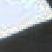

In [377]:
Image.open("./output/cropped_pictures/cropped_26.png")

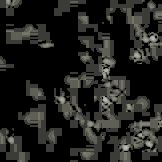

In [158]:
Image.open("./output/cropped_pictures/cropped_28.png")

In [159]:
Image.open("./output/cropped_pictures/cropped_32.png")

In [160]:
Image.open("./output/cropped_pictures/cropped_36.png")

In [161]:
Image.open("./output/cropped_pictures/cropped_43.png")

In [162]:
Image.open("./output/cropped_pictures/cropped_45.png")

In [163]:
Image.open("./output/cropped_pictures/cropped_53.png")

In [164]:
Image.open("./output/cropped_pictures/cropped_54.png")

In [165]:
Image.open("./output/cropped_pictures/cropped_60.png")

In [166]:
Image.open("./output/cropped_pictures/cropped_65.png")

_<u>Image corrigée + filtrage gaussien</u>_

In [384]:
hf.generate_visual_word_pics(visual_words_gauss, 
                             data_clustering_gauss, 
                             "corr_gauss_img",
                             keypoints_gauss,
                             descriptors_gauss, 
                             "gauss")

Quelques exemples de mots visuels de notre dictionnaire :

In [379]:
Image.open("./output/cropped_pictures/gauss/cropped_10.png")

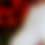

In [380]:
Image.open("./output/cropped_pictures/gauss/cropped_11.png")

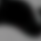

In [381]:
Image.open("./output/cropped_pictures/gauss/cropped_26.png")

In [173]:
Image.open("./output/cropped_pictures/gauss/cropped_28.png")

In [174]:
Image.open("./output/cropped_pictures/gauss/cropped_32.png")

In [175]:
Image.open("./output/cropped_pictures/gauss/cropped_36.png")

In [176]:
Image.open("./output/cropped_pictures/gauss/cropped_43.png")

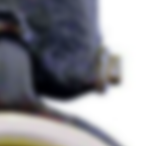

In [177]:
Image.open("./output/cropped_pictures/gauss/cropped_45.png")

In [178]:
Image.open("./output/cropped_pictures/gauss/cropped_53.png")

In [179]:
Image.open("./output/cropped_pictures/gauss/cropped_54.png")

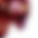

In [180]:
Image.open("./output/cropped_pictures/gauss/cropped_60.png")

In [181]:
Image.open("./output/cropped_pictures/gauss/cropped_65.png")

_<u>Image corrigée + filtrage médian</u>_

In [383]:
hf.generate_visual_word_pics(visual_words_med, 
                             data_clustering_med, 
                             "corr_med_img",
                             keypoints_med,
                             descriptors_med, 
                             "med")

Quelques exemples de mots visuels de notre dictionnaire :

In [185]:
Image.open("./output/cropped_pictures/med/cropped_10.png")

In [186]:
Image.open("./output/cropped_pictures/med/cropped_11.png")

In [187]:
Image.open("./output/cropped_pictures/med/cropped_26.png")

In [188]:
Image.open("./output/cropped_pictures/med/cropped_28.png")

In [189]:
Image.open("./output/cropped_pictures/med/cropped_32.png")

In [190]:
Image.open("./output/cropped_pictures/med/cropped_36.png")

In [191]:
Image.open("./output/cropped_pictures/med/cropped_43.png")

In [192]:
Image.open("./output/cropped_pictures/med/cropped_45.png")

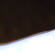

In [193]:
Image.open("./output/cropped_pictures/med/cropped_53.png")

In [194]:
Image.open("./output/cropped_pictures/med/cropped_54.png")

In [195]:
Image.open("./output/cropped_pictures/med/cropped_60.png")

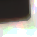

In [196]:
Image.open("./output/cropped_pictures/med/cropped_65.png")

##### _<u>4.1.3 Création des BOVW pour toutes les images</u>_

Pour chaque image, un histogramme des mots visuels du dictionnaire est calculé. Ce sont nos Bags of Visual Words pour chaque image.

###### 4.1.3.1 Calcul des BOVW

_<u>Images corrigées</u>_

In [197]:
bovw_corr = hf.getImgsHisto(descriptors_corr, visual_words_corr)

_Un point d'observation_

On constate que le bovw contient moins de lignes que le nombre de produits.

In [198]:
bovw_corr.shape

(1033, 73)

In [199]:
products.shape

(1049, 16)

In [200]:
len(products["image"].unique())

1049

On constate que le bovw contient moins de lignes que le nombre de produits.

Cela s'explique par le fait que certains produidts, bien qu'ayant un identifiant et un nom de photo différents, sont en réalité le même produit, avec une photo identique.

L'algorithme de traitement reconnaît ces cas et assigne toujours la même photo aux visual words, d'où une dataframe légèrement plus courte, contenant uniquement les données des photos uniques.

In [201]:
doublons = products[~products["image"].isin(bovw_corr["image"])]

_<u>Images corrigées + filtrage gaussien</u>_

In [202]:
bovw_gauss = hf.getImgsHisto(descriptors_gauss, visual_words_gauss)

_<u>Images corrigées + filtrage médian</u>_

In [203]:
bovw_med = hf.getImgsHisto(descriptors_med, visual_words_med)

###### 4.1.3.2 Affichage de quelques BOVW par catégorie

_<u>Images corrigées</u>_

**Catégorie "Watches"**

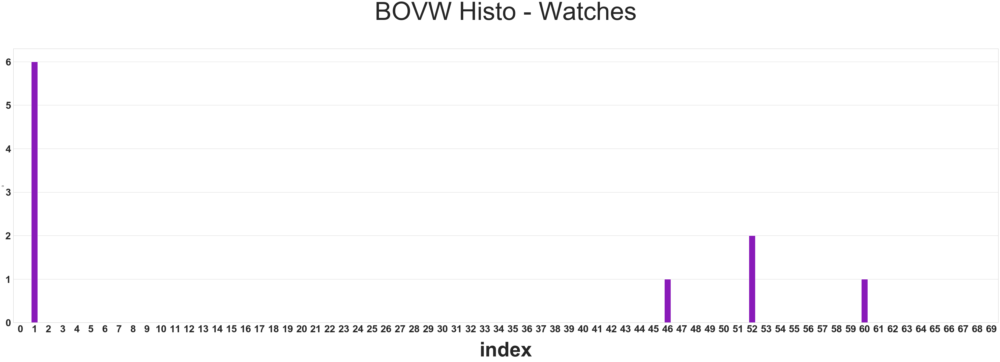

In [204]:
gf.plot_bovw_histo(bovw_corr, 
                   bovw_corr[bovw_corr["category"]=="Watches"].head(1).index[0], 
                   "BOVW Histo - Watches", 70, 20)

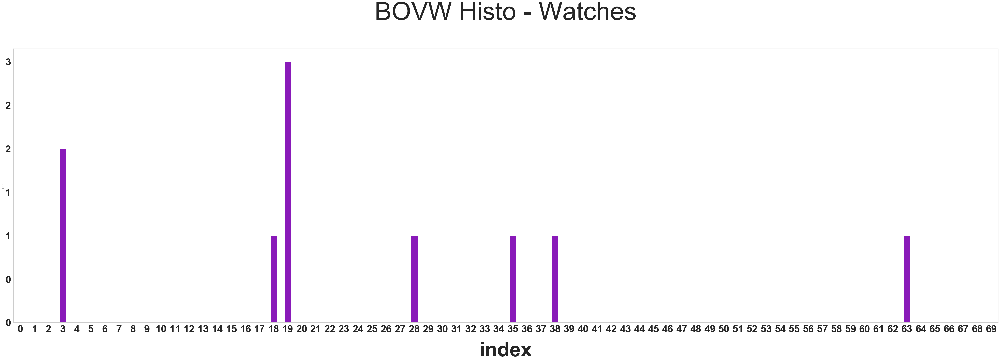

In [205]:
gf.plot_bovw_histo(bovw_corr, 
                   bovw_corr[bovw_corr["category"]=="Watches"].tail(1).index[0], 
                   "BOVW Histo - Watches", 70, 20)

**Catégorie "Kitchen & Dining"**

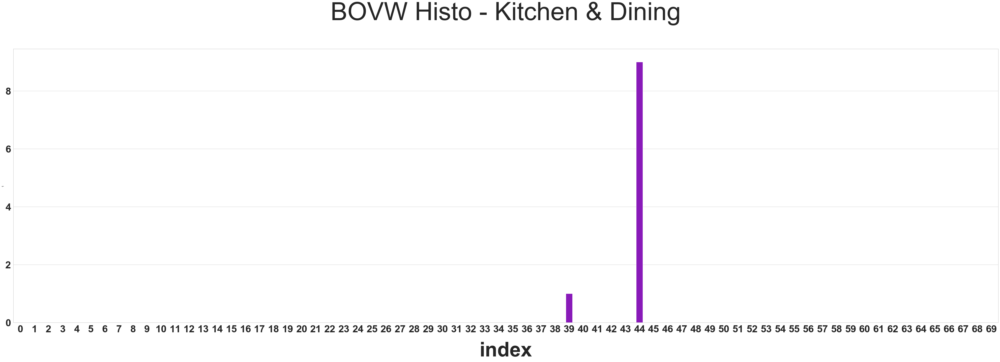

In [206]:
gf.plot_bovw_histo(bovw_corr, 
                   bovw_corr[bovw_corr["category"]=="Kitchen & Dining"].head(1).index[0], 
                   "BOVW Histo - Kitchen & Dining", 70, 20)

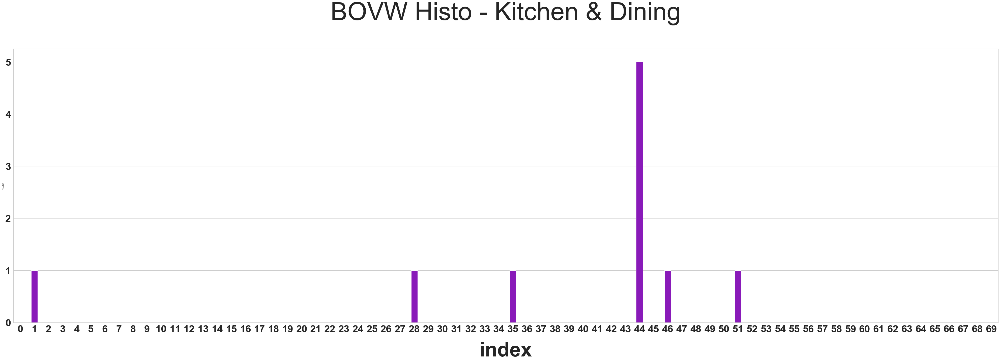

In [207]:
gf.plot_bovw_histo(bovw_corr, 
                   bovw_corr[bovw_corr["category"]=="Kitchen & Dining"].tail(1).index[0], 
                   "BOVW Histo - Kitchen & Dining", 70, 20)

**Catégorie "Home Furnishing"**

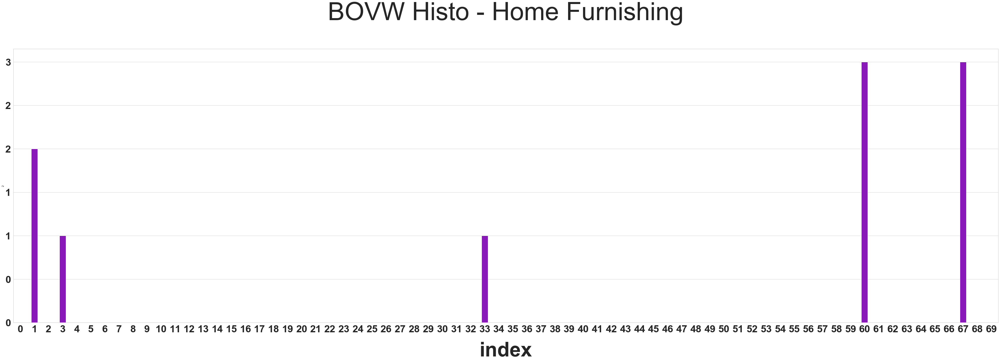

In [208]:
gf.plot_bovw_histo(bovw_corr, 
                   bovw_corr[bovw_corr["category"]=="Home Furnishing"].head(1).index[0], 
                   "BOVW Histo - Home Furnishing", 70, 20)

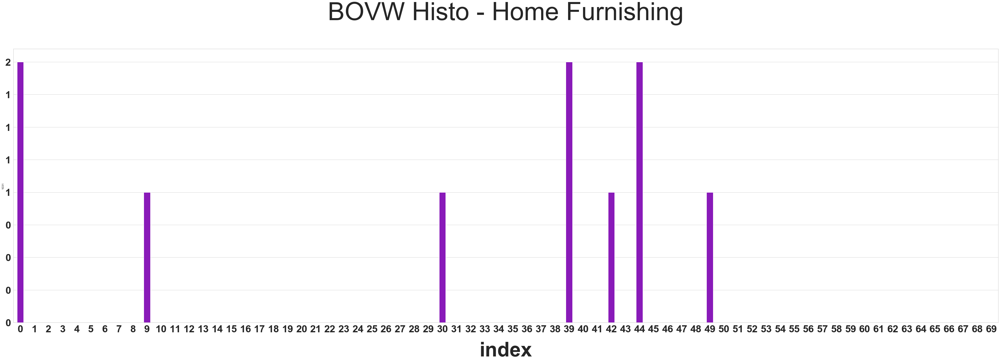

In [209]:
gf.plot_bovw_histo(bovw_corr, 
                   bovw_corr[bovw_corr["category"]=="Home Furnishing"].tail(1).index[0], 
                   "BOVW Histo - Home Furnishing", 70, 20)

**Catégorie "Beauty and Personal Care"**

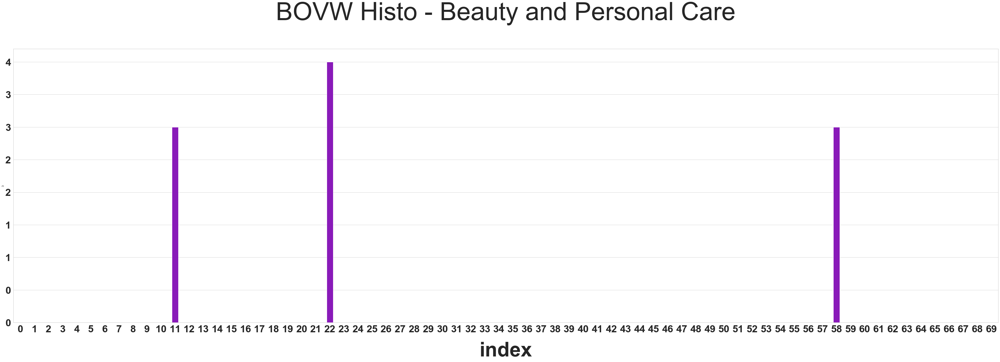

In [210]:
gf.plot_bovw_histo(bovw_corr, 
                   bovw_corr[bovw_corr["category"]=="Beauty and Personal Care"].head(1).index[0], 
                   "BOVW Histo - Beauty and Personal Care", 70, 20)

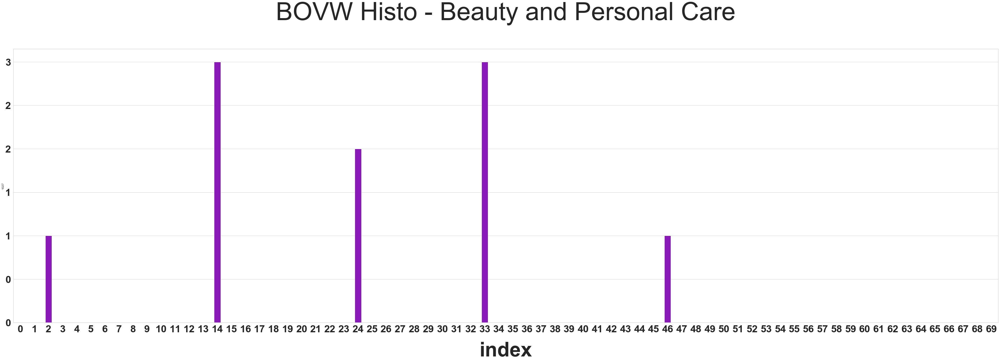

In [211]:
gf.plot_bovw_histo(bovw_corr, 
                   bovw_corr[bovw_corr["category"]=="Beauty and Personal Care"].tail(1).index[0], 
                   "BOVW Histo - Beauty and Personal Care", 70, 20)

**Catégorie "Computers"**

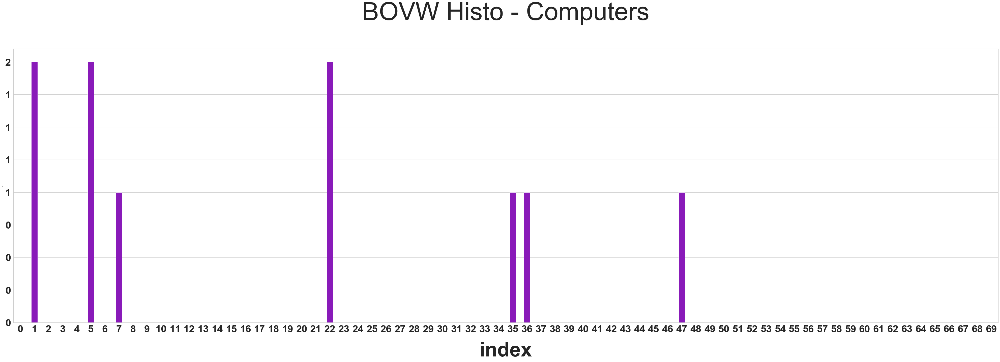

In [212]:
gf.plot_bovw_histo(bovw_corr, 
                   bovw_corr[bovw_corr["category"]=="Computers"].head(1).index[0], 
                   "BOVW Histo - Computers", 70, 20)

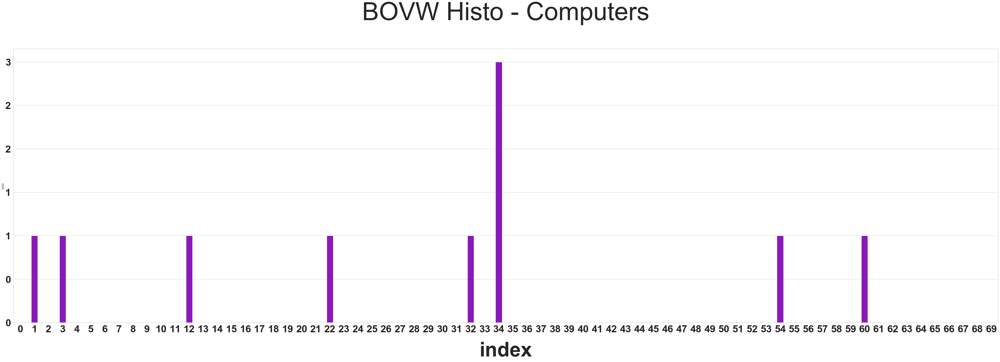

In [213]:
gf.plot_bovw_histo(bovw_corr, 
                   bovw_corr[bovw_corr["category"]=="Computers"].tail(1).index[0], 
                   "BOVW Histo - Computers", 70, 20)

**Catégorie "Home Decor & Festive Needs"**

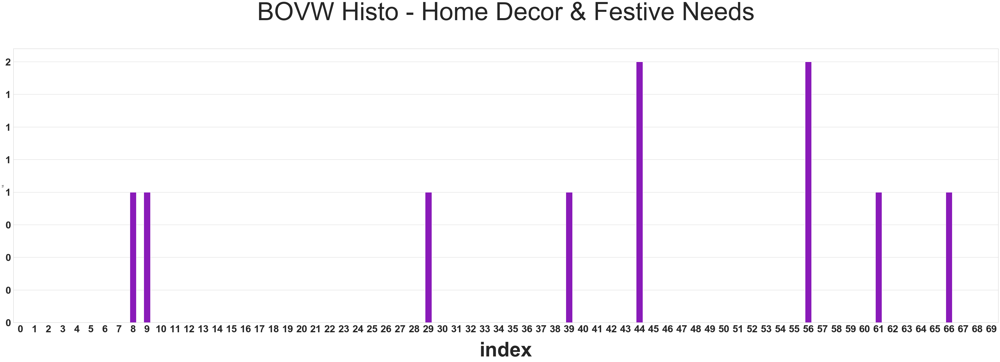

In [214]:
gf.plot_bovw_histo(bovw_corr, 
                   bovw_corr[bovw_corr["category"]=="Home Decor & Festive Needs"].head(1).index[0], 
                   "BOVW Histo - Home Decor & Festive Needs", 70, 20)

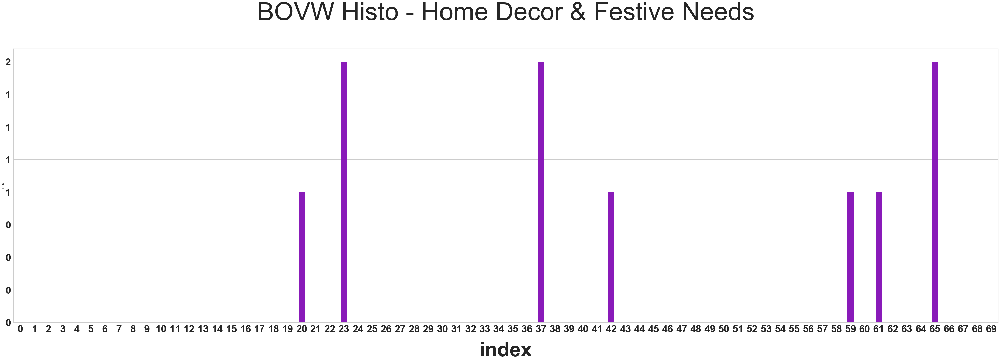

In [215]:
gf.plot_bovw_histo(bovw_corr, 
                   bovw_corr[bovw_corr["category"]=="Home Decor & Festive Needs"].tail(1).index[0], 
                   "BOVW Histo - Home Decor & Festive Needs", 70, 20)

**Catégorie "Baby Care"**

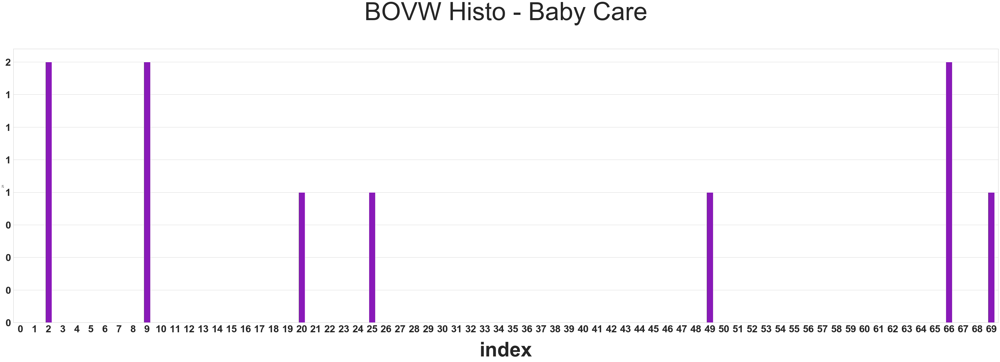

In [216]:
gf.plot_bovw_histo(bovw_corr, 
                   bovw_corr[bovw_corr["category"]=="Baby Care"].head(1).index[0], 
                   "BOVW Histo - Baby Care", 70, 20)

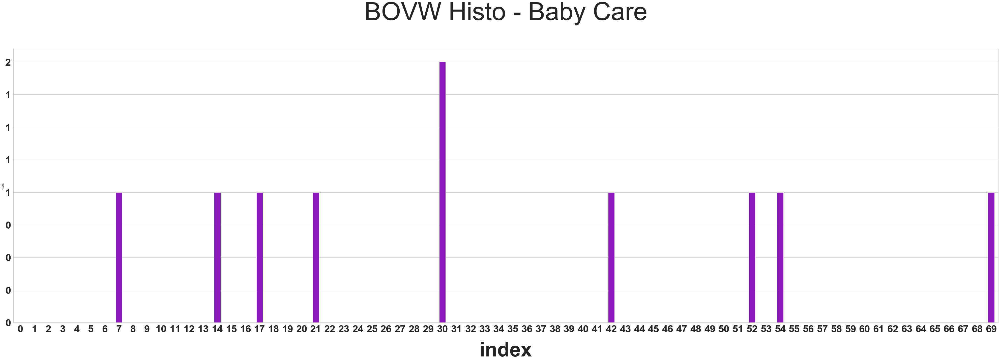

In [217]:
gf.plot_bovw_histo(bovw_corr, 
                   bovw_corr[bovw_corr["category"]=="Baby Care"].tail(1).index[0], 
                   "BOVW Histo - Baby Care", 70, 20)

_<u>Images corrigées + filtrage gaussien</u>_

**Catégorie "Watches"**

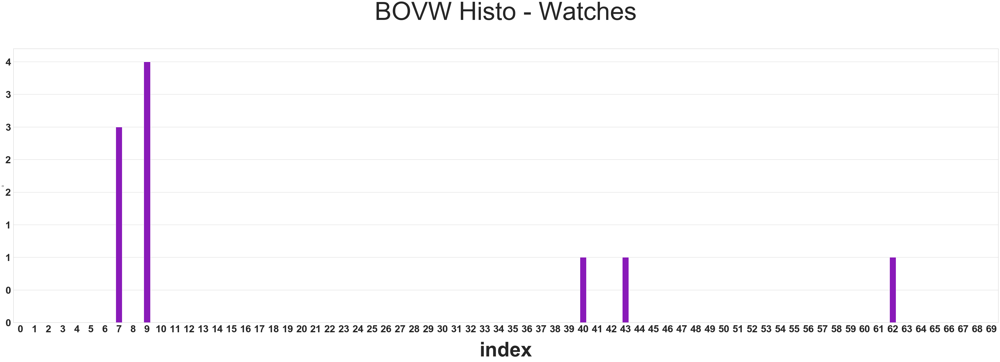

In [218]:
gf.plot_bovw_histo(bovw_gauss, 
                   bovw_gauss[bovw_gauss["category"]=="Watches"].head(1).index[0], 
                   "BOVW Histo - Watches", 70, 20)

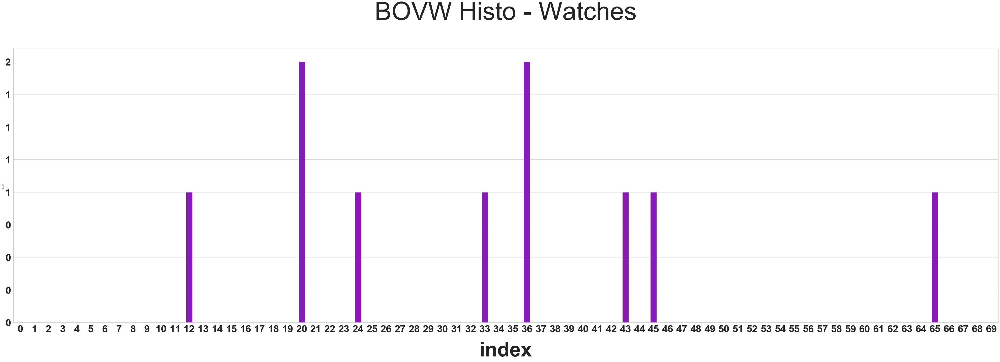

In [219]:
gf.plot_bovw_histo(bovw_gauss, 
                   bovw_gauss[bovw_gauss["category"]=="Watches"].tail(1).index[0], 
                   "BOVW Histo - Watches", 70, 20)

**Catégorie "Kitchen & Dining"**

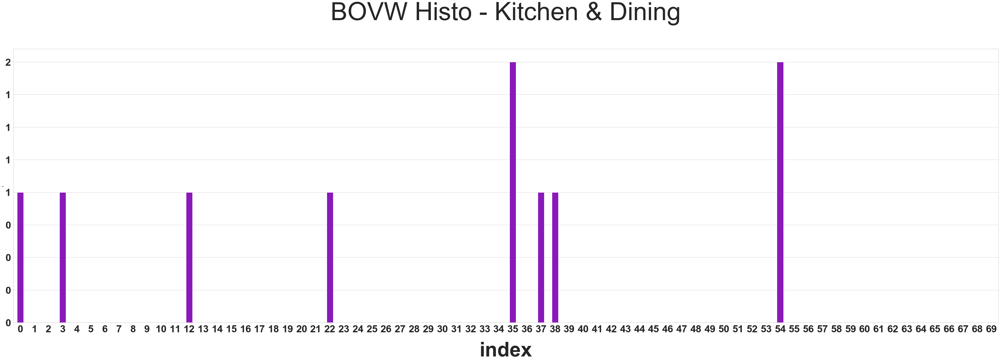

In [220]:
gf.plot_bovw_histo(bovw_gauss, 
                   bovw_gauss[bovw_gauss["category"]=="Kitchen & Dining"].head(1).index[0], 
                   "BOVW Histo - Kitchen & Dining", 70, 20)

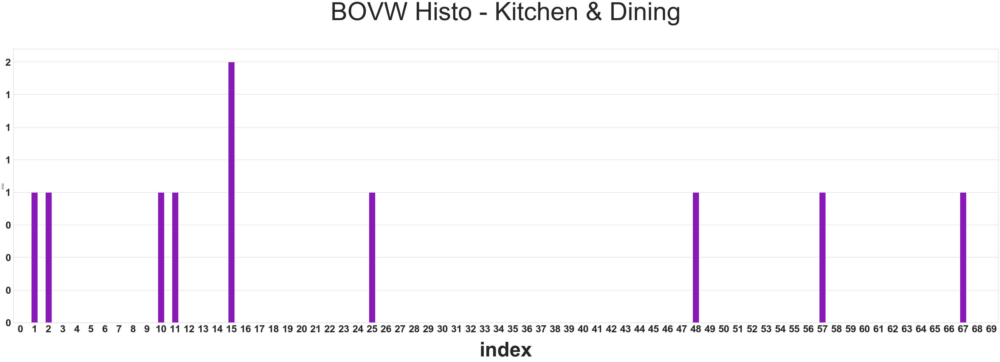

In [221]:
gf.plot_bovw_histo(bovw_gauss, 
                   bovw_gauss[bovw_gauss["category"]=="Kitchen & Dining"].tail(1).index[0], 
                   "BOVW Histo - Kitchen & Dining", 70, 20)

**Catégorie "Home Furnishing"**

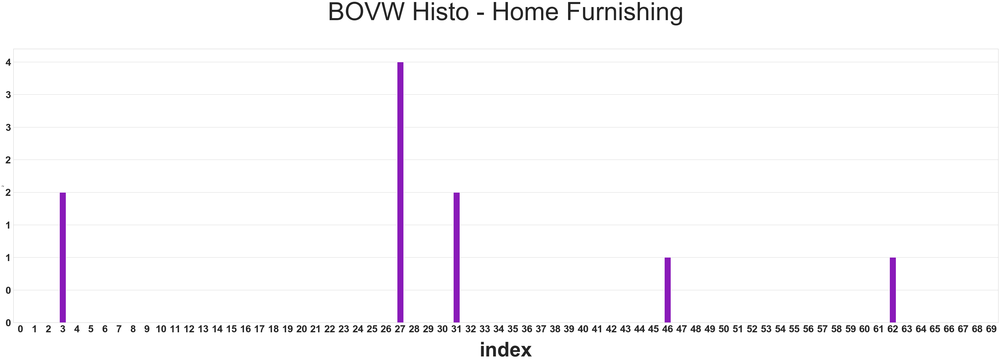

In [222]:
gf.plot_bovw_histo(bovw_gauss, 
                   bovw_gauss[bovw_gauss["category"]=="Home Furnishing"].head(1).index[0], 
                   "BOVW Histo - Home Furnishing", 70, 20)

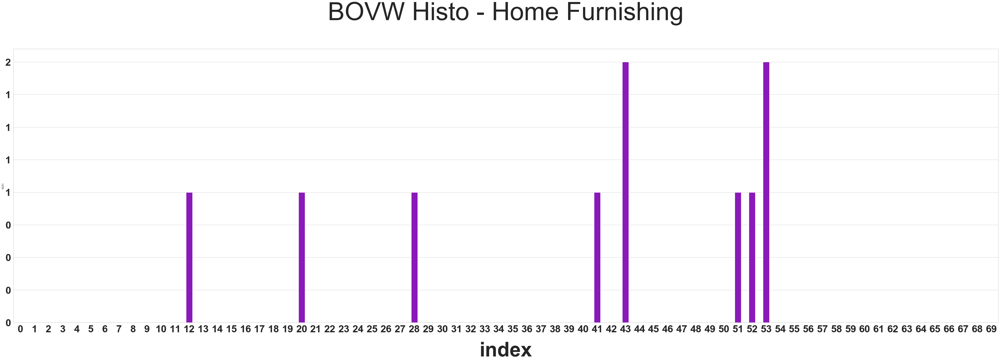

In [223]:
gf.plot_bovw_histo(bovw_gauss, 
                   bovw_gauss[bovw_gauss["category"]=="Home Furnishing"].tail(1).index[0], 
                   "BOVW Histo - Home Furnishing", 70, 20)

**Catégorie "Beauty and Personal Care"**

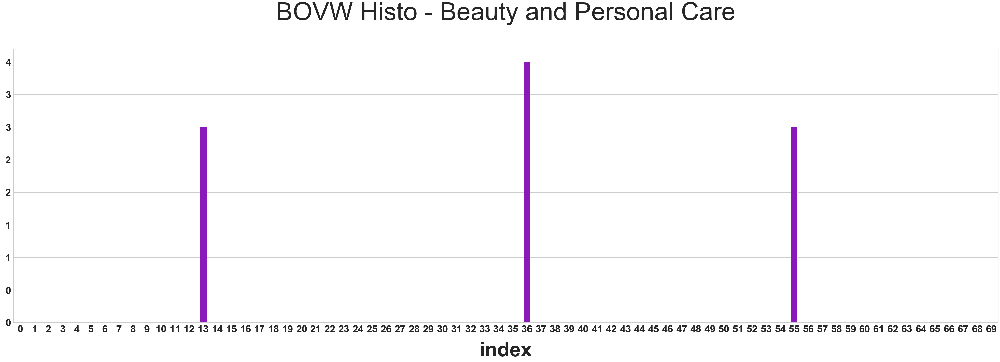

In [224]:
gf.plot_bovw_histo(bovw_gauss, 
                   bovw_gauss[bovw_gauss["category"]=="Beauty and Personal Care"].head(1).index[0], 
                   "BOVW Histo - Beauty and Personal Care", 70, 20)

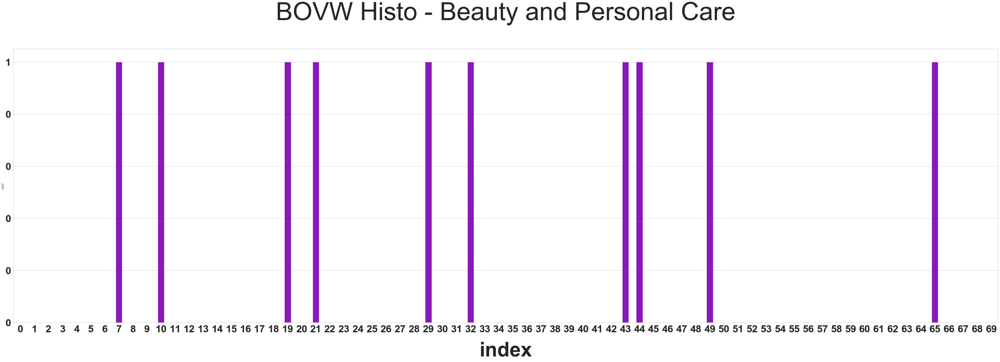

In [225]:
gf.plot_bovw_histo(bovw_gauss, 
                   bovw_gauss[bovw_gauss["category"]=="Beauty and Personal Care"].tail(1).index[0], 
                   "BOVW Histo - Beauty and Personal Care", 70, 20)

**Catégorie "Computers"**

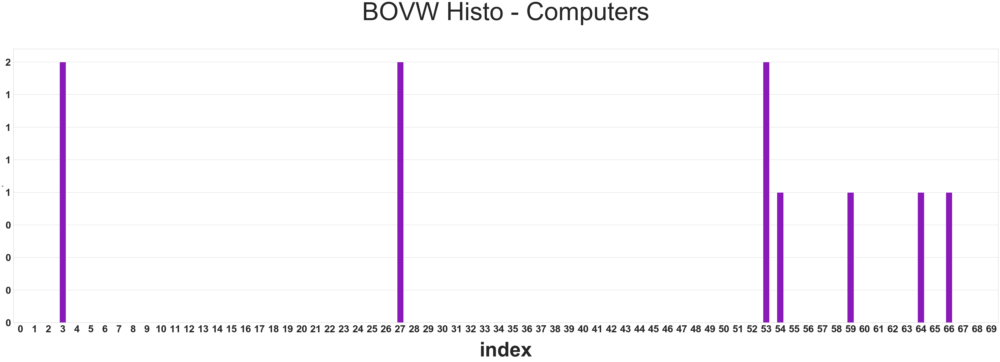

In [226]:
gf.plot_bovw_histo(bovw_gauss, 
                   bovw_gauss[bovw_gauss["category"]=="Computers"].head(1).index[0], 
                   "BOVW Histo - Computers", 70, 20)

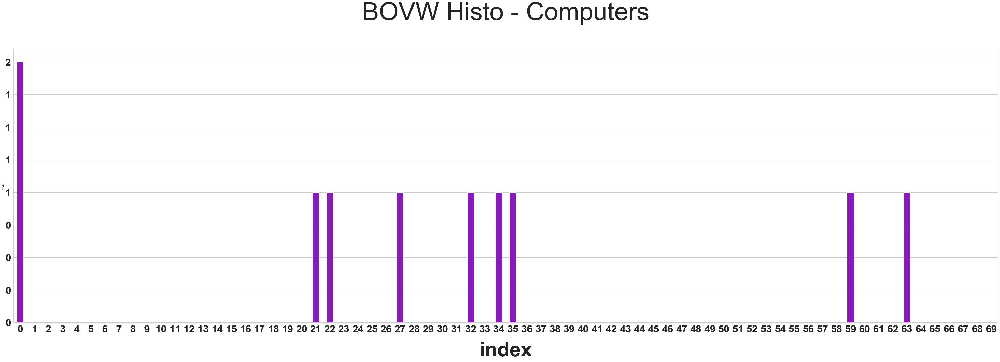

In [227]:
gf.plot_bovw_histo(bovw_gauss, 
                   bovw_gauss[bovw_gauss["category"]=="Computers"].tail(1).index[0], 
                   "BOVW Histo - Computers", 70, 20)

**Catégorie "Home Decor & Festive Needs"**

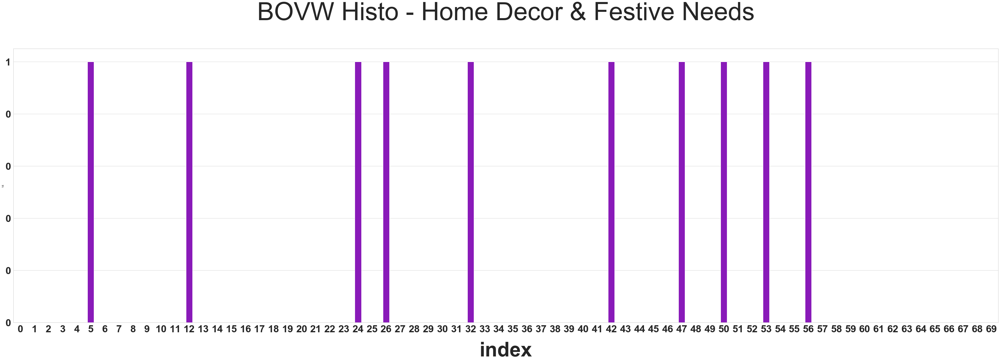

In [228]:
gf.plot_bovw_histo(bovw_gauss, 
                   bovw_gauss[bovw_gauss["category"]=="Home Decor & Festive Needs"].head(1).index[0], 
                   "BOVW Histo - Home Decor & Festive Needs", 70, 20)

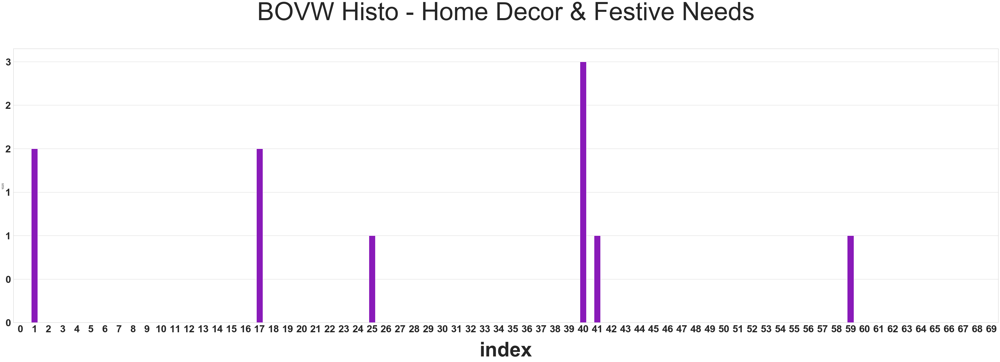

In [229]:
gf.plot_bovw_histo(bovw_gauss, 
                   bovw_gauss[bovw_gauss["category"]=="Home Decor & Festive Needs"].tail(1).index[0], 
                   "BOVW Histo - Home Decor & Festive Needs", 70, 20)

**Catégorie "Baby Care"**

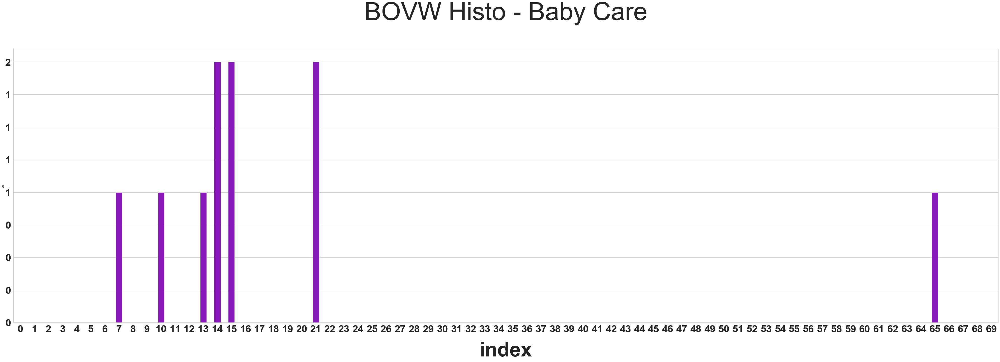

In [230]:
gf.plot_bovw_histo(bovw_gauss, 
                   bovw_gauss[bovw_gauss["category"]=="Baby Care"].head(1).index[0], 
                   "BOVW Histo - Baby Care", 70, 20)

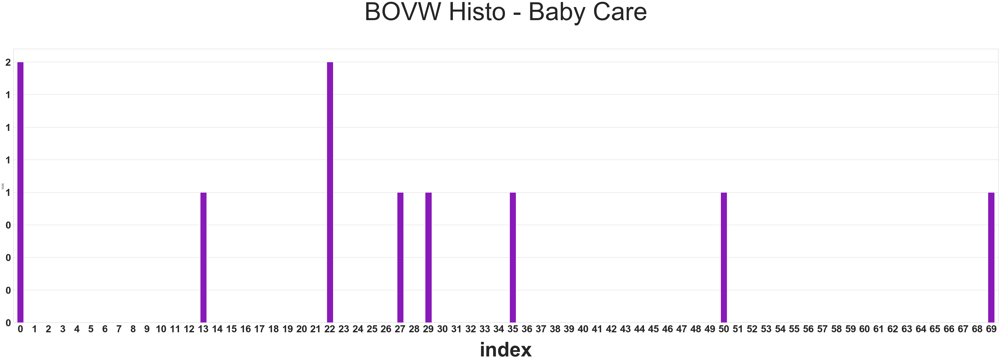

In [231]:
gf.plot_bovw_histo(bovw_gauss, 
                   bovw_gauss[bovw_gauss["category"]=="Baby Care"].tail(1).index[0], 
                   "BOVW Histo - Baby Care", 70, 20)

_<u>Images corrigées + filtrage médian</u>_

**Catégorie "Watches"**

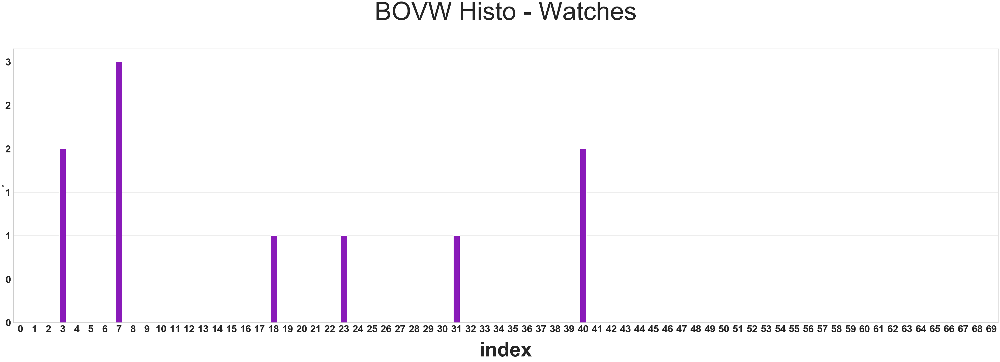

In [232]:
gf.plot_bovw_histo(bovw_med, 
                   bovw_med[bovw_med["category"]=="Watches"].head(1).index[0], 
                   "BOVW Histo - Watches", 70, 20)

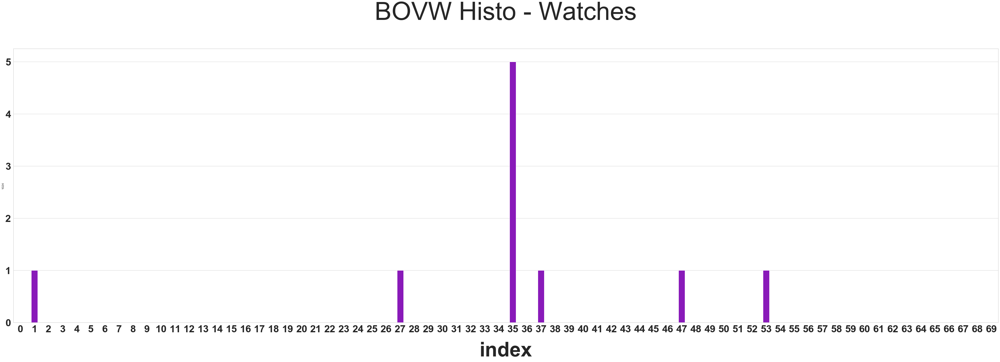

In [233]:
gf.plot_bovw_histo(bovw_med, 
                   bovw_med[bovw_med["category"]=="Watches"].tail(1).index[0], 
                   "BOVW Histo - Watches", 70, 20)

**Catégorie "Kitchen & Dining"**

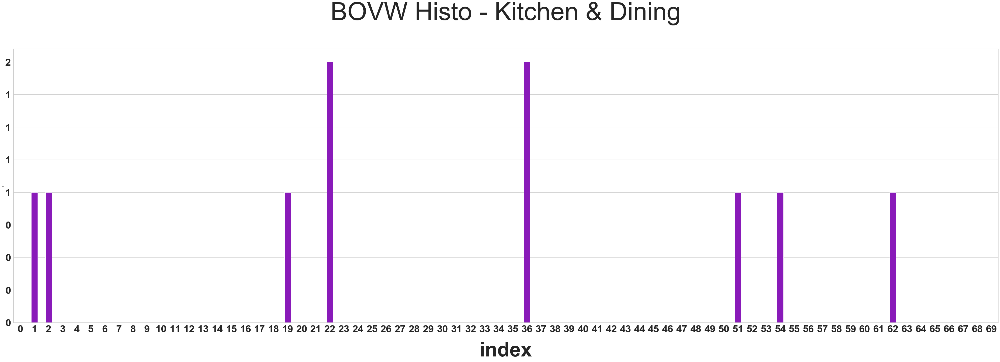

In [234]:
gf.plot_bovw_histo(bovw_med, 
                   bovw_med[bovw_med["category"]=="Kitchen & Dining"].head(1).index[0], 
                   "BOVW Histo - Kitchen & Dining", 70, 20)

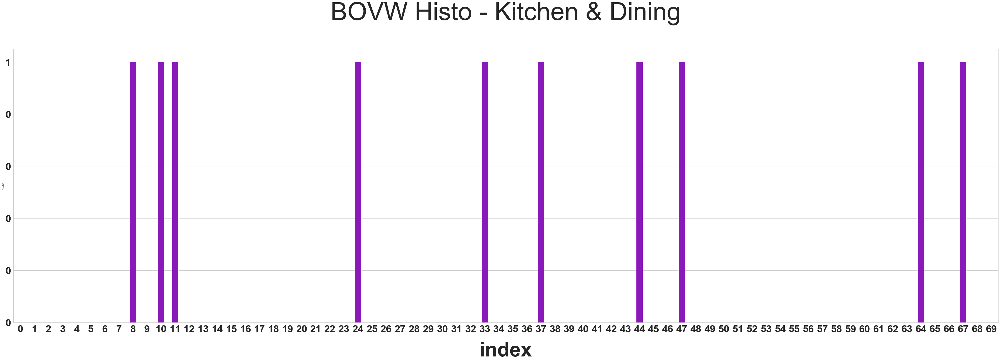

In [235]:
gf.plot_bovw_histo(bovw_med, 
                   bovw_med[bovw_med["category"]=="Kitchen & Dining"].tail(1).index[0], 
                   "BOVW Histo - Kitchen & Dining", 70, 20)

**Catégorie "Home Furnishing"**

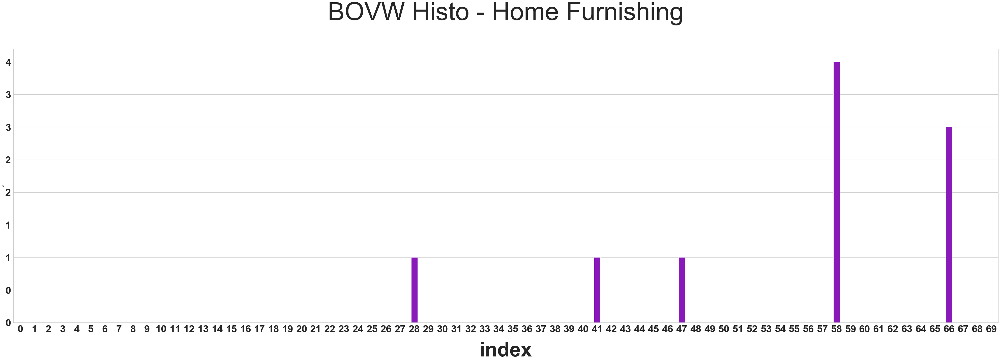

In [236]:
gf.plot_bovw_histo(bovw_med, 
                   bovw_med[bovw_med["category"]=="Home Furnishing"].head(1).index[0], 
                   "BOVW Histo - Home Furnishing", 70, 20)

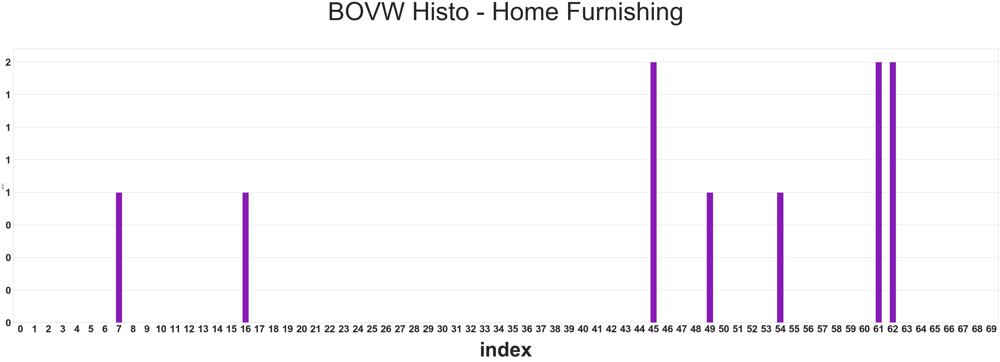

In [237]:
gf.plot_bovw_histo(bovw_med, 
                   bovw_med[bovw_med["category"]=="Home Furnishing"].tail(1).index[0], 
                   "BOVW Histo - Home Furnishing", 70, 20)

**Catégorie "Beauty and Personal Care"**

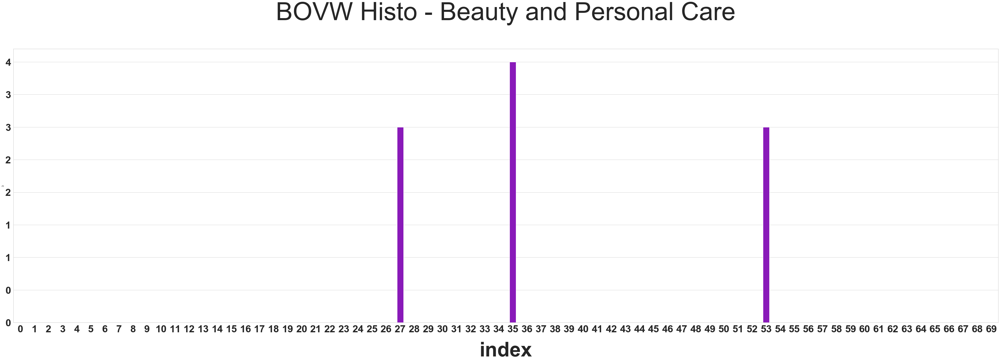

In [238]:
gf.plot_bovw_histo(bovw_med, 
                   bovw_gauss[bovw_gauss["category"]=="Beauty and Personal Care"].head(1).index[0], 
                   "BOVW Histo - Beauty and Personal Care", 70, 20)

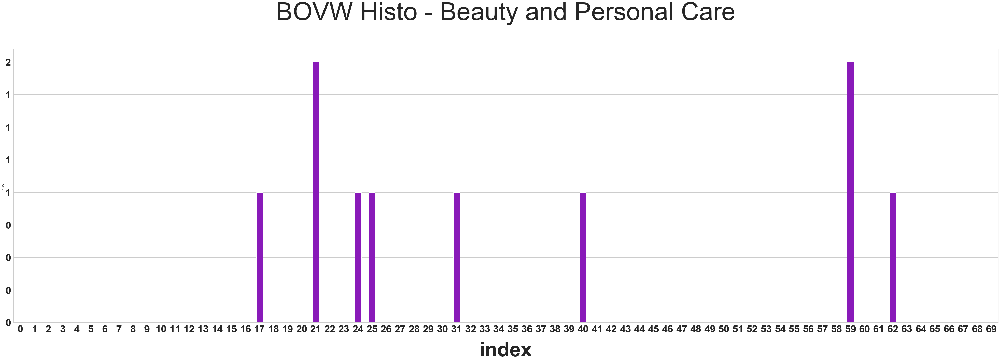

In [239]:
gf.plot_bovw_histo(bovw_med, 
                   bovw_gauss[bovw_gauss["category"]=="Beauty and Personal Care"].tail(1).index[0], 
                   "BOVW Histo - Beauty and Personal Care", 70, 20)

**Catégorie "Computers"**

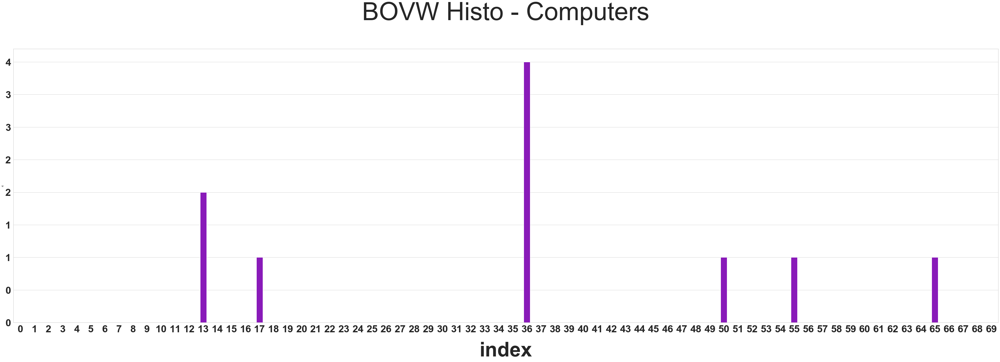

In [240]:
gf.plot_bovw_histo(bovw_med, 
                   bovw_med[bovw_med["category"]=="Computers"].head(1).index[0], 
                   "BOVW Histo - Computers", 70, 20)

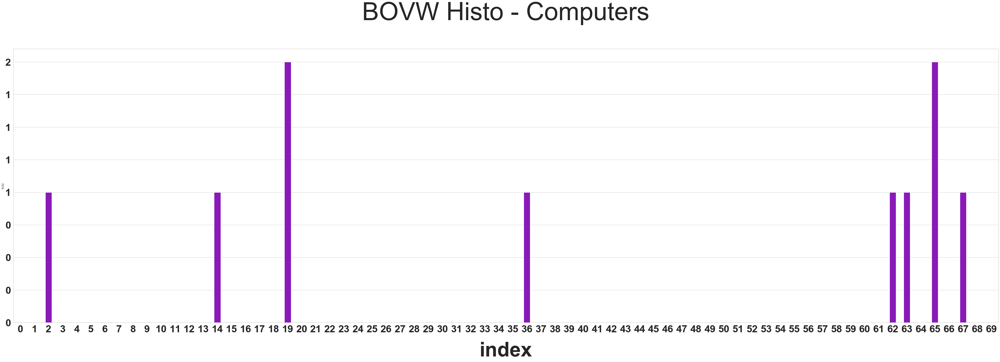

In [241]:
gf.plot_bovw_histo(bovw_med, 
                   bovw_med[bovw_med["category"]=="Computers"].tail(1).index[0], 
                   "BOVW Histo - Computers", 70, 20)

**Catégorie "Home Decor & Festive Needs"**

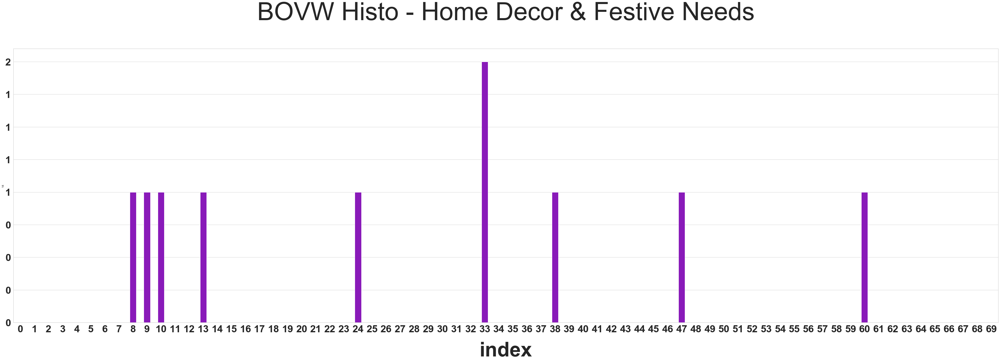

In [242]:
gf.plot_bovw_histo(bovw_med, 
                   bovw_med[bovw_med["category"]=="Home Decor & Festive Needs"].head(1).index[0], 
                   "BOVW Histo - Home Decor & Festive Needs", 70, 20)

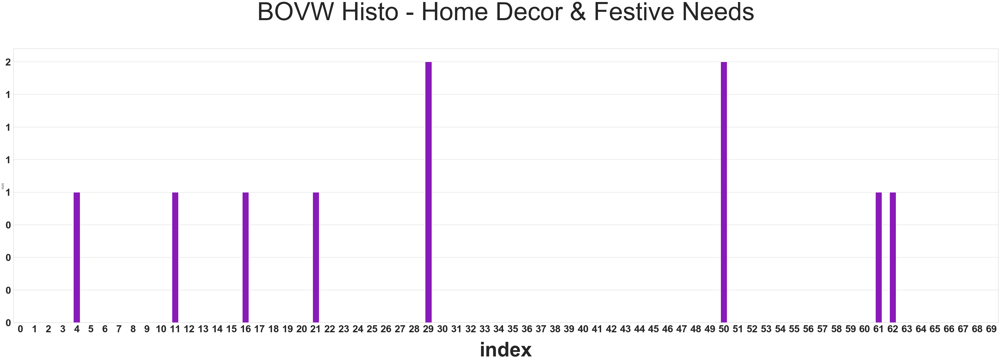

In [243]:
gf.plot_bovw_histo(bovw_med, 
                   bovw_med[bovw_med["category"]=="Home Decor & Festive Needs"].tail(1).index[0], 
                   "BOVW Histo - Home Decor & Festive Needs", 70, 20)

**Catégorie "Baby Care"**

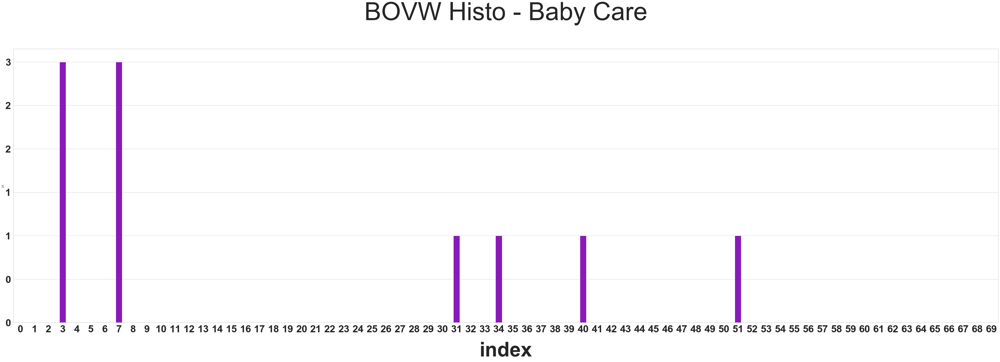

In [244]:
gf.plot_bovw_histo(bovw_med, 
                   bovw_med[bovw_med["category"]=="Baby Care"].head(1).index[0], 
                   "BOVW Histo - Baby Care", 70, 20)

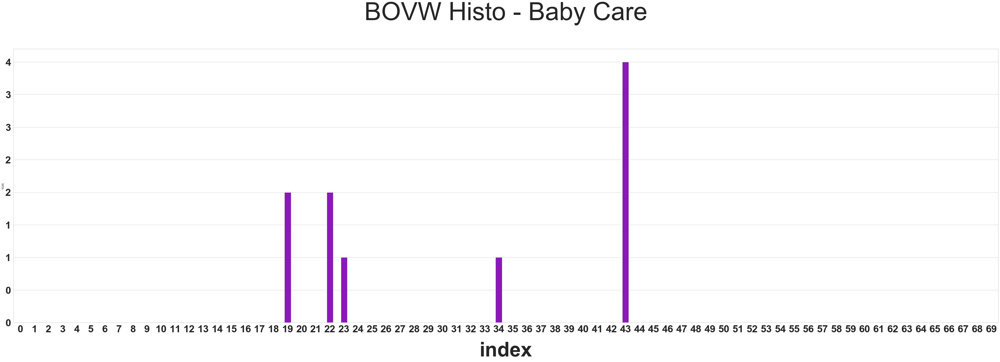

In [245]:
gf.plot_bovw_histo(bovw_med, 
                   bovw_med[bovw_med["category"]=="Baby Care"].tail(1).index[0], 
                   "BOVW Histo - Baby Care", 70, 20)

Sur l'ensemble des jeux d'image, on constate :
- que les histogrammes sont relativement différents entre catégories.
- que les histogrammes sont relativement différents au sein d'une même catégorie.

Cela peut s'expliquer par le fait que les catégories contiennent des objets très disparates.

##### _<u>4.1.4 Tests de prédiction</u>_

On va utiliser l'algorithme KNN, un algorithme généraliste qui donne de bons résultats sur une variété de problèmes.

###### 4.1.4.1 Sur le jeu de données

_<u>Image corrigée</u>_

In [411]:
# Split dataset into training set and test set
X_train, X_test, y_train, y_test = train_test_split(bovw_corr.iloc[:,:-3], 
                                                    bovw_corr.iloc[:,-3], 
                                                    test_size=0.3) # 70% training and 30% test

In [412]:
knn_corr = KNeighborsClassifier(n_neighbors=5)

knn_corr.fit(X_train, y_train)

y_pred = knn_corr.predict(X_test)

In [413]:
print("Accuracy:", accuracy_score(y_test, y_pred))

Accuracy: 0.2032258064516129


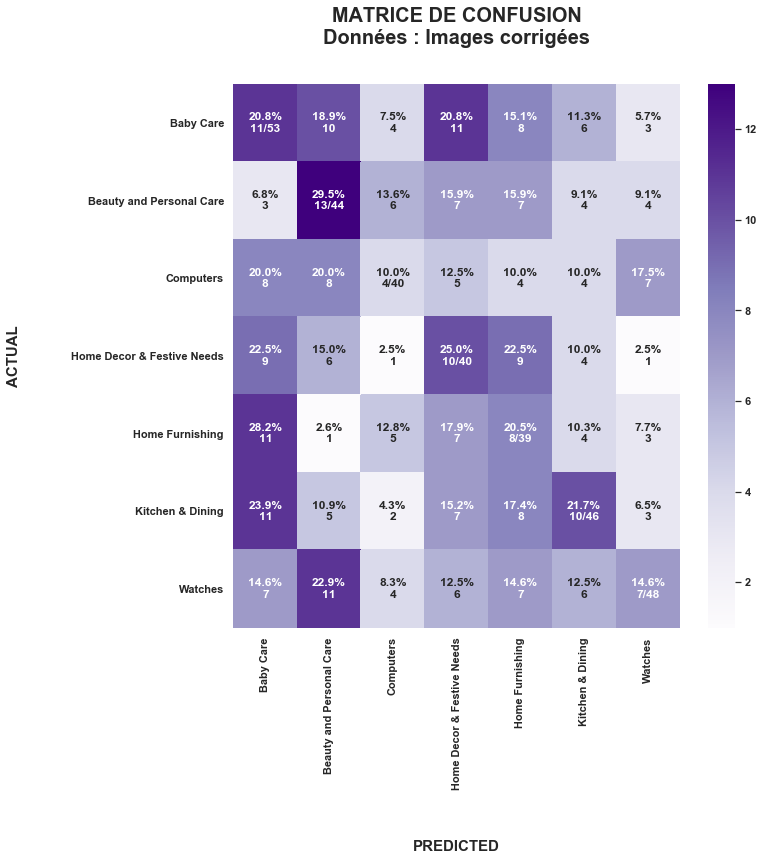

In [414]:
gf.plot_cm(y_test, y_pred, "Images corrigées")

_<u>Image corrigée + filtrage gaussien</u>_

In [415]:
# Split dataset into training set and test set
X_train, X_test, y_train, y_test = train_test_split(bovw_gauss.iloc[:,:-3], 
                                                    bovw_gauss.iloc[:,-3], 
                                                    test_size=0.3) # 70% training and 30% test

In [416]:
knn_gauss = KNeighborsClassifier(n_neighbors=5)

knn_gauss.fit(X_train, y_train)

y_pred = knn_gauss.predict(X_test)

In [417]:
print("Accuracy:", accuracy_score(y_test, y_pred))

Accuracy: 0.267741935483871


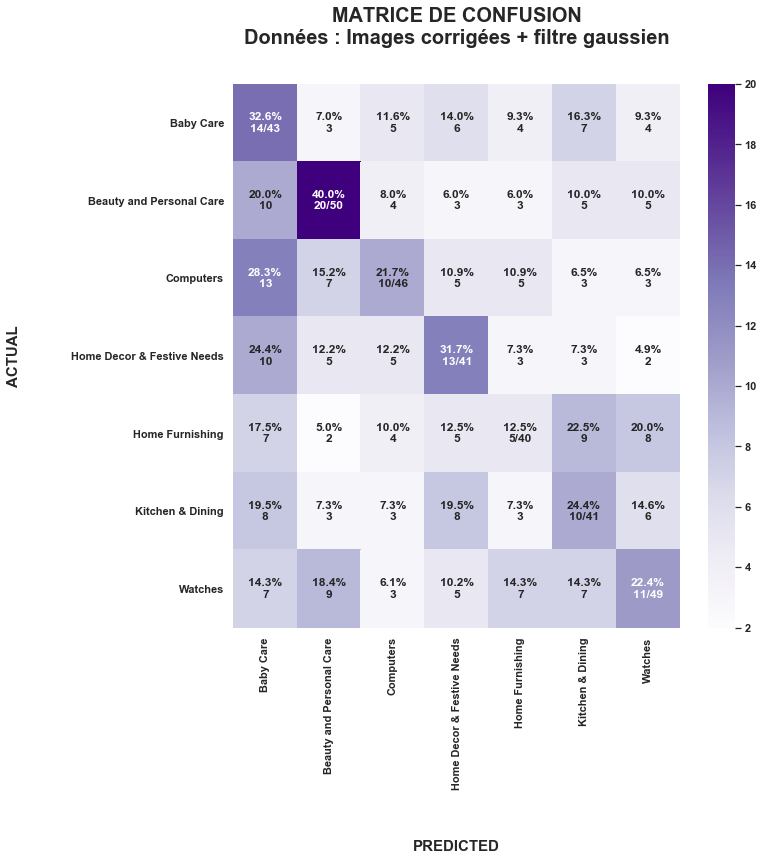

In [418]:
gf.plot_cm(y_test, y_pred, "Images corrigées + filtre gaussien")

_<u>Image corrigée + filtrage médian</u>_

In [419]:
# Split dataset into training set and test set
X_train, X_test, y_train, y_test = train_test_split(bovw_med.iloc[:,:-3], 
                                                    bovw_med.iloc[:,-3], 
                                                    test_size=0.3) # 70% training and 30% test

In [420]:
knn_med = KNeighborsClassifier(n_neighbors=5)

knn_med.fit(X_train, y_train)

y_pred = knn_med.predict(X_test)

In [421]:
print("Accuracy:", accuracy_score(y_test, y_pred))

Accuracy: 0.1935483870967742


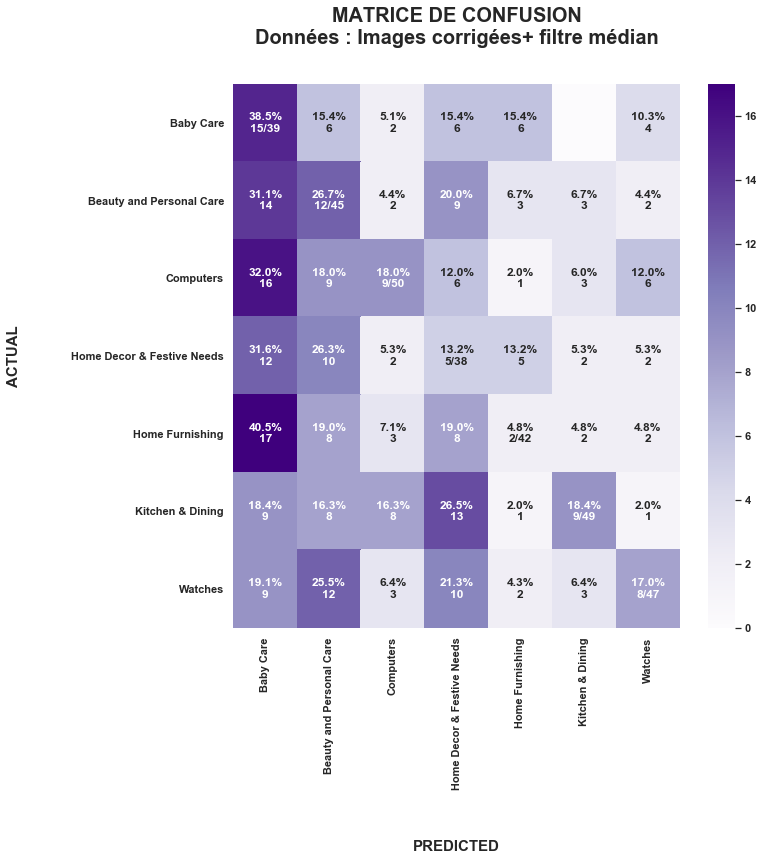

In [422]:
gf.plot_cm(y_test, y_pred, "Images corrigées+ filtre médian")

###### 4.1.4.2 Sur un produit hors du jeu de données

Le modèle utilisant les images corrigées + filtrage gaussien en entrée ayant fourni la meilleure accuracy, nous utiliserons ces données en entrée pour notre modèle.

On commence par fit le classifieur sur l'ensemble des données.

In [423]:
knn_gauss = KNeighborsClassifier(n_neighbors=5)
knn_gauss.fit(bovw_gauss.iloc[:,:-3], bovw_gauss.iloc[:,-3])

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=5, p=2,
                     weights='uniform')

In [424]:
predicted = hf.predictWithImage("./Resources/pictures_test/test_picture.jpg",
                                visual_words_gauss,
                                knn_gauss)

In [425]:
proba_pred = pd.DataFrame(columns=np.sort(products.category.unique()), 
                          data=predicted[1]*100).T.rename(columns={0:'proba(%)'})


In [426]:
proba_pred

,proba(%)
Baby Care,20.0
Beauty and Personal Care,0.0
Computers,60.0
Home Decor & Festive Needs,20.0
Home Furnishing,0.0
Kitchen & Dining,0.0
Watches,0.0


La catégorie majoritaire est "Computers", avec une probabilité de 60%, soit un delta minimal de 40% avec les autres catégories.

La catégorie prédite est correcte.

##### _<u>4.1.5 Conclusion</u>_

On obtient les accuracies suivantes :
- pour l'image corrigée : 20%
- pour l'image corrigée + filtre gaussien : 27%
- pour l'image corrigée + filtre médian : 19%

La meilleure accuracy est donc obtenue à partir du modèle prenant en entrée les images corrigée, puis filtrées avec un filtre gaussien. 
L'accuracy de 27% obtenue est  bien supérieure à celle d'une baseline qui assignerait aléatoirement les catégories et aurait donc une accuracy de 1/7 = 14% environ.

Voyons si une modélidation basée sur les données texte donne de meilleurs résultats.

___
#### 4.2 À PARTIR DES DONNÉES TEXTE

##### _<u>4.2.1 Obtention des features</u>_

Nous allons considérer l'ensemble des mots pour chaque produit.

In [262]:
FEATURE = "all_words"

Dans le cas de données texte, 2 grandes transformations existent pour obtenir des features exploitables par un modèle de machine learning :
- la transformation en matrice Bag ofWords (BOW)
- la transformation en matrice Term Frequency - Inverse Document Frequency (TF-IDF)

Nous allons comparer les résultats obtenus avec chacune de ces transformations.

###### 4.2.1.1 Transformation en matrice BOW

In [263]:
token = nltk.RegexpTokenizer(r'[a-zA-Z]+')

count_vect = CountVectorizer(lowercase=True, 
                     stop_words='english',
                     ngram_range = (1,1),
                     tokenizer = token.tokenize)

text_bow = count_vect.fit_transform(products[FEATURE].astype("str"))

text_bow_df = pd.DataFrame(text_bow.toarray())

###### 4.2.1.2 Transformation en matrice TF-IDF

In [264]:
tf = TfidfVectorizer(lowercase=True, 
                     stop_words='english',
                     ngram_range=(1,1),
                     tokenizer=token.tokenize)

text_tf = tf.fit_transform(products[FEATURE].astype("str"))

text_tf_df = pd.DataFrame(text_tf.toarray())

##### _<u>4.2.2 Réduction dimensionelle</u>_

Les matrices BOW et TF-IDF donnent des matrices creuses et imposantes. 

Une réduction dimensionnelle pourra aider à "condenser" ces matrices en faisant ressortir de nouvelles features qui "résumeront" les features initiales. 

Cela nous permettra de visualiser ces jeux de données, tout en réduisant les temps de calcul.

Nous testerons ici 3 approches sur chacun des jeux de données :
- Analyse en Composantes Principales (ACP)
- t-distributed stochastic neighbor embedding (t-SNE)
    * t-SNE simple
    * t-SNE initialisée par une ACP

###### 4.2.2.1 ACP

_<u>Données Bag of Words</u>_

In [306]:
N_COMPONENTS = 170

In [307]:
pca = decomposition.PCA(n_components=N_COMPONENTS)
pca_results_bow = pca.fit_transform(text_bow_df)

In [308]:
print('Explained variation per 6 first principal components: \n\n{}\n'\
      .format(pca.explained_variance_ratio_[:6]))

print('Cumulative explained variation for {} principal components: {}'\
      .format(N_COMPONENTS, np.sum(pca.explained_variance_ratio_)))

Explained variation per 6 first principal components: 

[0.06140623 0.04800497 0.04043681 0.02738498 0.0236299  0.02014207]

Cumulative explained variation for 170 principal components: 0.800220325481549


Éboulis des valeurs propres

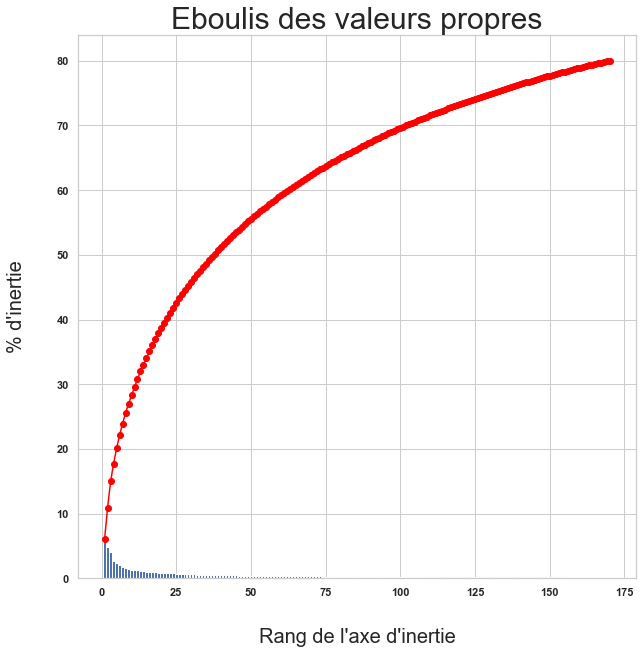

In [309]:
gf.display_scree_plot(pca)

Au total, ces 170 composantes expliquent plus de 80% de la variance observées dans les données, en utilisant donc moins de 4% des dimensions initiales.

_Mise en évidence variables latentes expliquant les données_

Les 6 premiers axes représentent plus de 20% de la variation totale. 

Regardons cela plus en détails afin de voir s'il est possible de trouver des variables latentes qui pourraient expliquer les données:

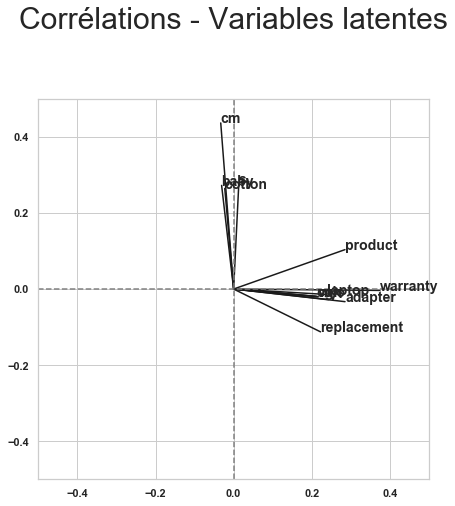

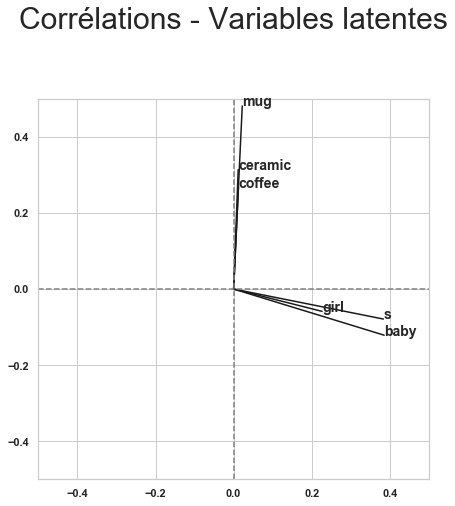

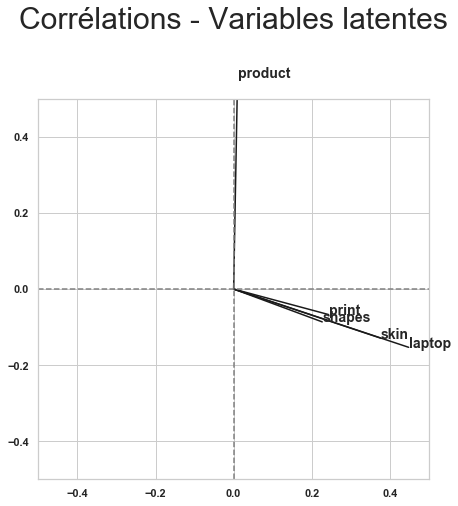

In [310]:
gf.plot_correlation_circle(pca.components_, count_vect.get_feature_names(), 7, 7)

Les mots qui ressortent ont trait :
- 1ère composante : aux ordinateurs et appareils électroniques
> **Appartenance à la catégorie Computers**
- 2ème composante : aux accessoirespour bébés
> **Appartenance à la catégorie Baby Care**
- 3ème composante : aux vêtements pour bébés
> **Appartenance à la catégorie Baby Care**
- 4ème composante : aux tasses en céramiques et à la taille
> **Appartenance à la catégorie Kitchen & Dining**
- 5ème composante : aux montres
> **Appartenance à la catégorie Computers**
- 6ème composante : à tous les produits
> **Aucune catégorie particulière**

3 catégories sur 7 ressortent particulièrement.

_<u>Données TF-IDF</u>_

In [317]:
N_COMPONENTS = 420

In [318]:
pca = decomposition.PCA(n_components=N_COMPONENTS)
pca_results_tf = pca.fit_transform(text_tf_df)

In [319]:
print('Explained variation per 6 first principal components: \n\n{}\n'\
      .format(pca.explained_variance_ratio_[:6]))

print('Cumulative explained variation for {} principal components: {}'\
      .format(N_COMPONENTS, np.sum(pca.explained_variance_ratio_)))

Explained variation per 6 first principal components: 

[0.02610681 0.02111847 0.01867901 0.01448916 0.01335466 0.01300871]

Cumulative explained variation for 420 principal components: 0.8024480322762255


Éboulis des valeurs propres

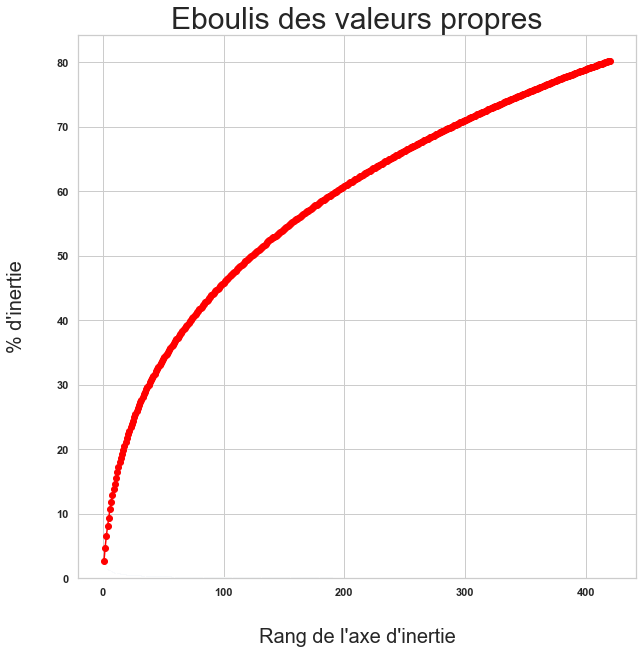

In [320]:
gf.display_scree_plot(pca)

Au total, ces 420 composantes expliquent plus de 80% de la variance observées dans les données, en utilisant donc moins de 10% des dimensions initiales.

_Mise en évidence variables latentes expliquant les données_

Les 6 premiers axes représentent plus de 10% de la variation totale. 

Regardons cela plus en détails afin de voir s'il est possible de trouver des variables latentes qui pourraient expliquer les données:

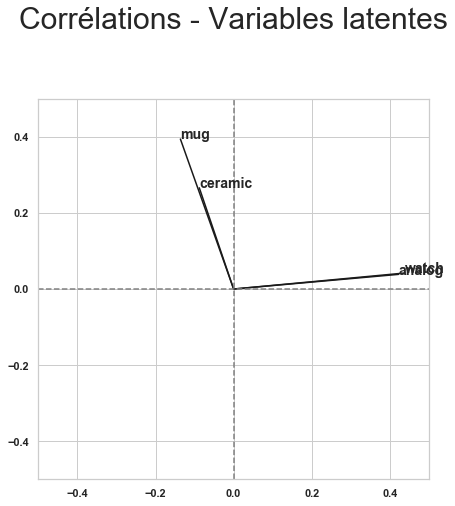

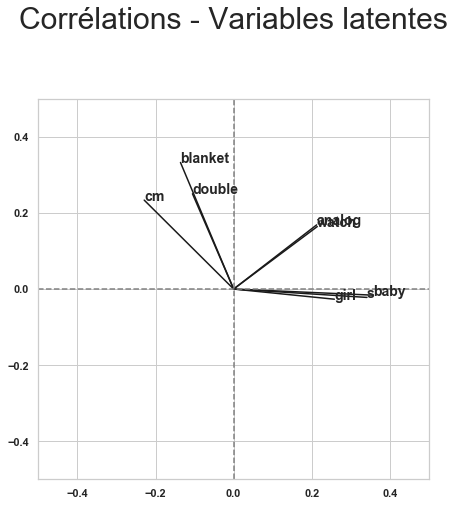

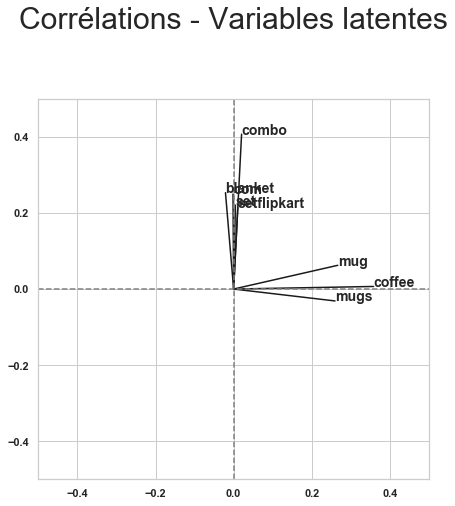

In [321]:
gf.plot_correlation_circle(pca.components_, tf.get_feature_names(), 7, 7)

Les mots qui ressortent sont :
- 1ère composante : aux montres
> **Appartenance à la catégorie 1 "Watches"**
- 2ème composante : aux tasses en céramique
> **Appartenance à la catégorie 1 "Kitchen & Dining"**
- 3ème composante : aux articles pour bébés et aux montres
> **Appartenance à la catégorie 1 "Baby Care" ou "Watches"**
- 4ème composante : aux couvertures
> **Appartenance à la catégorie 1 "Home Furnishing"**
- 5ème composante : aux tasses
> **Appartenance à la catégorie 1 "Kitchen & Dining"**
- 6ème composante : aux couvertures
> **Appartenance à la catégorie 1 "Home Furnishing"**

4 catégories sur 7 ressortent particulièrement.

###### 4.2.2.2 t-SNE

_<u>Données Bag of Words</u>_

**t-SNE seule**

In [322]:
time_start = time.time()

tsne = manifold.TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results_bow = tsne.fit_transform(text_bow_df)

print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1049 samples in 0.280s...
[t-SNE] Computed neighbors for 1049 samples in 13.654s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1049
[t-SNE] Computed conditional probabilities for sample 1049 / 1049
[t-SNE] Mean sigma: 3.388216
[t-SNE] KL divergence after 250 iterations with early exaggeration: 80.841866
[t-SNE] KL divergence after 300 iterations: 1.121366
t-SNE done! Time elapsed: 15.163556098937988 seconds


**t-SNE initialisée avec ACP**

Initialiser l’algorithme t-SNE par une ACP avant de le lancer permet de conserver un peu plus de la structure globale.

In [323]:
time_start = time.time()

tsne = manifold.TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_pca_results_bow = tsne.fit_transform(pca_results_bow)

print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1049 samples in 0.005s...
[t-SNE] Computed neighbors for 1049 samples in 0.326s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1049
[t-SNE] Computed conditional probabilities for sample 1049 / 1049
[t-SNE] Mean sigma: 2.436716
[t-SNE] KL divergence after 250 iterations with early exaggeration: 66.024208
[t-SNE] KL divergence after 300 iterations: 0.746198
t-SNE done! Time elapsed: 1.3369081020355225 seconds


_<u>Données TF-IDF</u>_

**t-SNE seule**

In [324]:
time_start = time.time()

tsne = manifold.TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results_tf = tsne.fit_transform(text_tf_df)

print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1049 samples in 0.257s...
[t-SNE] Computed neighbors for 1049 samples in 13.399s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1049
[t-SNE] Computed conditional probabilities for sample 1049 / 1049
[t-SNE] Mean sigma: 0.390863
[t-SNE] KL divergence after 250 iterations with early exaggeration: 67.846924
[t-SNE] KL divergence after 300 iterations: 0.967807
t-SNE done! Time elapsed: 14.614399909973145 seconds


**t-SNE initialisée avec ACP**

Initialiser l’algorithme t-SNE par une ACP avant de le lancer permet de conserver un peu plus de la structure globale.

In [325]:
time_start = time.time()

tsne = manifold.TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_pca_results_tf = tsne.fit_transform(pca_results_tf)

print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1049 samples in 0.012s...
[t-SNE] Computed neighbors for 1049 samples in 0.738s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1049
[t-SNE] Computed conditional probabilities for sample 1049 / 1049
[t-SNE] Mean sigma: 0.428565
[t-SNE] KL divergence after 250 iterations with early exaggeration: 77.222397
[t-SNE] KL divergence after 300 iterations: 1.132889
t-SNE done! Time elapsed: 1.7789340019226074 seconds


###### 4.2.2.3 Comparaison

In [326]:
data_bow = pd.DataFrame()
data_tf_idf = pd.DataFrame()

# Data from BOW
data_bow['pca-one-bow'] = pca_results_bow[:, 0]
data_bow['pca-two-bow'] = pca_results_bow[:, 1]

data_bow['tsne-one-bow'] = tsne_results_bow[:, 0]
data_bow['tsne-two-bow'] = tsne_results_bow[:, 1]

data_bow['pca-tsne-one-bow'] = tsne_pca_results_bow[:, 0]
data_bow['pca-tsne-two-bow'] = tsne_pca_results_bow[:, 1]

data_bow = pd.concat([data_bow, products[["category"]]], axis=1)

# Data from TF-IDF
data_tf_idf['pca-one-tf'] = pca_results_tf[:, 0]
data_tf_idf['pca-two-tf'] = pca_results_tf[:, 1]

data_tf_idf['tsne-one-tf'] = tsne_results_tf[:, 0]
data_tf_idf['tsne-two-tf'] = tsne_results_tf[:, 1]

data_tf_idf['pca-tsne-one-tf'] = tsne_pca_results_tf[:, 0]
data_tf_idf['pca-tsne-two-tf'] = tsne_pca_results_tf[:, 1]

data_tf_idf = pd.concat([data_tf_idf, products[["category"]]], axis=1)

Text(0, 0.5, 'PCA-t-SNE 2 - TF')

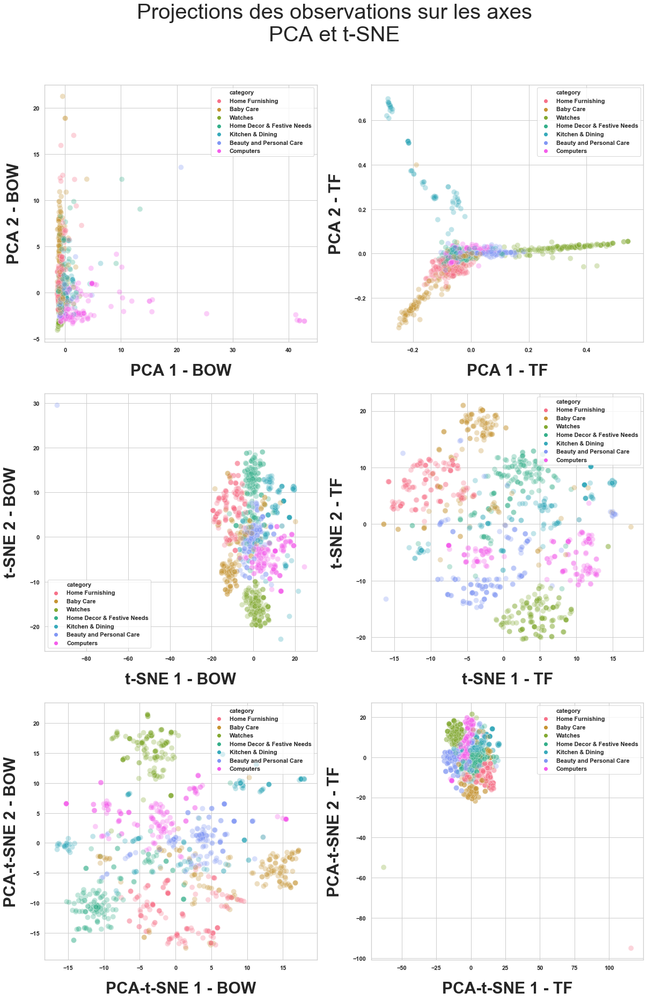

In [327]:
TITLE_SIZE = 40
TITLE_PAD = 0.95
LABEL_SIZE = 30
LABEL_PAD = 20

sns.set_palette(sns.husl_palette(len(products.category.unique())))

fig, axes = plt.subplots(3, 2, figsize=(20, 30))

fig.suptitle("Projections des observations sur les axes\nPCA et t-SNE", fontsize=TITLE_SIZE, y=TITLE_PAD)

# Data for BOW
ax1 = axes[0, 0]
handle_plot_1 = sns.scatterplot(x="pca-one-bow", y="pca-two-bow",
                                data=data_bow,
                                legend="full",
                                hue="category",
                                alpha=0.3, 
                                s=100,
                                ax=ax1)

handle_plot_1.set_xlabel("PCA 1 - BOW",
                         fontsize=LABEL_SIZE,
                         labelpad=LABEL_PAD,
                         fontweight="bold")

handle_plot_1.set_ylabel("PCA 2 - BOW",
                         fontsize=LABEL_SIZE,
                         labelpad=LABEL_PAD,
                         fontweight="bold")


ax2 = axes[1, 0]
handle_plot_2 = sns.scatterplot(x="tsne-one-bow", y="tsne-two-bow",
                                data=data_bow,
                                legend="full",
                                hue="category",
                                alpha=0.3, 
                                s=100,
                                ax=ax2)

handle_plot_2.set_xlabel("t-SNE 1 - BOW",
                         fontsize=LABEL_SIZE,
                         labelpad=LABEL_PAD,
                         fontweight="bold")

handle_plot_2.set_ylabel("t-SNE 2 - BOW",
                         fontsize=LABEL_SIZE,
                         labelpad=LABEL_PAD,
                         fontweight="bold")

ax3 = axes[2, 0]
handle_plot_2 = sns.scatterplot(x="pca-tsne-one-bow", y="pca-tsne-two-bow",
                                data=data_bow,
                                legend="full",
                                hue="category",
                                alpha=0.3,
                                s=100,
                                ax=ax3)

handle_plot_2.set_xlabel("PCA-t-SNE 1 - BOW",
                         fontsize=LABEL_SIZE,
                         labelpad=LABEL_PAD,
                         fontweight="bold")

handle_plot_2.set_ylabel("PCA-t-SNE 2 - BOW",
                         fontsize=LABEL_SIZE,
                         labelpad=LABEL_PAD,
                         fontweight="bold")

# Data for TFIDF
ax4 = axes[0, 1]
handle_plot_1 = sns.scatterplot(x="pca-one-tf", y="pca-two-tf",
                                data=data_tf_idf,
                                legend="full",
                                hue="category",
                                alpha=0.3,
                                s=100,
                                ax=ax4)

handle_plot_1.set_xlabel("PCA 1 - TF",
                         fontsize=LABEL_SIZE,
                         labelpad=LABEL_PAD,
                         fontweight="bold")

handle_plot_1.set_ylabel("PCA 2 - TF",
                         fontsize=LABEL_SIZE,
                         labelpad=LABEL_PAD,
                         fontweight="bold")


ax5 = axes[1, 1]
handle_plot_2 = sns.scatterplot(x="tsne-one-tf", y="tsne-two-tf",
                                data=data_tf_idf,
                                hue="category",
                                legend="full",
                                alpha=0.3,
                                s=100,
                                ax=ax5)

handle_plot_2.set_xlabel("t-SNE 1 - TF",
                         fontsize=LABEL_SIZE,
                         labelpad=LABEL_PAD,
                         fontweight="bold")

handle_plot_2.set_ylabel("t-SNE 2 - TF",
                         fontsize=LABEL_SIZE,
                         labelpad=LABEL_PAD,
                         fontweight="bold")

ax6 = axes[2, 1]
handle_plot_2 = sns.scatterplot(x="pca-tsne-one-tf", y="pca-tsne-two-tf",
                                data=data_tf_idf,
                                hue="category",
                                legend="full",
                                alpha=0.3,
                                s=100,
                                ax=ax6)

handle_plot_2.set_xlabel("PCA-t-SNE 1 - TF",
                         fontsize=LABEL_SIZE,
                         labelpad=LABEL_PAD,
                         fontweight="bold")

handle_plot_2.set_ylabel("PCA-t-SNE 2 - TF",
                         fontsize=LABEL_SIZE,
                         labelpad=LABEL_PAD,
                         fontweight="bold")

t-SNE TF-IDF propose la visualisation avec la plus grande variance, avec les catégories les mieux regroupées. C'est donc ces données que nous conserverons pour le clustering.

##### _<u>4.2.3 Clustering</u>_

In [328]:
data_clustering = data_tf_idf[['tsne-one-tf', 'tsne-two-tf']].copy()

On va utiliser l'algorithme KMeans, un algorithme généraliste qui donne de bons résultats sur une variété de problèmes.

###### 4.2.3.1. Création du modèle

_<u>Choix du nombre de clusters a priori</u>_

L'algorithme du KMeans demande un nombre de clusters en paramètres.

Ce nombre optimal a priori pour un jeu de données donné peut être déterminé par plusieurs méthodes, notamment : 
- l'observation du dendrogramme des données
- la méthode du coefficient moyen de silhouette

Le nombre de catégories étant de 7, nous savons ici que, pour une modélisation réussie, c'est ce nombre qui devrait ressortir et qui doit être utilisé.

>**Dendrogramme**

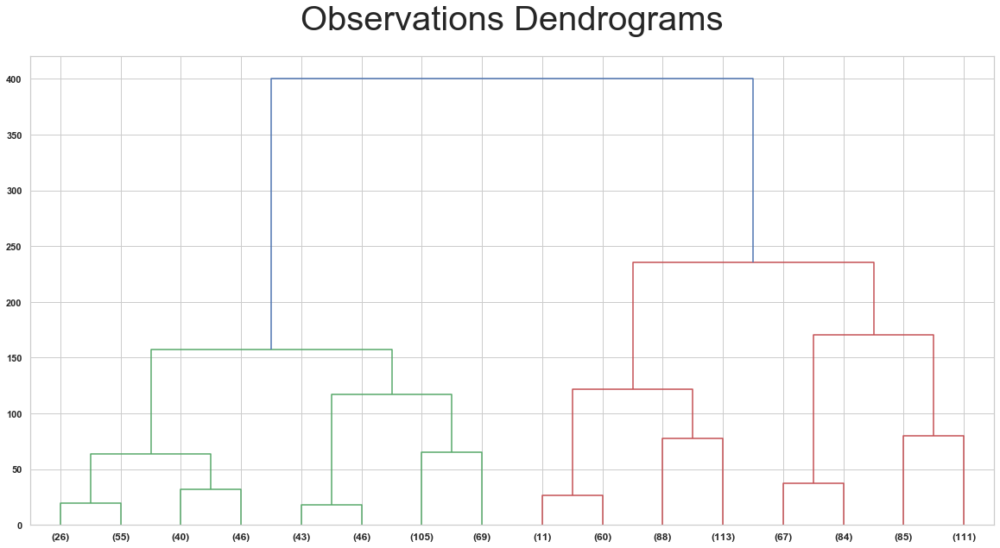

In [329]:
plt.figure(figsize=(20, 10))
plt.title("Observations Dendrograms", fontsize=40, pad=30)
dend = shc.dendrogram(shc.linkage(data_clustering, method='ward'),
                      truncate_mode="level", p=3)

Le dendrogramme est compatible avec un nombre de clusters de 7.

>**Score moyen de silhouette**

In [330]:
Sum_of_squared_distances = []
Average_silhouette_scores = []


K = range(2, 11)

for k in K:
    km = KMeans(n_clusters=k)
    km = km.fit(data_clustering)

    #Sum_of_squared_distances.append(km.inertia_)

    Average_silhouette_scores.append(silhouette_score(data_clustering,
                                                      km.labels_,
                                                      metric="euclidean"))

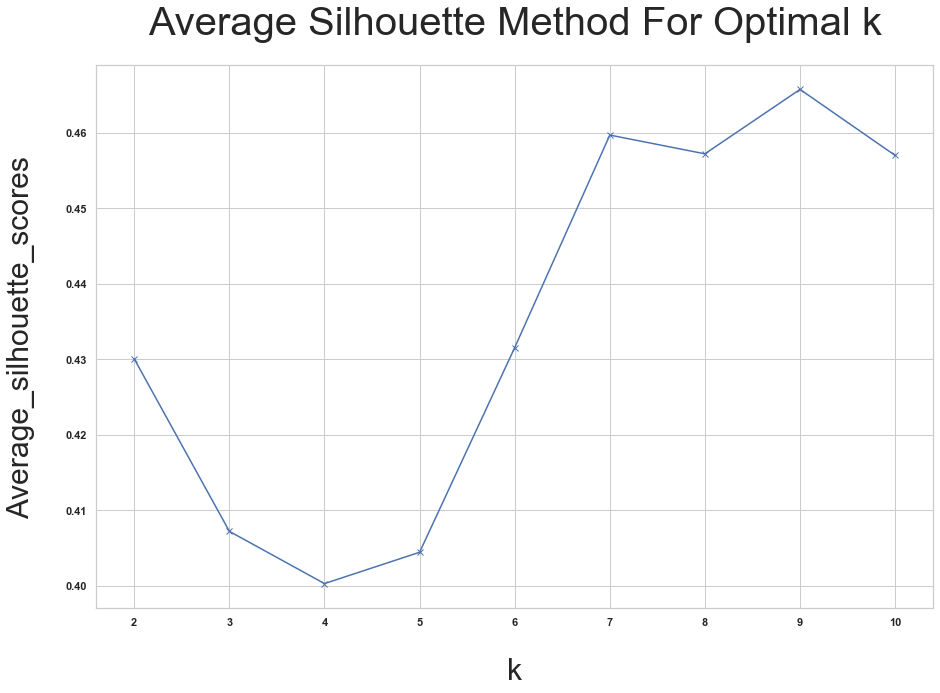

In [331]:
plt.figure(figsize=(15, 10))

plt.plot(K, Average_silhouette_scores, 'bx-')
plt.xlabel('k',
           fontsize=30,
           labelpad=30)
plt.ylabel('Average_silhouette_scores',
           fontsize=30,
           labelpad=30)
plt.title('Average Silhouette Method For Optimal k',
          fontsize=40, pad=30)
plt.show()

La méthode du coefficient moyen de silhouette donne des résultats compatibles avec un nombre de clusters de 7.

>**Coefficients de silhouette et Rand ajusté pour différents nombres de clusters**

In [332]:
algos = {"KMeans-k=7": KMeans(n_clusters=7),
         "KMeans-k=6": KMeans(n_clusters=6),
         "KMeans-k=5": KMeans(n_clusters=5),
         "KMeans-k=4": KMeans(n_clusters=4),
         "KMeans-k=3": KMeans(n_clusters=3),
         "KMeans-k=2": KMeans(n_clusters=2)}

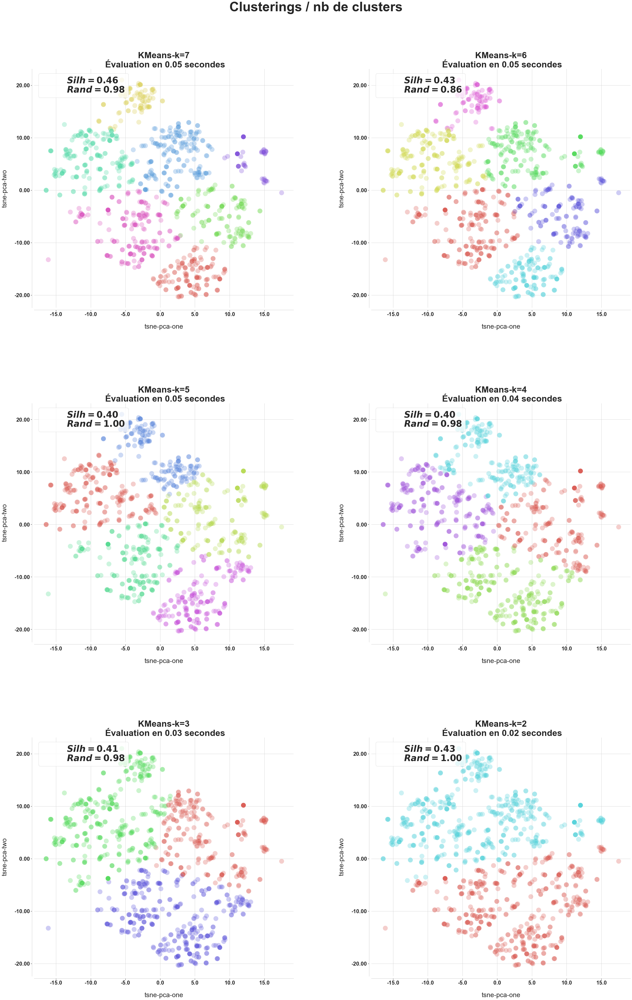

In [333]:
scores = hf.fit_plot(algos, data_clustering, 60, 40, "Clusterings / nb de clusters")

In [334]:
scores.sort_values(["silhouette", "Rand", "Time"], ascending=False)

,Algorithme,iter,silhouette,Rand,Nb Clusters,Time
0,KMeans-k=7,0,0.460291,0.975663,7,0.054338
1,KMeans-k=7,1,0.459679,0.981401,7,0.054338
2,KMeans-k=7,2,0.459045,0.988934,7,0.054338
3,KMeans-k=6,0,0.431756,0.796829,6,0.047196
5,KMeans-k=6,2,0.431528,0.994643,6,0.047196
15,KMeans-k=2,0,0.430035,1.000000,2,0.024946
16,KMeans-k=2,1,0.430035,1.000000,2,0.024946
17,KMeans-k=2,2,0.430035,1.000000,2,0.024946
4,KMeans-k=6,1,0.421522,0.794416,6,0.047196
13,KMeans-k=3,1,0.407306,0.965704,3,0.033353


Le clustering à 7 présente le meilleur score moyen de Silhouette sur l'ensemble des itérations.

La visualisation t-SNE, le dendrogramme ainsi que la méthode du coefficient moyen de silhouette sont compatibles avec un nombre de clusters égal à 7.



Tout ceci laisse à penser qu'un modèle utilisant les données texte pour sa classification pourra donner des résultats corrects.

In [335]:
N_CLUSTERS = 7

_<u>Choix des paramètres de l'algorithme</u>_

In [336]:
parameters = [{'n_clusters': [N_CLUSTERS],
               'n_init':[5, 10, 15, 20],
               'max_iter':[100, 300, 500],
               'tol':[0.0001, 0.0003, 0.0005],
               'random_state':[42]
               }]

clf = GridSearchCV(KMeans(), parameters)

clf.fit(data_clustering)

GridSearchCV(cv=None, error_score=nan,
             estimator=KMeans(algorithm='auto', copy_x=True, init='k-means++',
                              max_iter=300, n_clusters=8, n_init=10,
                              n_jobs=None, precompute_distances='auto',
                              random_state=None, tol=0.0001, verbose=0),
             iid='deprecated', n_jobs=None,
             param_grid=[{'max_iter': [100, 300, 500], 'n_clusters': [7],
                          'n_init': [5, 10, 15, 20], 'random_state': [42],
                          'tol': [0.0001, 0.0003, 0.0005]}],
             pre_dispatch='2*n_jobs', refit=True, return_train_score=False,
             scoring=None, verbose=0)

In [337]:
default_model = KMeans(n_clusters=N_CLUSTERS, random_state=42)
CV_optimized_model = KMeans(n_clusters=N_CLUSTERS, 
                            n_init=clf.best_params_["n_init"],
                            max_iter=clf.best_params_["max_iter"],
                            tol=clf.best_params_["tol"],
                            random_state=42)

In [338]:
algos = {"KMeans": default_model,
         "KMeans-CV": CV_optimized_model}

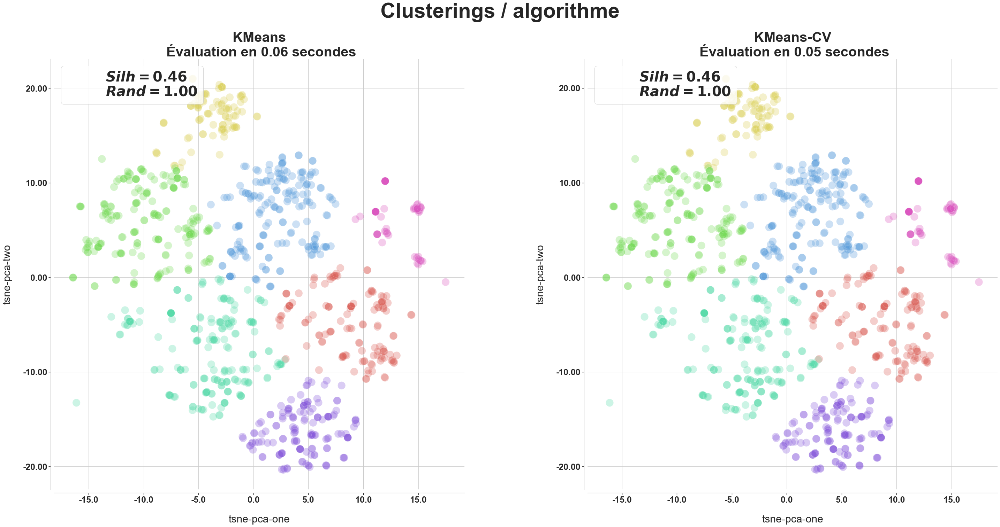

In [339]:
scores = hf.fit_plot(algos, data_clustering, 20, 40, "Clusterings / algorithme")

In [340]:
scores.sort_values(["silhouette", "Rand", "Time"])

,Algorithme,iter,silhouette,Rand,Nb Clusters,Time
3,KMeans-CV,0,0.459045,1.0,7,0.053243
4,KMeans-CV,1,0.459045,1.0,7,0.053243
5,KMeans-CV,2,0.459045,1.0,7,0.053243
0,KMeans,0,0.459045,1.0,7,0.057242
1,KMeans,1,0.459045,1.0,7,0.057242
2,KMeans,2,0.459045,1.0,7,0.057242


Le modèle aux paramètres optimisés possède un temps de calcul moins long que celui avec les paramètres par défaut, pour les mêmes coefficients de silhouette et de Rand.

Nous allons donc conserver ces paramètres optimisés.

In [341]:
model = CV_optimized_model

###### 4.2.3.2 Exploitation du modèle

In [342]:
model.fit(data_clustering)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=100,
       n_clusters=7, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=42, tol=0.0005, verbose=0)

_<u>Détermination des centroïdes</u>_

In [343]:
data_clustering["cluster"] = model.labels_

In [344]:
centroids = model.cluster_centers_

In [345]:
data_centroids = pd.DataFrame(columns=["tsne-one-tf",
                                       "tsne-two-tf",
                                       "centroids_cluster"])

data_centroids.loc[len(data_centroids)] = [centroids[0][0],
                                           centroids[0][1], "0"]
data_centroids.loc[len(data_centroids)] = [centroids[1][0],
                                           centroids[1][1], "1"]
data_centroids.loc[len(data_centroids)] = [centroids[2][0],
                                           centroids[2][1], "2"]
data_centroids.loc[len(data_centroids)] = [centroids[3][0],
                                           centroids[3][1], "3"]
data_centroids.loc[len(data_centroids)] = [centroids[4][0],
                                           centroids[4][1], "4"]
data_centroids.loc[len(data_centroids)] = [centroids[5][0],
                                           centroids[5][1], "5"]
data_centroids.loc[len(data_centroids)] = [centroids[6][0],
                                           centroids[6][1], "6"]

Text(0, 0.5, 't-SNE 2')

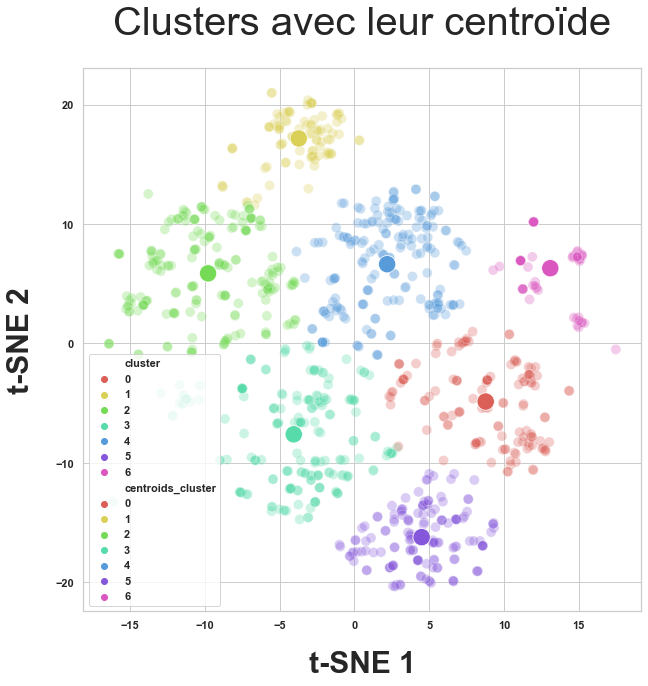

In [346]:
TITLE_SIZE = 40
TITLE_PAD = 1.05


plt.figure(figsize=(10, 10))

plt.title("Clusters avec leur centroïde",
          fontsize=TITLE_SIZE,
          y=TITLE_PAD)

handle_plot_1 = sns.scatterplot(x='tsne-one-tf', y='tsne-two-tf',
                                data=data_clustering, hue='cluster',
                                alpha=0.3,
                                palette=sns.color_palette("hls", N_CLUSTERS),
                                legend="full", s=100)

handle_plot_1.set_xlabel("t-SNE 1",
                         fontsize=LABEL_SIZE,
                         labelpad=LABEL_PAD,
                         fontweight="bold")

handle_plot_1.set_ylabel("t-SNE 2",
                         fontsize=LABEL_SIZE,
                         labelpad=LABEL_PAD,
                         fontweight="bold")


handle_plot_2 = sns.scatterplot(x='tsne-one-tf', y='tsne-two-tf',
                                data=data_centroids, hue='centroids_cluster',
                                palette=sns.color_palette("hls", N_CLUSTERS),
                                s=300, alpha=1)

handle_plot_2.set_xlabel("t-SNE 1",
                         fontsize=LABEL_SIZE,
                         labelpad=LABEL_PAD,
                         fontweight="bold")

handle_plot_2.set_ylabel("t-SNE 2",
                         fontsize=LABEL_SIZE,
                         labelpad=LABEL_PAD,
                         fontweight="bold")

In [347]:
index_products_cluster = {}

for cluster in range(N_CLUSTERS):
    index_products_cluster[cluster] = data_clustering[data_clustering["cluster"]==cluster].index


exact_df = pd.DataFrame(columns=["category", 
                                 "% cluster 0", "% cluster 1",
                                 "% cluster 2", "% cluster 3",
                                 "% cluster 4", "% cluster 5",
                                 "% cluster 6", "Assigned Cluster",])

for cat, data_df in products.groupby("category"):
    
    products_cluster = {}
    
    for cluster in range(N_CLUSTERS):
        
        valid_indexes = [indx for indx in index_products_cluster[cluster] if indx in data_df.index]
                
        products_cluster[cluster] = (len(data_df.loc[valid_indexes, :])*100)\
                                    /\
                                    len(data_df)
        
    assigned_cluster = max(products_cluster.items(), key=operator.itemgetter(1))[0]
        
    row = [cat, 
           products_cluster[0], 
           products_cluster[1],
           products_cluster[2],
           products_cluster[3],
           products_cluster[4],
           products_cluster[5],
           products_cluster[6],
           assigned_cluster
          ]
        
    exact_df.loc[len(exact_df)] = row
    
exact_df = exact_df.sort_values(by="Assigned Cluster").set_index("Assigned Cluster")

exact_df

,category,% cluster 0,% cluster 1,% cluster 2,% cluster 3,% cluster 4,% cluster 5,% cluster 6
Assigned Cluster,,,,,,,,
0,Computers,62.666667,0.000000,0.000000,36.666667,0.000000,0.000000,0.666667
1,Baby Care,4.000000,62.000000,20.666667,2.666667,8.000000,0.000000,2.666667
2,Home Furnishing,0.000000,0.666667,99.333333,0.000000,0.000000,0.000000,0.000000
3,Beauty and Personal Care,12.000000,1.333333,6.666667,68.666667,4.666667,0.666667,6.000000
4,Home Decor & Festive Needs,1.342282,0.000000,6.711409,8.724832,81.879195,0.671141,0.671141
5,Watches,1.333333,0.000000,0.000000,0.000000,0.000000,98.666667,0.000000
6,Kitchen & Dining,10.666667,0.000000,0.000000,21.333333,30.666667,0.000000,37.333333


In [348]:
accuracy = 0 

for i in range(7):
    accuracy += exact_df.loc[i, "% cluster "+str(i)]
    
accuracy = accuracy/7

print("The overall accuracy of the clustering is ", accuracy)

The overall accuracy of the clustering is  72.9351230425056


In [349]:
data_to_plot = pd.concat([products, data_clustering], axis=1)

In [351]:
color_list = sns.color_palette("hls", N_CLUSTERS)

palette = {"Home Furnishing": color_list[2],
           "Computers": color_list[0],
           "Baby Care": color_list[1],
           "Beauty and Personal Care": color_list[3],
           "Watches": color_list[5],
           "Kitchen & Dining": color_list[6],
           "Home Decor & Festive Needs": color_list[4],
           0: color_list[0],
           1: color_list[1],
           2: color_list[2],
           3: color_list[3],
           4: color_list[4],
           5: color_list[5],
           6: color_list[6],
           '0': color_list[0],
           '1': color_list[1],
           '2': color_list[2],
           '3': color_list[3],
           '4': color_list[4],
           '5': color_list[5],
           '6': color_list[6]
          }



Text(0, 0.5, 't-SNE 2')

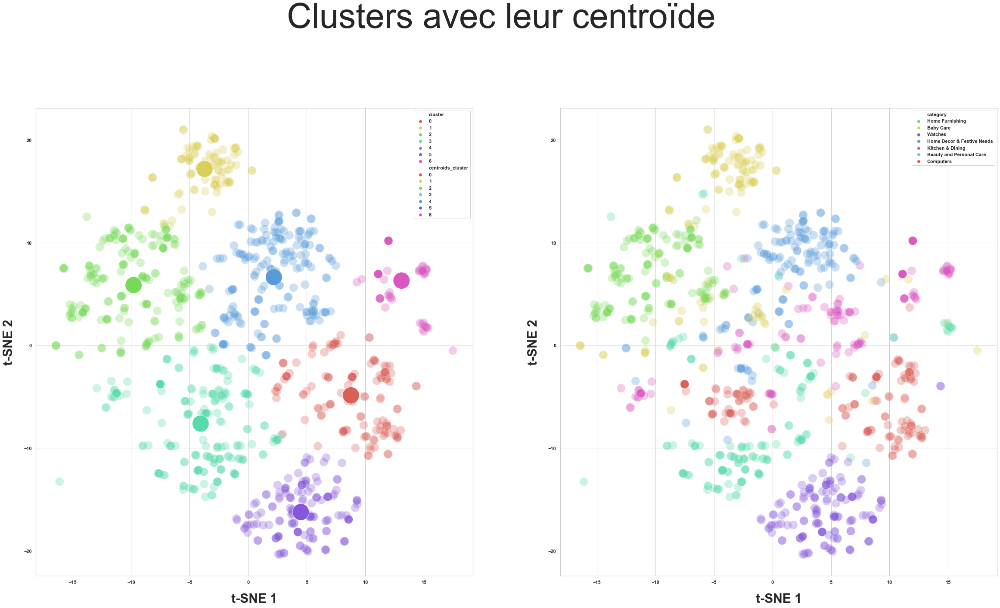

In [352]:
TITLE_SIZE = 80
TITLE_PAD = 1.05
LABEL_SIZE = 30
LABEL_PAD = 20

fig, axes = plt.subplots(1, 2, figsize=(40, 20))

fig.suptitle("Clusters avec leur centroïde",
             fontsize=TITLE_SIZE, 
             y=TITLE_PAD)

ax1 = axes[0]
handle_plot_1 = sns.scatterplot(x='tsne-one-tf', y='tsne-two-tf',
                                data=data_clustering, hue='cluster',
                                alpha=0.3,
                                palette=palette,
                                legend="full", s=400, ax=ax1)

handle_plot_1.set_xlabel("t-SNE 1",
                         fontsize=LABEL_SIZE,
                         labelpad=LABEL_PAD,
                         fontweight="bold")

handle_plot_1.set_ylabel("t-SNE 2",
                         fontsize=LABEL_SIZE,
                         labelpad=LABEL_PAD,
                         fontweight="bold")


handle_plot_2 = sns.scatterplot(x='tsne-one-tf', y='tsne-two-tf',
                                data=data_centroids, hue='centroids_cluster',
                                palette=palette,
                                s=1500, alpha=1, ax=ax1)

handle_plot_2.set_xlabel("t-SNE 1",
                         fontsize=LABEL_SIZE,
                         labelpad=LABEL_PAD,
                         fontweight="bold")

handle_plot_2.set_ylabel("t-SNE 2",
                         fontsize=LABEL_SIZE,
                         labelpad=LABEL_PAD,
                         fontweight="bold")

ax2 = axes[1]



handle_plot_3 = sns.scatterplot(x='tsne-one-tf', y='tsne-two-tf',
                                data=data_to_plot, hue='category',
                                alpha=0.3,
                                palette=palette,
                                legend="full", s=400, ax=ax2)

handle_plot_3.set_xlabel("t-SNE 1",
                        fontsize=LABEL_SIZE,
                        labelpad=LABEL_PAD,
                         fontweight="bold")

handle_plot_3.set_ylabel("t-SNE 2",
                         fontsize=LABEL_SIZE,
                         labelpad=LABEL_PAD,
                         fontweight="bold")

##### _<u>4.2.4 Tests de prédiction</u>_

###### 4.2.4.1 Sur le jeu de données

On va utiliser l'algorithme Multinomial Naive Bayes (MNB).

In [353]:
X_train, X_test, y_train, y_test = train_test_split(text_tf, 
                                                    products['category'], 
                                                    test_size=0.3, 
                                                    random_state=123)

In [354]:
# Model Generation Using Multinomial Naive Bayes
clf = MultinomialNB().fit(X_train, y_train)
predicted = clf.predict(X_test)

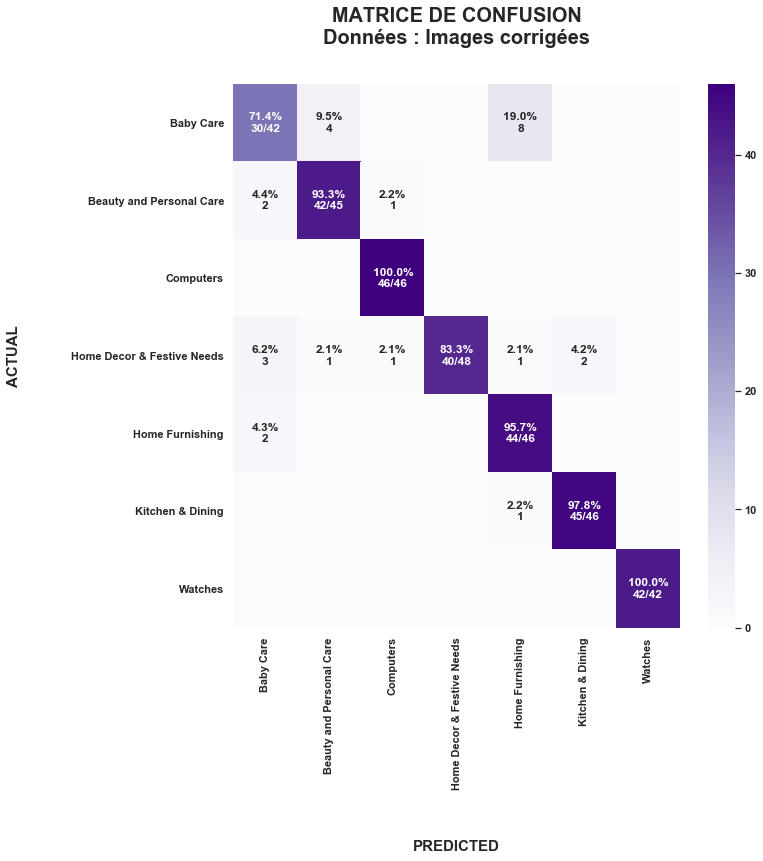

In [355]:
gf.plot_cm(y_test, predicted, "Texte")

In [356]:
print("MultinomialNB Accuracy:", accuracy_score(y_test, predicted))

MultinomialNB Accuracy: 0.9174603174603174


L'algorithme supervisé donne une accuracy de 92%, ce qui est bien meilleur que celle obtenue en utilisant les données image.

###### 4.2.4.2 Sur un produit hors du jeu de données

In [357]:
# 1. Get product features
product_name = "Gaming Keyboard, \
                WisFox Colorful Rainbow LED Backlit Wired \
                Computer Gaming Keyboard with 104 Keys, \
                USB Wired Keyboard and Spill-Resistant for Windows PC Gamers Desktop PS4"

description = "▶[COLORFUL RAINBOW LED BACKLIGHT GAMING KEYBOARD] : Mixed Colorful rainbow LED backlight, \
              each keycap is brightly colored.Adjustable breathing speed and breathing mode illuminated \
              keyboard provide crystal clear and uniform backlight. The letters never fade, which can bring\
              the ultimate typing experience."

product_specifications = '{"product_specification"=>[{"key"=>"Package Dimensions",\
                                                      "value"=>"17.6 x 7.3 x 1.4 inches"},\
                          {"key"=>"Item Weight", "value"=>"2.1 pounds"},\
                          {"key"=>"Manufacturer", "value"=>"WISFOX"}]}'

On fit le modèle sur l'ensemble des données :

In [358]:
clf = MultinomialNB().fit(text_tf, products.category)

In [359]:
doc_topic = hf.predictWithText(product_name, 
                               description, 
                               product_specifications,
                               tf,
                               "MNB",
                               clf)

In [360]:
proba_predicted = pd.DataFrame(columns=np.sort(products.category.unique()),
                              data=doc_topic[1]*100)

In [361]:
proba_predicted

,Baby Care,Beauty and Personal Care,Computers,Home Decor & Festive Needs,Home Furnishing,Kitchen & Dining,Watches
0,8.617477,8.007719,33.717982,12.560564,10.780766,15.166979,11.148513


In [362]:
doc_topic[0]

array(['Computers'], dtype='<U26')

##### _<u>4.2.5 Conclusions</u>_

Les données texte (nom, description et spécifications produit) permettent d'obtenir un modèle avec une accuracy de 92%. 

C'est bien meilleur que l'accuracy de 27% obtenue avec le modèle basé sur les images.

___
### 5. Conclusion

- Les images permettent d'obtenir un modèle avec une accuracy de 27%. 
Sur l'image d'un produit hors du jeu de données, le modèle parvient à prédire sa catégorie avec une probabilité de 60% et un delta de probabilité avec la catégorie la plus proche de 40%.
- Les données texte (nom, description et spécifications produit) permettent d'obtenir un modèle avec une accuracy de 92%. 
Sur les données texte d'un produit hors du jeu de données, le modèle parvient à prédire sa catégorie avec une probabilité de 34% et un delta de probabilité avec la catégorie la plus proche de 18%.

> **Il est possible d'obtenir une classification produit automatique à partir des données texte combinées (nom, description, spécifications) avec une accuracy de 92%.**

___
### 6. Annexe

#### 6.1 EXPLORATION DES TOPICS

On va tester 2 approches non supervisées, afin de voir si les topics abordés dans les documents permettraient de classifier un produit : 
- Latent Dirichlet Allocation (LDA)
- Negative Matrix Factorization (NMF)

##### _<u>6.1.1 Latent Dirichlet Allocation (LDA)</u>_

In [296]:
n_topics = 7
n_top_words = 10

# Créer le modèle LDA
lda = LatentDirichletAllocation(n_components=n_topics, 
                                max_iter=5, 
                                learning_method='online', 
                                learning_offset=50,
                                random_state=0)

###### 6.1.1.1 Données Bag of Words

In [297]:
# Fitter sur les données
lda.fit(text_bow)

LatentDirichletAllocation(batch_size=128, doc_topic_prior=None,
                          evaluate_every=-1, learning_decay=0.7,
                          learning_method='online', learning_offset=50,
                          max_doc_update_iter=100, max_iter=5,
                          mean_change_tol=0.001, n_components=7, n_jobs=None,
                          perp_tol=0.1, random_state=0, topic_word_prior=None,
                          total_samples=1000000.0, verbose=0)

In [298]:
print("Catégories in LDA model:")
bow_feature_names = count_vect.get_feature_names()

hf.print_top_words(lda, bow_feature_names, n_top_words)

Catégories in LDA model:
Catégorie #0:
cm replacement warranty showpiece products rs delivery free shipping cash
Catégorie #1:
cm s pack cotton baby inch skin print laptop set
Catégorie #2:
watch analog com rs genuine cash shipping delivery free products
Catégorie #3:
e gown sstudio surgical pant s hospital polyvinyl pigmented films
Catégorie #4:
eyelet aroma polyester door curtain design window bottle curtainkey nutcase
Catégorie #5:
usb led hair light type flexible plastic table ml portable
Catégorie #6:
coffee mugs mug perfect quality ceramic bring pizza ml kitchen



Analysons les proportions de produits des différentes catégories connues pour chaque topic, afin de voir s'il est possible de faire des couples (catégorie, topic) uniques.

In [366]:
hf.get_categories_per_topic(n_topics, 
                            lda, 
                            text_bow, 
                            products)

,% Home Furnishing,% Baby Care,% Watches,% Home Decor & Festive Needs,% Kitchen & Dining,% Beauty and Personal Care,% Computers
Topic,,,,,,,
0.0,0.384615,4.230769,0.000000,40.000000,13.076923,5.769231,36.538462
1.0,43.959732,40.604027,0.335570,7.382550,0.671141,3.020134,4.026846
2.0,0.664452,2.990033,48.837209,0.996678,17.940199,27.574751,0.996678
3.0,0.000000,16.666667,8.333333,25.000000,8.333333,25.000000,16.666667
4.0,42.857143,0.000000,0.000000,5.714286,28.571429,22.857143,0.000000
5.0,1.176471,5.882353,0.000000,12.941176,12.941176,23.529412,43.529412
6.0,0.000000,3.448276,1.724138,6.896552,65.517241,20.689655,1.724138


Ici, on voit quelles sont les catégories les plus représentées par topic:
- topic #0 : Home Decor & Festive Needs (40%) et Computers (37%)
- topic #1 : Home Furnishiong (44%) and Baby Care (41%)
- topic #2 : Watches (49%) 
- topic #3 : Home Decor & Festive Needs (25%) and Beauty and Personal Care (25%)
- topic #4 : Home Furnishing (43%)
- topic #5 : Computers (44%)
- topic #6 : Kitchen & Dining (66%)

> **4 topics sur 7 sont associés à une unique catégorie.**

> **Parmi ces catégories, on en compte 4 uniques sur 7.**

4 topic sur 7 sont associés à une unique catégorie.

###### 6.1.1.2 Données TF-IDF

In [265]:
# Fitter sur les données
lda.fit(text_tf)

LatentDirichletAllocation(batch_size=128, doc_topic_prior=None,
                          evaluate_every=-1, learning_decay=0.7,
                          learning_method='online', learning_offset=50,
                          max_doc_update_iter=100, max_iter=5,
                          mean_change_tol=0.001, n_components=7, n_jobs=None,
                          perp_tol=0.1, random_state=0, topic_word_prior=None,
                          total_samples=1000000.0, verbose=0)

In [266]:
print("Catégories in LDA model:")
tf_feature_names = tf.get_feature_names()

hf.print_top_words(lda, tf_feature_names, n_top_words)

Catégories in LDA model:
Catégorie #0:
showpiece cm brass wooden eyes n wireless singing omrd led
Catégorie #1:
ar edimax wna idli wnabuy belts lcd plate vatika star
Catégorie #2:
cm watch analog com combo laptop free delivery replacement products
Catégorie #3:
baby s girl cotton boy towel bath details neck fabric
Catégorie #4:
mugs bring coffee perfect mug says freedom laughs express sipping
Catégorie #5:
bluetooth aloe palm maple arecaceae maguey mayursflora version ipad itag
Catégorie #6:
pencil lip roll industries giorgio soyeux earing armani kuber bangle



Analysons les proportions de produits des différentes catégories connues pour chaque topic, afin de voir s'il est possible de faire des couples (catégorie, topic) uniques.

In [367]:
hf.get_categories_per_topic(n_topics, 
                            lda, 
                            text_tf, 
                            products)

,% Home Furnishing,% Baby Care,% Watches,% Home Decor & Festive Needs,% Kitchen & Dining,% Beauty and Personal Care,% Computers
Topic,,,,,,,
0.0,0.373134,2.611940,0.000000,38.059701,11.194030,12.313433,35.447761
1.0,43.252595,42.560554,0.000000,6.920415,0.692042,2.422145,4.152249
2.0,0.355872,3.558719,52.669039,1.067616,19.217082,22.419929,0.711744
3.0,0.000000,15.384615,7.692308,23.076923,7.692308,23.076923,23.076923
4.0,47.500000,0.000000,0.000000,5.000000,25.000000,22.500000,0.000000
5.0,4.166667,5.208333,0.000000,15.625000,15.625000,20.833333,38.541667
6.0,0.000000,4.838710,1.612903,6.451613,61.290323,24.193548,1.612903


Ici, on voit quelles sont les catégories les plus représentées par topic:
- topic #0 : Home Decor & Festive Needs (38%) et Computers (35%)
- topic #1 : Home Furnishing (43%) et Baby Care (43%)
- topic #2 : Watches (53%)
- topic #3 : Home Decor & Festive Needs (23%), Beauty and Personal care (23%), Computers (23%)
- topic #4 : Home Furnishing (48%)
- topic #5 : Computers (39%)
- topic #6 : Kitchen & Dining (61%)

> **4 topics sur 7 sont associés à une unique catégorie.**

> **Parmi ces catégories, on en compte 4 uniques sur 7.**

5 topic sur 7 sont associés à une unique catégorie.

##### _<u>6.1.2 Negative Matrix Factorization (NMF)</u>_

In [293]:
n_topics = 7
n_top_words = 10

nmf = NMF(n_components=no_topics, random_state=1, alpha=.1, l1_ratio=.5, init='nndsvd')

###### 6.1.2.1 Données Bag of Words

In [369]:
bow_feature_names = count_vect.get_feature_names()

nmf.fit(text_bow)

hf.print_top_words(nmf, bow_feature_names, no_top_words)

Catégorie #0:
cm inch cotton showpiece cover bedsheet yes pack double width
Catégorie #1:
warranty adapter v replacement vaio vgn cr e smartpro product
Catégorie #2:
baby s girl cotton details fabric boy pack dress neck
Catégorie #3:
watch products analog free delivery cash genuine shipping rs day
Catégorie #4:
mug ceramic coffee mugs perfect ml mm gift material tea
Catégorie #5:
laptop skin print shapes pad mouse warranty combo set multicolor
Catégorie #6:
product color warranty bed king quality check s fit mm



Analysons les proportions de produits des différentes catégories connues pour chaque topic, afin de voir s'il est possible de faire des couples (catégorie, topic) uniques.

In [370]:
hf.get_categories_per_topic(n_topics, 
                            nmf, 
                            text_bow,
                            products)

,% Home Furnishing,% Baby Care,% Watches,% Home Decor & Festive Needs,% Kitchen & Dining,% Beauty and Personal Care,% Computers
Topic,,,,,,,
0.0,39.382239,7.335907,0.000000,44.787645,4.247104,2.702703,1.544402
1.0,0.000000,0.000000,0.000000,0.000000,4.166667,8.333333,87.500000
2.0,11.206897,82.758621,0.000000,0.862069,1.724138,2.586207,0.862069
3.0,6.919643,5.803571,33.035714,3.571429,8.258929,23.660714,18.750000
4.0,0.000000,3.125000,0.000000,6.250000,85.416667,5.208333,0.000000
5.0,5.660377,5.660377,0.000000,0.000000,13.207547,35.849057,39.622642
6.0,1.886792,5.660377,3.773585,18.867925,18.867925,15.094340,35.849057


On obtient les correspondances suivantes :
- topic 0 : Home Decor & Festive Needs (45%)
- topic 1 : Computers (88%)
- topic 2 : Baby Care (83%)
- topic 3 : Watches (33%) and Beauty and Personal Care (24%)
- topic 4 : Kitchen & Dining (85%)
- topic 5 : Beauty and Personal Care (36%) and Computers (405)
- topic 6 : Computers (35%)

> **5 topics sur 7 sont associés à une unique catégorie.**

> **Parmi ces catégories, on en compte 4 uniques sur 7.**

###### 6.1.2.2 Données TF-IDF

In [273]:
tf_feature_names = tf.get_feature_names()

nmf.fit(text_tf)

hf.print_top_words(nmf, tf_feature_names, no_top_words)

Catégorie #0:
watch analog men discounts india great women buy n com
Catégorie #1:
baby s girl boy cotton details dress neck fabric sleeve
Catégorie #2:
rockmantra mug crafting stays porcelain ceramicsize thrilling permanent ensuring creation
Catégorie #3:
cm blanket double inch single abstract cotton showpiece yes comforters
Catégorie #4:
combo com set setflipkart buy flipkart online guarantee replacement day
Catégorie #5:
mug coffee ceramic mugs tea perfect printland prithish presented wardrobe
Catégorie #6:
laptop warranty dv battery product hp pavilion cell lapguard customer



Analysons les proportions de produits des différentes catégories connues pour chaque topic, afin de voir s'il est possible de faire des couples (catégorie, topic) uniques.

In [370]:
hf.get_categories_per_topic(n_topics, 
                            nmf, 
                            text_bow,
                            products)

,% Home Furnishing,% Baby Care,% Watches,% Home Decor & Festive Needs,% Kitchen & Dining,% Beauty and Personal Care,% Computers
Topic,,,,,,,
0.0,39.382239,7.335907,0.000000,44.787645,4.247104,2.702703,1.544402
1.0,0.000000,0.000000,0.000000,0.000000,4.166667,8.333333,87.500000
2.0,11.206897,82.758621,0.000000,0.862069,1.724138,2.586207,0.862069
3.0,6.919643,5.803571,33.035714,3.571429,8.258929,23.660714,18.750000
4.0,0.000000,3.125000,0.000000,6.250000,85.416667,5.208333,0.000000
5.0,5.660377,5.660377,0.000000,0.000000,13.207547,35.849057,39.622642
6.0,1.886792,5.660377,3.773585,18.867925,18.867925,15.094340,35.849057


On obtient les correspondances suivantes :
- topic 0 : Home Decor & Festive Needs (45%) et Home Furnishing (39%)
- topic 1 : Computers (88%)
- topic 2 : Baby Care (83%)
- topic 3 : Watches (33%)
- topic 4 : Kitchen & Dining (85%)
- topic 5 : Computers (40%) et Beauty and Personal Care (36%)
- topic 6 : Computers (36%)

> **5 topics sur 7 sont associés à une unique catégorie.**

> **Parmi ces catégories, on en compte 4 uniques sur 7.**